In [11]:
import csv
import numpy as np
from sacrebleu import BLEU
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt
import pandas as pd
from IPython import display
from tqdm.notebook import tqdm
import transformers, torch
import deepl
from transformers import AutoModelForMaskedLM,AutoTokenizer

In [4]:
MODELS = ['text-only', 'bert', 'lxmert', 'all-inclusive']
BLEU_SCORER = BLEU(effective_order=True)

In [5]:
def figure(nrows, ncols, scale=1.0):
    fig = plt.figure(figsize=(6.4*ncols*scale, 4.8*nrows*scale))
    return fig

# Helpers

In [9]:
API_KEY="532531d4-fa04-7ad6-a5bd-ca97d1041a89:fx"
DEEPL_TRANSLATOR = deepl.Translator(API_KEY)

In [10]:
def translate_by_deepl(texts, deepl_model=DEEPL_TRANSLATOR, source_lang='de', target_lang='en-us'):
    return deepl_model.translate_text(texts, source_lang=source_lang, target_lang=target_lang)

In [12]:
def ppl_score(sentence, model, tokenizer):
    tensor_input = tokenizer.encode(sentence, return_tensors='pt').to(model.device)
    repeat_input = tensor_input.repeat(tensor_input.size(-1)-2, 1)
    mask = torch.ones(tensor_input.size(-1) - 1).diag(1)[:-2].to(model.device)
    masked_input = repeat_input.masked_fill(mask == 1, tokenizer.mask_token_id)
    labels = repeat_input.masked_fill( masked_input != tokenizer.mask_token_id, -100)
    loss, _ = model(masked_input, labels=labels)
    return np.exp(loss.item())

In [13]:
bert_model_name = 'bert-base-uncased'
bert_model = AutoModelForMaskedLM.from_pretrained(bert_model_name)
bert_tokenizer = AutoTokenizer.from_pretrained(bert_model_name)

bert_model.eval()
_ = bert_model.cuda()

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [14]:
# https://huggingface.co/bert-base-multilingual-uncased
mbert_model_name = 'bert-base-multilingual-uncased'
mbert_model = AutoModelForMaskedLM.from_pretrained(mbert_model_name)
mbert_tokenizer = AutoTokenizer.from_pretrained(mbert_model_name)

mbert_model.eval()
_ = mbert_model.cuda()

Some weights of the model checkpoint at bert-base-multilingual-uncased were not used when initializing BertForMaskedLM: ['cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


# Data preparation

## Load saved data

In [6]:
df = pd.read_pickle('./data_for_analysis.pkl')

In [7]:
df.columns

Index(['src', 'ref', 'hyp_text-only', 'hyp_bert', 'hyp_lxmert',
       'hyp_all-inclusive', 'rank_text-only', 'rank_bert', 'rank_lxmert',
       'rank_all-inclusive', 'bleu_text-only', 'bleu1_text-only',
       'bleu2_text-only', 'bleu3_text-only', 'bleu4_text-only',
       'bleu-bp_text-only', 'bleu_bert', 'bleu1_bert', 'bleu2_bert',
       'bleu3_bert', 'bleu4_bert', 'bleu-bp_bert', 'bleu_lxmert',
       'bleu1_lxmert', 'bleu2_lxmert', 'bleu3_lxmert', 'bleu4_lxmert',
       'bleu-bp_lxmert', 'bleu_all-inclusive', 'bleu1_all-inclusive',
       'bleu2_all-inclusive', 'bleu3_all-inclusive', 'bleu4_all-inclusive',
       'bleu-bp_all-inclusive', 'ppl_ref', 'ppl_text-only', 'ppl_bert',
       'ppl_lxmert', 'ppl_all-inclusive', 'image_url', 'hyp-en_bert',
       'hyp-en_lxmert', 'hyp-en_all-inclusive', 'reversal_text-only_to_bert',
       'reversal_text-only_to_lxmert', 'reversal_text-only_to_all-inclusive',
       'reversal_bert_to_text-only', 'reversal_bert_to_lxmert',
       'reversal_b

## Create new data

In [146]:
df = pd.DataFrame()

### Source, reference, and hypothesis

In [147]:
src_name='./tok/test_2016_flickr.lc.norm.tok.en'
ref_name='./tok/test_2016_flickr.lc.norm.tok.de'

df['src'] = [l.strip() for l in open(src_name)]
df['ref'] = [l.strip() for l in open(ref_name)]

In [148]:
for m in models:
    df[f'hyp_{m}'] = [l.strip() for l in open(f'./tok/test_2016_flickr.lc.norm.tok.{m}.de')]

### English Translation of hypothesis using DeepL

In [172]:
target_models = ['bert', 'lxmert', 'all-inclusive']
for index, row in tqdm(df.iterrows(), total=len(df)):
    hyps = [row[f'hyp_{m}'] for m in target_models]
    results = deepl(hyps, target_lang='en-us')
    for m, result in zip(target_models, results):
        df.loc[index, f'hyp-en_{m}'] = result.text

  0%|          | 0/1000 [00:00<?, ?it/s]

### Image URL

In [204]:
df['image_url'] = [f'https://cl.sd.tmu.ac.jp/~tosho/img/m30k/t16f/{i.strip()}' for i in open('./image-split/test_2016_flickr.txt')]

### Length

In [542]:
df['src-len'] = [len(l.split()) for l in df['src']]

In [545]:
df['ref-len'] = [len(l.split()) for l in df['ref']]

In [546]:
for m in MODELS:
    df[f'hyp-len_{m}'] = [len(l.split()) for l in df[f'hyp_{m}']]

### Rank and BLEU

In [151]:
ranks = [[] for _ in models]
for i, row in enumerate(csv.reader(open('./human_eval_results.csv'))):
    if i == 0:
        continue
    for j, c in enumerate(row):
        ranks[j].append(c)
for m, rank in zip(models, ranks):
    df[f'rank_{m}'] = rank

In [158]:
bleus = [[] for _ in models]
n_bleus = [[[] for __ in range(1,5)] for _ in models]
bleu_bps = [[] for _ in models]

for index, row in df.iterrows():
    ref = row['ref']
    for i, m in enumerate(models):
        hyp = row[f'hyp_{m}']
        score = bleu_scorer.sentence_score(hyp, [ref])
        bleus[i].append(score.score)
        for n in range(4):
            n_bleus[i][n].append(score.precisions[n])
        bleu_bps[i].append(score.bp)
        
for m, bleu, n_bleu, bleu_bp in zip(models, bleus, n_bleus, bleu_bps):
    df[f'bleu_{m}'] = bleu
    for i, prec in zip(range(4), n_bleu):
        n = i + 1
        df[f'bleu{n}_{m}'] = prec
    df[f'bleu-bp_{m}'] = bleu_bp

### Perplexity

In [264]:
src_ppl = [ppl_score(src, model=bert_model, tokenizer=bert_tokenizer) for src in tqdm(df['src'])]
df['ppl_src'] = src_ppl

  0%|          | 0/1000 [00:00<?, ?it/s]

#### hypothesis (using multilingual BERT)

In [192]:
for m in models:
    hyps = df[f'hyp_{m}']
    ppls = [ppl_score(hyp, model=mbert_model, tokenizer=mbert_tokenizer) for hyp in tqdm(hyps)]
    df[f'ppl_{m}'] = ppls

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

### Reversal samples

In [508]:
for m1 in models:
    for m2 in models:
        if m1 == m2:
            continue
        
        reverted = (df[f'bleu_{m1}'] > df[f'bleu_{m2}']) & (df[f'rank_{m1}'] > df[f'rank_{m2}'])
        df[f'reversal_{m1}_to_{m2}'] = reverted

### POS
STTS POS tag: https://www.sketchengine.eu/german-stts-part-of-speech-tagset/

In [527]:
def load_pos(fname):
    pos_list = []
    current_pos = []
    for a_pos in open(fname):
        a_pos = a_pos.strip()
        if len(a_pos) == 0:
            pos_list.append(current_pos)
            current_pos = []
        else:
            current_pos.append(a_pos)
    return pos_list

In [537]:
for m in MODELS:
    df[f'hyp-pos_{m}'] = load_pos(f'./pos/test_2016_flickr.lc.norm.tok.{m}.de')

In [538]:
for m in MODELS:
    df[f'hyp-stts-pos_{m}'] = load_pos(f'./stts-pos/test_2016_flickr.lc.norm.tok.{m}.de')

### Save data

In [265]:
df.columns

Index(['src', 'ref', 'hyp_text-only', 'hyp_bert', 'hyp_lxmert',
       'hyp_all-inclusive', 'rank_text-only', 'rank_bert', 'rank_lxmert',
       'rank_all-inclusive', 'bleu_text-only', 'bleu1_text-only',
       'bleu2_text-only', 'bleu3_text-only', 'bleu4_text-only',
       'bleu-bp_text-only', 'bleu_bert', 'bleu1_bert', 'bleu2_bert',
       'bleu3_bert', 'bleu4_bert', 'bleu-bp_bert', 'bleu_lxmert',
       'bleu1_lxmert', 'bleu2_lxmert', 'bleu3_lxmert', 'bleu4_lxmert',
       'bleu-bp_lxmert', 'bleu_all-inclusive', 'bleu1_all-inclusive',
       'bleu2_all-inclusive', 'bleu3_all-inclusive', 'bleu4_all-inclusive',
       'bleu-bp_all-inclusive', 'ppl_ref', 'ppl_text-only', 'ppl_bert',
       'ppl_lxmert', 'ppl_all-inclusive', 'image_url', 'hyp-en_bert',
       'hyp-en_lxmert', 'hyp-en_all-inclusive', 'reversal_text-only_to_bert',
       'reversal_text-only_to_lxmert', 'reversal_text-only_to_all-inclusive',
       'reversal_bert_to_text-only', 'reversal_bert_to_lxmert',
       'reversal_b

In [266]:
df.to_pickle('./data_for_analysis.pkl')

# Statistics

## Frequency

In [140]:
def get_tok_freq(data=[l.strip().split() for l in open('./tok/train.lc.norm.tok.de')]):
    types = list(set([tok for l in data for tok in l]))
    freqs = [sum([t in l for l in data]) for t in tqdm(types)]
    return types, freqs

In [141]:
freq_data = pd.DataFrame()
freq_data['type'], freq_data['freq'] = get_tok_freq()
freq_data = freq_data.set_index('type')

  0%|          | 0/18722 [00:00<?, ?it/s]

In [143]:
test_freq_data = pd.DataFrame()
test_freq_data['type'], test_freq_data['test_freq'] = get_tok_freq(data=[l.strip().split() for l in open('./tok/test_2016_flickr.lc.norm.tok.de')])
test_freq_data = test_freq_data.set_index('type')

  0%|          | 0/2125 [00:00<?, ?it/s]

In [145]:
merged_freq_data = freq_data.join(test_freq_data, how='outer')
len(merged_freq_data)

19034

In [146]:
merged_freq_data[merged_freq_data.isnull()] = 0

In [149]:
freq_data = merged_freq_data
del merged_freq_data

### Translation by DeepL

In [22]:
if 'type-en' not in freq_data.columns:
    freq_data['type-en'] = None

In [39]:
for idx, row in tqdm(freq_data.iterrows(), total=len(freq_data)):
    type_en = row['type-en']
    if type_en is None:
        type_en = translate_by_deepl(idx)
        freq_data.loc[idx, 'type-en'] = type_en

  0%|          | 0/19034 [00:00<?, ?it/s]

### save data

In [38]:
freq_data

,freq,val_freq,type-en
type,,,
!,17.0,0.0,!
#,4.0,1.0,#
%,2.0,0.0,%
&amp;,10.0,0.0,&amp;
&apos;,34.0,2.0,&apos;
...,...,...,...
üppig,2.0,0.0,lush
üppigem,1.0,0.0,lush
üppigen,2.0,0.0,lush


In [40]:
freq_data.to_pickle('./freq_data.pkl')

### load data

In [16]:
freq_data = pd.read_pickle('./freq_data.pkl')
len(freq_data)

19034

## F1 score

In [41]:
def get_f1_data(refs=[], hyps=[], suffix=""):
    refs = [t.split() for t in refs]
    hyps = [t.split() for t in hyps]
    types = list(set(sum(refs,[]) + sum(hyps,[])))
    
    type_trues = [[t in ref for ref in refs] for t in types]
    type_preds = [[t in hyp for hyp in hyps] for t in types]
    f1_scores = [f1_score(trues, preds) for trues,preds in tqdm(zip(type_trues, type_preds), total=len(types))]
    
    f1_data = pd.DataFrame()
    f1_data['type'] = types
    f1_data['f1-score'+suffix] = f1_scores
    f1_data['f1-trues'+suffix] = type_trues
    f1_data['f1-preds'+suffix] = type_preds
    
    return f1_data.set_index('type')

In [42]:
def get_type_f1_data(target_freq_data, target_df, target_models=MODELS):
    model_f1_data = target_freq_data.copy(deep=True)
    for m in target_models:
        f1_data = get_f1_data(target_df['ref'], target_df[f'hyp_{m}'], suffix=f'_{m}')
        model_f1_data = model_f1_data.join(f1_data, how='outer')
    
    model_f1_data.loc[~model_f1_data.notna()['freq'], 'freq'] = 0
    return model_f1_data

In [43]:
type_f1_data = get_type_f1_data(freq_data, df)

  0%|          | 0/2654 [00:00<?, ?it/s]

  0%|          | 0/2687 [00:00<?, ?it/s]

  0%|          | 0/2654 [00:00<?, ?it/s]

  0%|          | 0/2681 [00:00<?, ?it/s]

In [44]:
type_f1_data

,freq,val_freq,type-en,f1-score_text-only,f1-trues_text-only,f1-preds_text-only,f1-score_bert,f1-trues_bert,f1-preds_bert,f1-score_lxmert,f1-trues_lxmert,f1-preds_lxmert,f1-score_all-inclusive,f1-trues_all-inclusive,f1-preds_all-inclusive
type,,,,,,,,,,,,,,,
!,17.0,0.0,!,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
#,4.0,1.0,#,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
%,2.0,0.0,%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
&amp;,10.0,0.0,&amp;,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
&apos;,34.0,2.0,&apos;,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
üppig,2.0,0.0,lush,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
üppigem,1.0,0.0,lush,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
üppigen,2.0,0.0,lush,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### save data

In [165]:
type_f1_data.columns

Index(['freq', 'val_freq', 'f1-score_text-only', 'f1-trues_text-only',
       'f1-preds_text-only', 'f1-score_bert', 'f1-trues_bert', 'f1-preds_bert',
       'f1-score_lxmert', 'f1-trues_lxmert', 'f1-preds_lxmert',
       'f1-score_all-inclusive', 'f1-trues_all-inclusive',
       'f1-preds_all-inclusive'],
      dtype='object')

In [166]:
type_f1_data

,freq,val_freq,f1-score_text-only,f1-trues_text-only,f1-preds_text-only,f1-score_bert,f1-trues_bert,f1-preds_bert,f1-score_lxmert,f1-trues_lxmert,f1-preds_lxmert,f1-score_all-inclusive,f1-trues_all-inclusive,f1-preds_all-inclusive
type,,,,,,,,,,,,,,
!,17.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
#,4.0,1.0,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
%,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
&amp;,10.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
&apos;,34.0,2.0,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
üppig,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
üppigem,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
üppigen,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
type_f1_data.to_pickle('./type_f1_data.pkl')

### load data

In [169]:
type_f1_data = pd.read_pickle('./type_f1_data.pkl')
len(type_f1_data)

19034

# Visualization

In [100]:
def plot_pairwise_prop_comparison(ax, target_df, prop, m1, m2, log_scale=False):
    max_val = max(target_df[f'{prop}_{m1}'].max(), target_df[f'{prop}_{m2}'].max())
    
    m1_win = target_df[f'rank_{m1}'] < target_df[f'rank_{m2}']
    m2_win = target_df[f'rank_{m1}'] > target_df[f'rank_{m2}']
    tie = ~((m1_win) | (m2_win))
    
    m1_values = target_df[f'{prop}_{m1}']
    m2_values = target_df[f'{prop}_{m2}']
    
    ax.plot([0,0],[0,0], linewidth=0,label=f'winner ({m1} score, {m2} score)')
    ax.scatter(m1_values[m1_win], m2_values[m1_win], edgecolor='r', facecolor='none', marker='^', 
               label=f'{m1} ({m1_values[m1_win].mean():.3f}, {m2_values[m1_win].mean():.3f})')
    ax.scatter(m1_values[m2_win], m2_values[m2_win], edgecolor='b', facecolor='none', marker='v', 
               label=f'{m2} ({m1_values[m2_win].mean():.3f}, {m2_values[m2_win].mean():.3f})')
    ax.scatter(m1_values[tie], m2_values[tie], edgecolor='gray', facecolor='none', marker='o', 
               label=f'tie ({m1_values[tie].mean():.3f} - {m2_values[tie].mean():.3f})')
    
    ax.plot([0, max_val], [0, max_val], color='gray')
    ax.set_title(prop)
    ax.set_xlabel(m1)
    ax.set_ylabel(m2)
    if log_scale:
        ax.set_xscale('log')
        ax.set_yscale('log')
    ax.legend(loc='upper left')    

In [101]:
def show_prop_comparison(target_df, prop, m1, m2, **kwargs):
    fig = figure(1, 1, 1.3)
    plot_pairwise_prop_comparison(fig.add_subplot(1,1,1), target_df, prop, m1, m2, **kwargs)
    fig.show()

## BLEU

In [85]:
def plot_bleu(ax_bleu, target_df, m1, m2):
    ax_bleu.scatter(target_df[f'bleu_{m1}'], target_df[f'bleu_{m2}'], label='BLEU')
    for n in range(1,5):
        ax_bleu.scatter(target_df[f'bleu{n}_{m1}'], target_df[f'bleu{n}_{m2}'], label=f'BLEU{n}')
    ax_bleu.plot([0, 100], [0, 100], color='gray')
    ax_bleu.set_xlabel(m1)
    ax_bleu.set_ylabel(m2)
    ax_bleu.legend(loc='upper left')
    
def plot_bleu_bp(ax_bp, target_df, m1, m2):
    ax_bp.scatter(target_df[f'bleu-bp_{m1}'],target_df[f'bleu-bp_{m2}'], label='BP')
    ax_bp.plot([0, 1], [0, 1], color='gray')
    ax_bp.set_xlabel(m1)
    ax_bp.set_ylabel(m2)
    ax_bp.legend(loc='upper left')

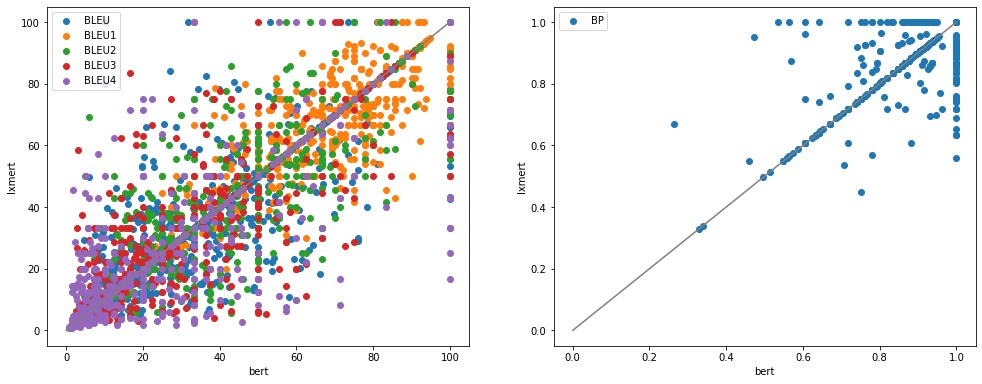

In [207]:
fig = figure(1, 2, 1.3)
plot_bleu(fig.add_subplot(1,2,1), df, 'bert', 'lxmert')
plot_bleu_bp(fig.add_subplot(1,2,2), df, 'bert', 'lxmert')
fig.show()

In [98]:
def show_bleu_comparison(target_df, m1, m2):
    fig = figure(3,2,1.3)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,1), target_df, 'bleu', m1, m2)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,2), target_df, 'bleu1', m1, m2)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,3), target_df, 'bleu2', m1, m2)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,4), target_df, 'bleu3', m1, m2)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,5), target_df, 'bleu4', m1, m2)
    plot_pairwise_prop_comparison(fig.add_subplot(3,2,6), target_df, 'bleu-bp', m1, m2)
    fig.show()

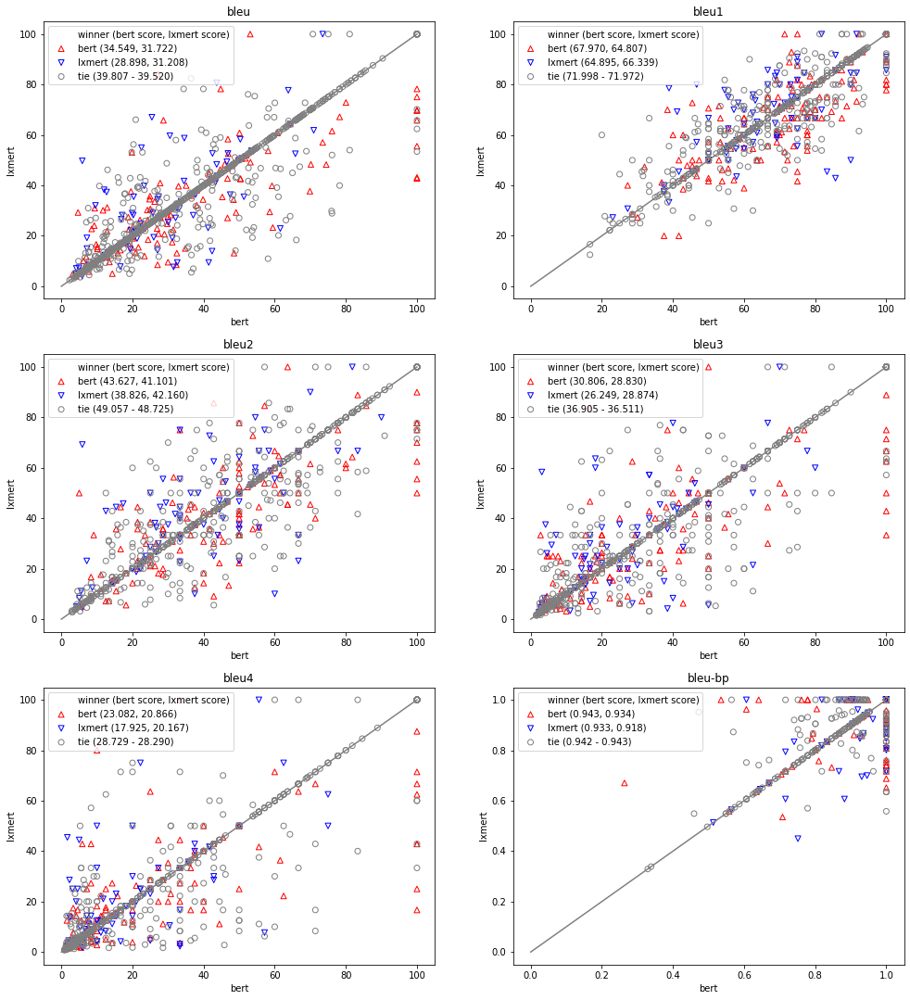

In [226]:
show_bleu_comparison(df, 'bert', 'lxmert')

- human evaluation で勝敗がついているものは、unigram の段階ですでに差がついている

## Length

In [87]:
def plot_length(ax_bp, target_df, m1, m2):
    max_len = max(target_df[f'hyp-len_{m1}'].max(), target_df[f'hyp-len_{m2}'].max())
    ax_bp.scatter(target_df[f'hyp-len_{m1}'],target_df[f'hyp-len_{m2}'], label='Hyp Length')
    ax_bp.plot([0, max_len], [0, max_len], color='gray')
    ax_bp.set_xlabel(m1)
    ax_bp.set_ylabel(m2)
    ax_bp.legend(loc='upper left')

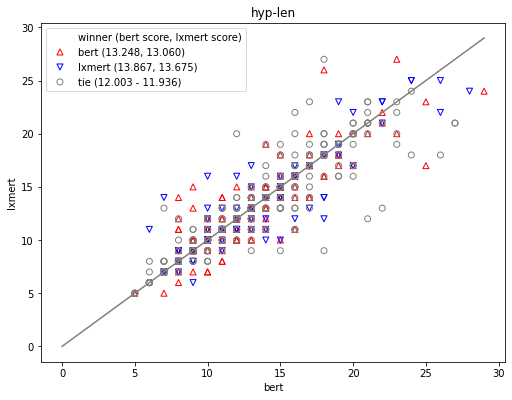

In [227]:
show_prop_comparison(df, 'hyp-len', 'bert', 'lxmert')

- 人手評価の結果によらず、BERT のほうが長い翻訳文を出力する傾向がある。

## Perplexity

#### mean

In [308]:
for model in MODELS:
    print('{:15}: {}'.format(model, df[f'ppl_{model}'].mean()))

text-only      : 9.214908821175069
bert           : 8.585527647660864
lxmert         : 8.969901621475811
all-inclusive  : 8.735919863086725


#### model comparison

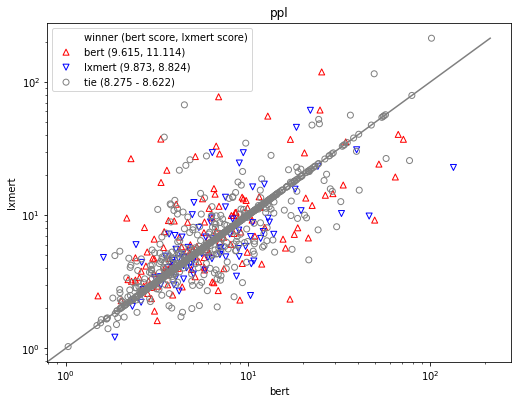

In [228]:
show_prop_comparison(df, 'ppl', 'bert', 'lxmert', log_scale=True)

- LXMERT のほうがばらつきが大きい

#### source ppl

In [88]:
def plot_src_ppl_by_len(ax, target_df, m1, m2, show_tie=False):
    src_ppl = target_df[f'ppl_src']
    src_len = target_df[f'src-len']
    
    m1_win = target_df[f'rank_{m1}'] < target_df[f'rank_{m2}']
    m2_win = target_df[f'rank_{m1}'] > target_df[f'rank_{m2}']
    tie = ~((m1_win) | (m2_win))
    
    ax.scatter(src_len[m1_win], src_ppl[m1_win], edgecolor='r', facecolor='none', marker='^', 
               label=f'{m1}')
    ax.scatter(src_len[m2_win], src_ppl[m2_win], edgecolor='b', facecolor='none', marker='v', 
               label=f'{m2}')
    if show_tie:
        ax.scatter(src_len[tie], src_ppl[tie], edgecolor='gray', facecolor='none', marker='o', 
                   label=f'tie')
    
    ax.set_yscale('log')
    ax.set_xlabel('source length')
    ax.set_ylabel('source perplexity')
    ax.legend(loc='upper left')

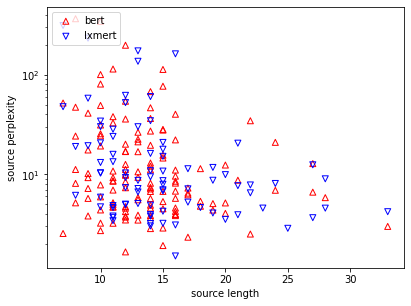

In [303]:
fig = figure(1,1,1)
plot_src_ppl_by_len(fig.add_subplot(1,1,1), df, 'bert', 'lxmert')
fig.show()

## F1 Score

In [89]:
def plot_f1_stat(ax, ax_freq, target_df, target_models=MODELS,
                 spans = [[-np.inf, 0], [0, 1], [1, 2], [2, 3], [3, 4], [4, 5], [5, 10], [10, 100], [100, np.inf]]):
    assert len(target_models) > 0
    assert len(target_df) > 0
    
    bar_width = 0.8 / len(target_models)
    base_x = np.array(range(len(spans)))
    legends = []
    span_labels=[f'({s_from}, {s_to}]' for (s_from, s_to) in spans]
    
    for i, m in enumerate(target_models):
        valid_rows = target_df[target_df.notna()[f'f1-score_{m}']]
        
        types = valid_rows.index
        freqs = valid_rows['freq']
        scores = valid_rows[f'f1-score_{m}']
        trues = valid_rows[f'f1-trues_{m}']
        preds = valid_rows[f'f1-preds_{m}']
        
        matches = [valid_rows[(s_from < freqs) & (freqs <= s_to)][f'f1-score_{m}'] for (s_from, s_to) in spans]
        freq_scores = [m.mean() for m in matches]
        freq_nums = [len(m) for m in matches]
        
        mean_score = scores.mean()
        
        x = base_x + bar_width * i
        
        p = ax.bar(x, freq_scores, label=f'{m} (mean={mean_score:.4f})', width=bar_width)
        ax.bar_label(p, rotation=90, padding=10)
        
        p_freq = ax_freq.bar(x, freq_nums, label=f'{m} (total={len(types)})', width=bar_width)
        ax_freq.bar_label(p_freq, rotation=90, padding=10)
    else:
        ax.set_xticks(base_x + 0.3, span_labels)
        ax.set_title('Macro-mean of token-level F1 Score')
        ax.set_ylabel('F1 Score')
        ax.set_xlim([-0.3, len(spans)])
        ax.set_ylim([0, 0.8])
        ax.legend(loc='upper left')
        
        ax_freq.set_xticks(base_x + 0.3, span_labels)
        ax_freq.set_title('Number of types')
        # ax_freq.set_ylim([0, 1200])
        ax_freq.legend(loc='upper left')
    
    return ax, ax_freq

In [90]:
def show_f1_stat(target_df, target_models=MODELS):
    fig = figure(1, 2, 1.5)
    plot_f1_stat(fig.add_subplot(1,2,1), fig.add_subplot(1,2,2), target_df, target_models=target_models)
    fig.show()

In [91]:
def show_f1_with_rare_common_words_stat(target_df, target_models=MODELS):
    fig = figure(1, 2, 1.5)
    ax, _ = plot_f1_stat(fig.add_subplot(1,2,1), fig.add_subplot(1,2,2), target_df, target_models=target_models)

    target_idx = (1 < target_df['freq']) & (target_df['freq'] <= 10)
    ax.text(4.5, 0.6, 'Rare words: {:.4f} (BERT), {:.4f} (LXMERT)'.format(
        target_df[target_idx]['f1-score_bert'].mean(),
        target_df[target_idx]['f1-score_lxmert'].mean()
    ), ha='right')

    target_idx = 10 < target_df['freq']
    ax.text(4.5, 0.57, 'Common words: {:.4f} (BERT), {:.4f} (LXMERT)'.format(
        target_df[target_idx]['f1-score_bert'].mean(),
        target_df[target_idx]['f1-score_lxmert'].mean()
    ), ha='right')
    fig.show()

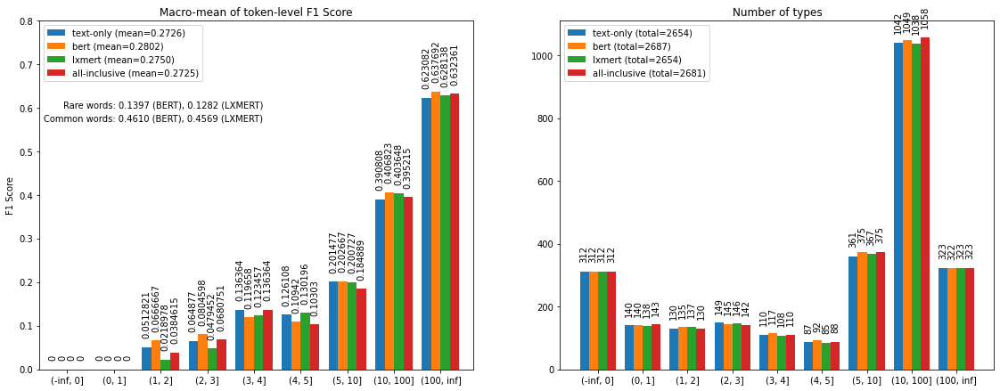

In [174]:
show_f1_with_rare_common_words_stat(type_f1_data)

- 平均的・低頻度語（freq<=10）・高頻度語（freq>10）のすべてで BERT のほうがよい
- 局所的に見ると、freq=4, 5 では lxmert のほうが良くなっている。

## BLEU by Length

In [92]:
def plot_delta_bleu_by_length(ax, target_df, m1, m2):
    src_lens = target_df['src-len']
    delta_bleu = target_df[f'bleu_{m1}'] - target_df[f'bleu_{m2}']
    
    m1_win_idx = target_df[f'rank_{m1}'] < target_df[f'rank_{m2}']
    m2_win_idx = target_df[f'rank_{m1}'] > target_df[f'rank_{m2}']
    tie_idx = ~((m1_win_idx) | (m2_win_idx))
    
    ax.scatter(src_lens[m1_win_idx], delta_bleu[m1_win_idx], marker='^', edgecolors='r', facecolors='none')
    ax.scatter(src_lens[m2_win_idx], delta_bleu[m2_win_idx], marker='v', edgecolors='b', facecolors='none')
    ax.scatter(src_lens[tie_idx], delta_bleu[tie_idx], marker='o', edgecolors='gray', facecolors='none')
    
    ax.legend([m1, m2, 'tie'])

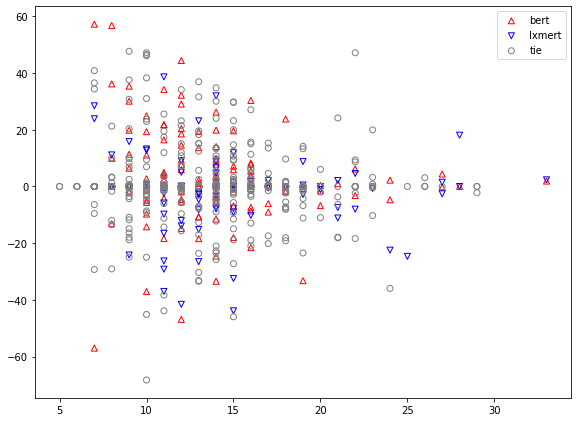

In [231]:
fig = figure(1,1,1.5)
plot_delta_bleu_by_length(fig.add_subplot(1,1,1),df,'bert','lxmert')
fig.show()

- 大きな BLEU 差があっても、評価が自動（BLEU）と人手で逆転しているものがある。
- 入力の文長によらず、逆転が発生している。

## BLEU by source ppl

In [93]:
def plot_bleu_by_src_ppl(ax, target_df, target_m, compare_m):
    src_ppl = target_df['ppl_src']
    bleus = target_df[f'bleu_{target_m}']
    
    m1_win_idx = target_df[f'rank_{target_m}'] < target_df[f'rank_{compare_m}']
    m2_win_idx = target_df[f'rank_{target_m}'] > target_df[f'rank_{compare_m}']
    tie_idx = ~((m1_win_idx) | (m2_win_idx))
    
    ax.scatter(src_ppl[m1_win_idx], bleus[m1_win_idx], marker='^', edgecolors='r', facecolors='none')
    ax.scatter(src_ppl[m2_win_idx], bleus[m2_win_idx], marker='v', edgecolors='b', facecolors='none')
    ax.scatter(src_ppl[tie_idx], bleus[tie_idx], marker='o', edgecolors='gray', facecolors='none')
    
    ax.set_xscale('log')
    
    ax.legend([target_m, compare_m, 'tie'])
    ax.set_xlabel('source ppl (log-scale)')
    ax.set_ylabel('BLEU')
    ax.set_title(f'{target_m} BLEU by source ppl')

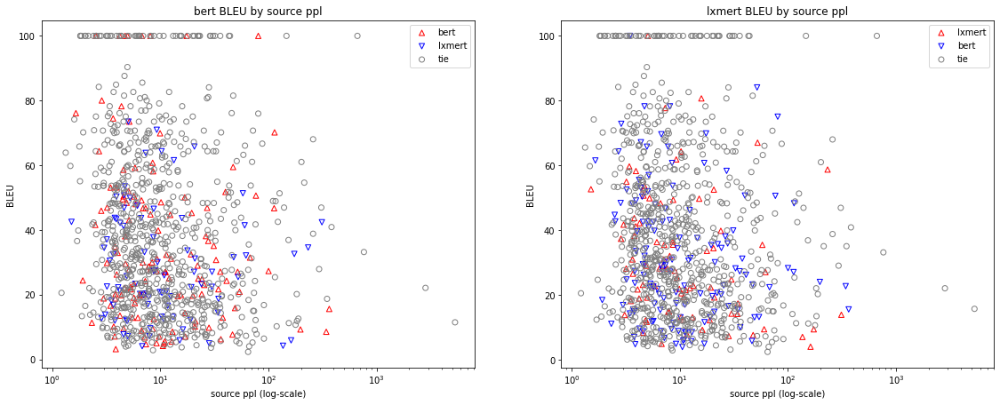

In [277]:
fig = figure(1,2,1.5)
plot_bleu_by_src_ppl(fig.add_subplot(1,2,1),df,'bert','lxmert')
plot_bleu_by_src_ppl(fig.add_subplot(1,2,2),df,'lxmert','bert')
fig.show()

- 人手評価と入力文の複雑さ（ppl）に相関は見られない

In [94]:
def plot_delta_bleu_by_src_ppl(ax, target_df, m1, m2):
    src_ppl = target_df['ppl_src']
    delta_bleu = target_df[f'bleu_{m1}'] - target_df[f'bleu_{m2}']
    
    m1_win_idx = target_df[f'rank_{m1}'] < target_df[f'rank_{m2}']
    m2_win_idx = target_df[f'rank_{m1}'] > target_df[f'rank_{m2}']
    tie_idx = ~((m1_win_idx) | (m2_win_idx))
    
    ax.scatter(src_ppl[m1_win_idx], delta_bleu[m1_win_idx], marker='^', edgecolors='r', facecolors='none')
    ax.scatter(src_ppl[m2_win_idx], delta_bleu[m2_win_idx], marker='v', edgecolors='b', facecolors='none')
    ax.scatter(src_ppl[tie_idx], delta_bleu[tie_idx], marker='o', edgecolors='gray', facecolors='none')
    
    ax.set_xscale('log')
    
    ax.legend([m1, m2, 'tie'])
    ax.set_xlabel('source ppl (log-scale)')
    ax.set_ylabel('ΔBLEU')

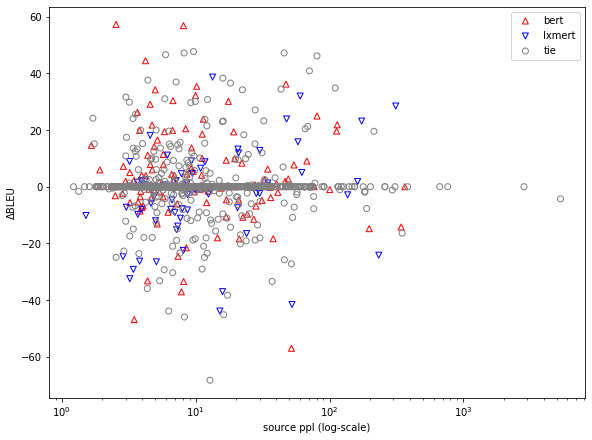

In [272]:
fig = figure(1,1,1.5)
plot_delta_bleu_by_src_ppl(fig.add_subplot(1,1,1),df,'bert','lxmert')
fig.show()

## Samples

In [95]:
from IPython.core.display import Image, display

In [96]:
def show_samples(target_df, target_models=MODELS, disp_attr=[]):
    for index, row in target_df.iterrows():
        print(f'ID {index}')
        display(Image(row['image_url'], unconfined=True))
        # ![](${row['image_url']})
        print(f'source    : ' + row['src'])
        print(f'reference : ' + row['ref'])
        for m in target_models:
            print('{:10}: {}'.format(m, row[f'hyp_{m}']) + 
                 ('' if len(disp_attr) == 0 else ' ({})'.format(', '.join([f'{attr}={row[attr+"_"+m]:.3f}' for attr in disp_attr]))))
            print('{:10} ({})'.format("", row[f'hyp-en_{m}']))
        print(''.join(['-']*80))

In [244]:
delta_bleu_bw_bert_lxmert = df[['image_url','src','ref','hyp_bert','hyp_lxmert','hyp-en_bert','hyp-en_lxmert','reversal_bert_to_lxmert', 'reversal_lxmert_to_bert','bleu_bert','bleu_lxmert']].copy(deep=True)

In [245]:
delta_bleu_bw_bert_lxmert['delta-bleu'] = delta_bleu_bw_bert_lxmert['bleu_bert'] - delta_bleu_bw_bert_lxmert['bleu_lxmert']

ID 244


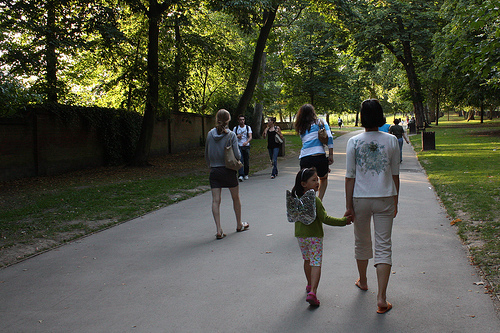

source    : people walking on a trail in a tree filled park .
reference : menschen gehen auf einem pfad in einem park voller bäume .
bert      : menschen gehen auf einem pfad in einem überdachten park .
           (people walking on a path in a covered park .)
lxmert    : menschen gehen auf einem weg in einem park , der mit vielen bäumen bedeckt ist .
           (people walking on a path in a park that is covered with many trees.)
--------------------------------------------------------------------------------
ID 992


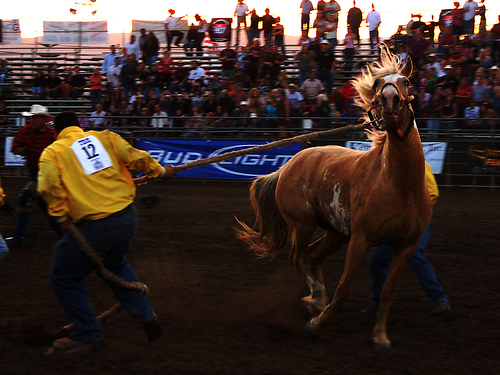

source    : this is a man dressed in yellow holding the reign of a brown horse
reference : das ist ein gelb gekleideter mann , der ein braunes pferd an der leine hält .
bert      : dies ist ein gelb gekleideter mann , der die aufmerksamkeit eines braunen pferds hält .
           (this is a yellow dressed man holding the attention of a brown horse.)
lxmert    : dies ist ein mann in gelb gekleidet , der einen braunen pferd hält .
           (this is a man dressed in yellow holding a brown horse.)
--------------------------------------------------------------------------------
ID 491


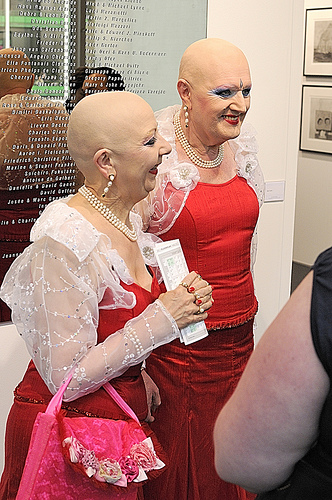

source    : two bald drag queens in red dresses
reference : zwei glatzköpfige drag queens in roten kleidern .
bert      : zwei glatzköpfige fußballer in roten kleidern .
           (two bald soccer players in red dresses .)
lxmert    : zwei glatzköpfige , die rote kleider tragen , sind in roten kleidern unterwegs .
           (two bald men wearing red dresses are traveling in red dresses.)
--------------------------------------------------------------------------------
ID 678


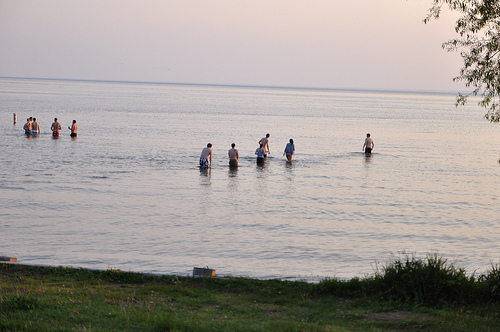

source    : two groups of swimmers wade out .
reference : zwei gruppen von schwimmern waten ins wasser .
bert      : zwei gruppen von schwimmern , die aus fischen .
           (two groups of swimmers made of fish.)
lxmert    : zwei schwimmer waten durch seichtes .
           (two swimmers wade through shallow .)
--------------------------------------------------------------------------------
ID 938


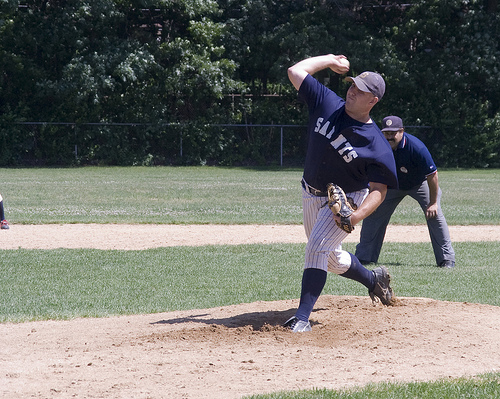

source    : a right @-@ handed pitcher for the saints is throwing a pitch .
reference : ein rechtshändiger pitcher der saints wirft einen ball .
bert      : ein baseballwerfer wirft einen ball .
           (a baseball pitcher throws a ball .)
lxmert    : ein pitcher wirft einen pitch nach dem wurf des balls .
           (a pitcher throws a pitch after the ball is thrown .)
--------------------------------------------------------------------------------
ID 981


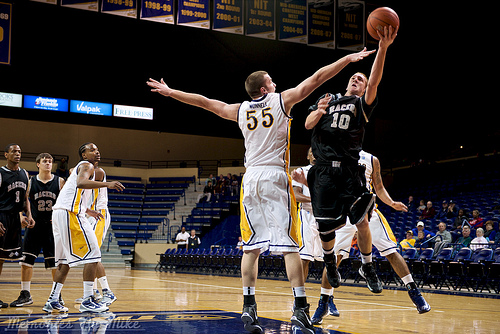

source    : the basketball player in the white uniform with the number 55 on it is guarding the player in the black uniform with the number 10 on it .
reference : der basketballspieler im weißen trikot mit der nummer 55 deckt den spieler im schwarzen trikot mit der nummer 10.
bert      : der basketballspieler im weißen trikot mit der nummer 10 ist auf dem boden , ein spieler in einem schwarzen trikot mit der zahl 5 darauf .
           (the basketball player in the white jersey with the number 10 is on the floor , a player in a black jersey with the number 5 on it .)
lxmert    : der basketballspieler in dem weißen trikot mit der nummer 11 ist kurz davor den spieler in einem schwarzen trikot zu blocken .
           (the basketball player in the white jersey with the number 11 is about to block the player in a black jersey .)
--------------------------------------------------------------------------------
ID 516


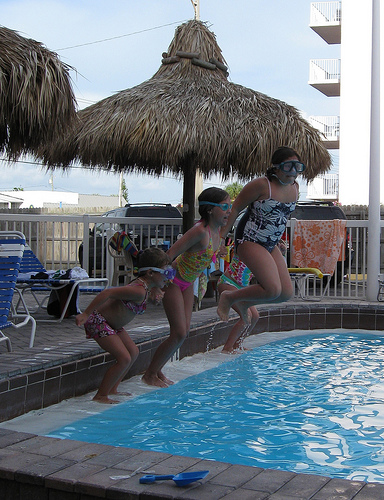

source    : children jump off the edge into a pool .
reference : kinder springen vom rand in einen pool .
bert      : kinder springen von den rand in einen pool .
           (kinder springen von den rand in einen pool .)
lxmert    : kinder springen von der kante in einen pool .
           (children jumping from the edge into a pool .)
--------------------------------------------------------------------------------
ID 570


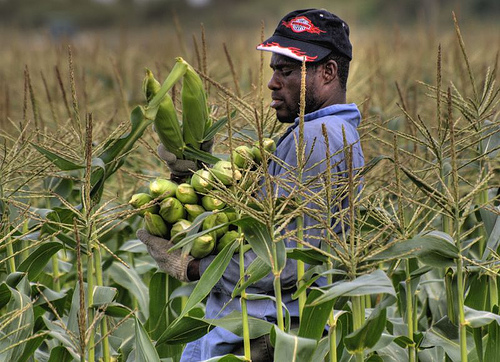

source    : a man wearing gloves carries corn through a field .
reference : ein mann mit handschuhen trägt mais durch ein feld .
bert      : ein mann mit handschuhen trägt steine durch ein feld .
           (a man with gloves carries stones through a field .)
lxmert    : ein mann mit handschuhen trägt getreide über ein feld .
           (a man with gloves carries grain across a field .)
--------------------------------------------------------------------------------
ID 688


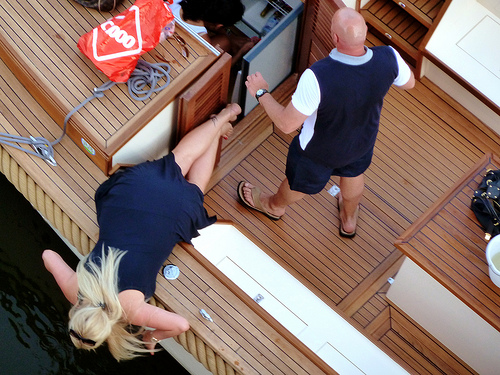

source    : two people are spending good time in their boat .
reference : zwei personen vergnügen sich auf ihrem boot .
bert      : zwei personen amüsieren sich in ihrem boot .
           (two people having fun in their boat .)
lxmert    : zwei personen haben spaß in ihrem boot miteinander .
           (two people have fun in their boat with each other .)
--------------------------------------------------------------------------------
ID 413


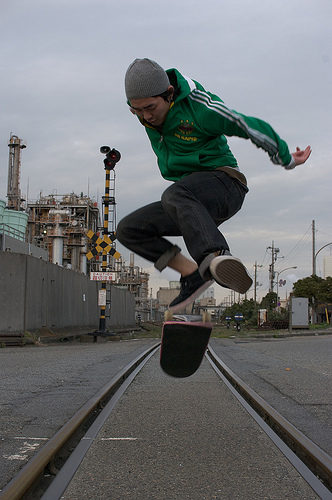

source    : a boy with a skateboard if jumping in the air along some railway tracks .
reference : ein junge auf einem skateboard springt neben eisenbahnschienen in die luft .
bert      : ein junge mit einem skateboard springt bei einigen bahngleisen in die luft .
           (a boy with a skateboard jumps into the air at some railroad tracks .)
lxmert    : ein junge mit einem skateboard springt in die luft an ein paar bahngleisen entlang .
           (a boy with a skateboard jumps into the air along some railroad tracks .)
--------------------------------------------------------------------------------
ID 86


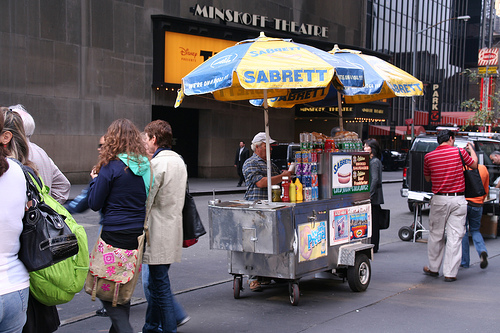

source    : a man is working a hotdog stand .
reference : ein mann arbeitet an einem hotdog @-@ stand .
bert      : ein mann arbeitet an einem hotdog .
           (a man working on a hotdog .)
lxmert    : ein mann arbeitet an einem imbissstand .
           (a man works at a bite stand .)
--------------------------------------------------------------------------------
ID 374


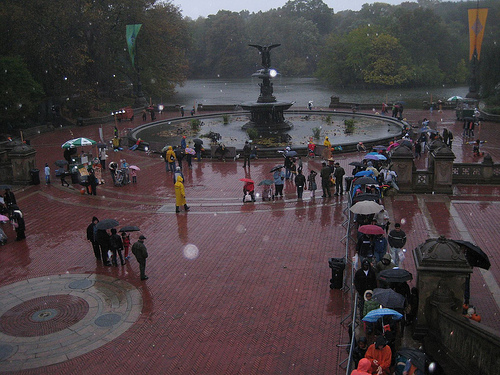

source    : a crowd gathered around a park water fountain in the rain .
reference : eine menschenmenge hat sich im regen um einen springbrunnen im park versammelt .
bert      : eine menschenmenge hat sich im regen um einen springbrunnen versammelt .
           (a crowd has gathered in the rain around a fountain .)
lxmert    : eine menschenmenge hat sich im regen um einen brunnen versammelt .
           (a crowd has gathered in the rain around a fountain .)
--------------------------------------------------------------------------------
ID 239


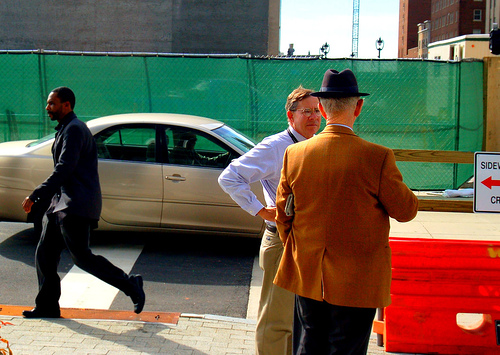

source    : two men stop to chat on the sidewalk as a car passes by .
reference : zwei männer unterhalten sich auf dem gehsteig während ein auto vorbeifährt .
bert      : zwei männer halten auf dem gehweg an , während ein auto vorbeifährt .
           (two men stop on the sidewalk while a car drives by.)
lxmert    : zwei männer halten an , um auf dem bürgersteig zu unterhalten , während ein auto vorbeifährt .
           (two men stop to talk on the sidewalk while a car drives by .)
--------------------------------------------------------------------------------
ID 109


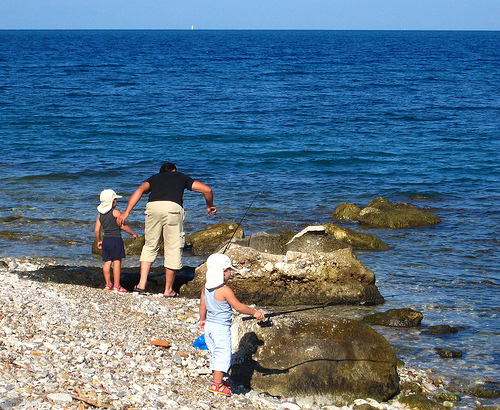

source    : a mother teaches her two young boys to fish off of a rocky coast into very blue water .
reference : eine mutter bringt ihren zwei kleinen söhnen an einer felsigen küste mit sehr blauem wasser das angeln bei .
bert      : eine mutter bringt ihren kleinen jungen an , um von einer felsigen anlegestelle in sehr blauen wasser zu fischen .
           (a mother brings her little boy to fish from a rocky jetty in very blue water.)
lxmert    : eine mutter hilft zwei kleinen jungen beim fischen von einer felsigen anlegestelle in sehr blauen wasser .
           (a mother helps two young boys fish from a rocky jetty in very blue water .)
--------------------------------------------------------------------------------
ID 15


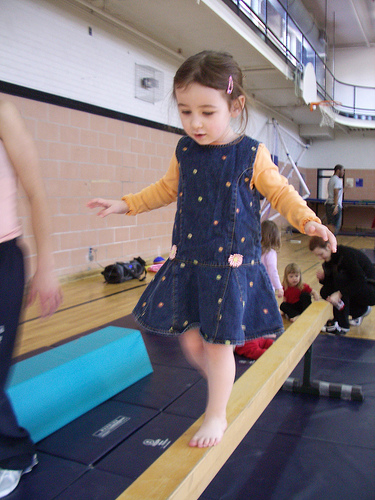

source    : a girl in a jean dress is walking along a raised balance beam .
reference : ein mädchen in einem jeanskleid läuft über einen erhöhten schwebebalken .
bert      : ein mädchen in einem jeans geht einen dekorativen balken entlang .
           (a girl in a jeans walks along a decorative beam .)
lxmert    : ein mädchen in jeans läuft auf einem schwebebalken .
           (girl in jeans walking on a balance beam .)
--------------------------------------------------------------------------------
ID 950


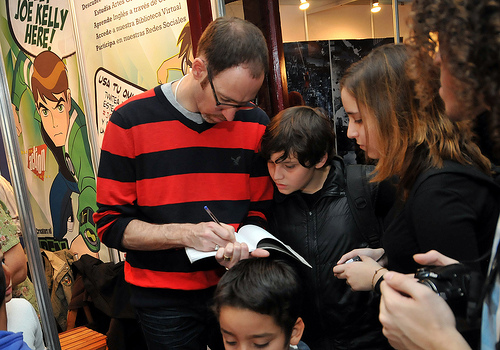

source    : a man signs an autograph in a young boy &apos;s book .
reference : ein mann schreibt einem kleinen jungen ein autogramm ins buch .
bert      : ein mann schildern in einem kleinen jungen ein buch .
           (a man depict in a little boy a book .)
lxmert    : ein mann , der in einem kleinen jungen ein buch macht .
           (a man who makes a book in a little boy.)
--------------------------------------------------------------------------------
ID 253


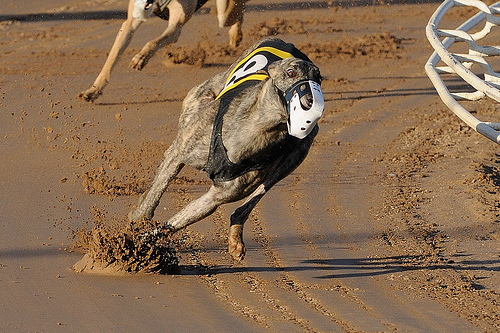

source    : a muzzled greyhound dog wearing yellow and black is running on the track .
reference : ein windhund mit maulkorb in gelb und schwarz läuft auf der strecke .
bert      : ein windhund mit maulkorb und schwarzer kleidung läuft auf der rennstrecke .
           (a greyhound with muzzle and black clothes runs on the race track .)
lxmert    : ein windhund mit maulkorb , der gelb und schwarz trägt , rennt auf der rennstrecke .
           (a greyhound with muzzle , wearing yellow and black , running on the racetrack .)
--------------------------------------------------------------------------------
ID 773


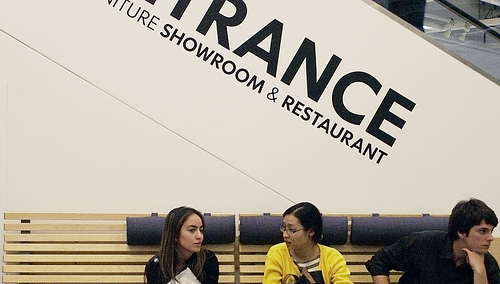

source    : the lady wearing black rimmed glasses and a yellow sweater jacket looks confused as she sits on the tan covered bench .
reference : die dame mit der schwarz gerahmten brille und der gelben sweatjacke blickt verwirrt während sie auf der braunen bank sitzt .
bert      : die dame mit schwarzer reflektierender brille und gelber jacke sitzt auf der braunen bank und sieht aufgeregt aus .
           (the lady with black reflective glasses and yellow jacket sits on the brown bench and looks excited .)
lxmert    : die dame , die eine schwarze brille und eine gelbe jacke trägt , sitzt auf der braunen bank und schaut nach vorn .
           (the lady wearing black glasses and a yellow jacket sits on the brown bench and looks forward.)
--------------------------------------------------------------------------------
ID 873


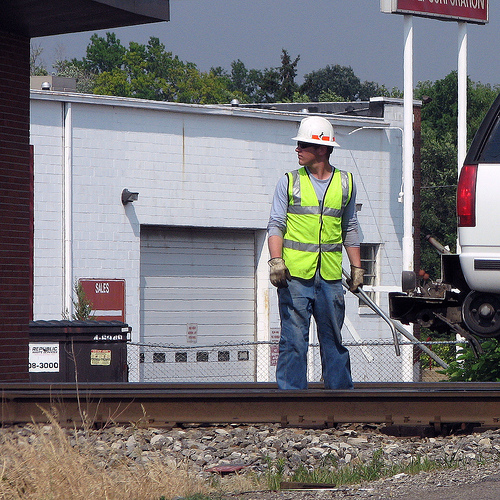

source    : a man wearing a gray shirt , blue jeans and a neon green safety vest is standing on a railroad track with a white truck and a white building in the background .
reference : ein mann mit einem grauen shirt , blauen jeans und neongrüner sicherheitsweste steht mit einem weißen lieferwagen und einem weißen gebäude im hintergrund auf einer bahnstrecke .
bert      : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw und einem weißen lkw im hintergrund .
           (a man in a gray shirt , blue jeans and a green safety vest stands on a runway with a white truck and a white truck in the background .)
lxmert    : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw im hintergrund .
           (a man in a gray shirt , blue jeans and a green safety vest stands on a runway with a white truck in the background .)
------------------------------

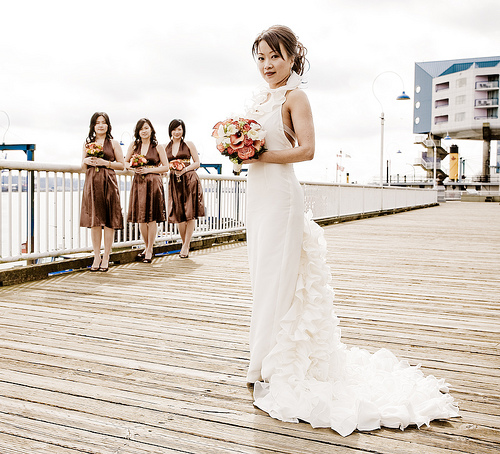

source    : an asian woman in a floral wedding dress poses on a bridge close to her bridesmaids .
reference : eine asiatische frau in einem hochzeitskleid mit blumenmuster posiert mit ihren brautjungfern auf einer brücke .
bert      : eine asiatische frau in einem blumenkleid posiert auf einer brücke in der nähe ihrer brautjungfern .
           (an asian woman in a flower dress poses on a bridge near her bridesmaids .)
lxmert    : eine asiatische frau in einem geblümten kleid posiert auf einer brücke in der nähe ihrer brautjungfern .
           (an asian woman in a flowered dress poses on a bridge near her bridesmaids .)
--------------------------------------------------------------------------------
ID 269


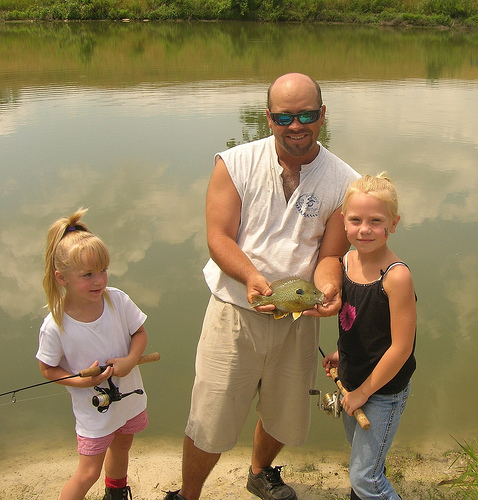

source    : a man and two girls show off a fish while holding fishing poles in front of a body of water .
reference : ein mann und zwei mädchen mit angelruten vor einem gewässer halten einen fisch hoch .
bert      : ein mann und zwei mädchen zeigen eine angel und halten angelruten vor einem gewässer .
           (a man and two girls show a fishing and hold fishing rods in front of a body of water .)
lxmert    : ein mann und zwei mädchen zeigen auf einem fisch und halten angelruten vor einem gewässer .
           (a man and two girls pointing at a fish and holding fishing rods in front of a body of water .)
--------------------------------------------------------------------------------
ID 351


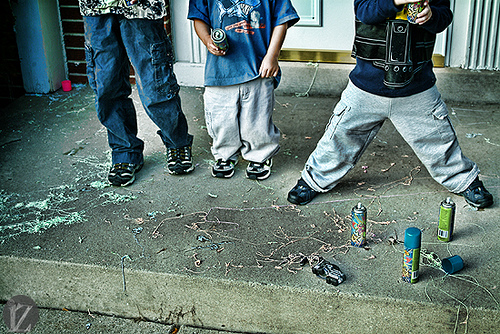

source    : three children &apos;s legs are shown as they stand near a mess of silly string .
reference : die beine von drei kindern , die neben einem durcheinander verknoteter fäden stehen .
bert      : drei kinder stehen in der nähe von einem stapel seil , während sie an der beine stehen .
           (three children standing near a stack of rope while standing on the legs.)
lxmert    : drei kinder stehen in der nähe einer reihe von erwachsenen erwachsenen .
           (three children standing near a row of grown adults .)
--------------------------------------------------------------------------------
ID 973


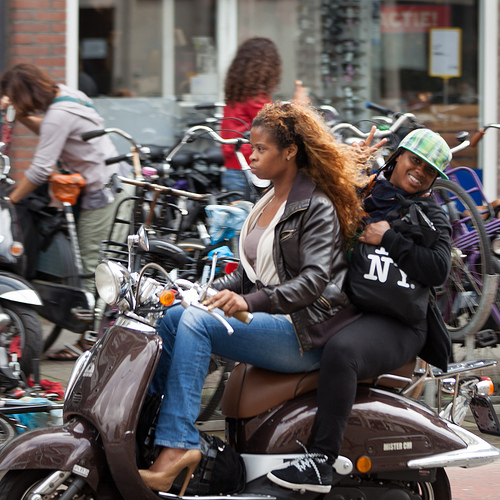

source    : two african american females ride on a moped down a city street that appears to be in a well congested area of a large city area .
reference : zwei afroamerikanische frauen fahren auf einem moped auf einer städtischen straße , die sich anscheinend in einem großstadtgebiet mit stau befindet .
bert      : zwei afroamerikanische frauen fahren auf einem moped eine straße in einer großstadt , die anscheinend einer großen stadt zu sein scheint .
           (two african american women ride a moped down a street in what appears to be a large city.)
lxmert    : zwei afroamerikanische frauen fahren auf einem moped eine straße in der stadt entlang , die anscheinend einer großen stadt zu sein scheint .
           (two african american women ride a moped down a city street that appears to be a large city.)
--------------------------------------------------------------------------------
ID 393


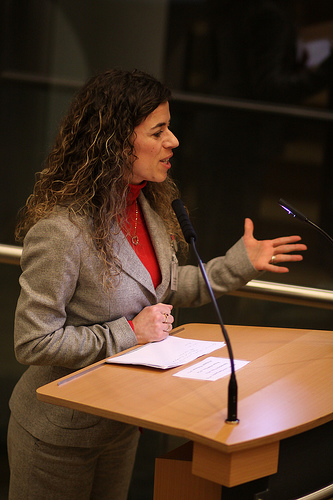

source    : a professionally dressed woman standing at a podium debating or discussing something of importance .
reference : eine professionell gekleidete frau steht an einem podium und debattiert oder diskutiert über etwas wichtiges .
bert      : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert und diskutieren etwas .
           (a colorfully dressed woman is standing at a podium or discussing and debating something .)
lxmert    : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert etwas .
           (a colorfully dressed woman stands at a podium or discusses something .)
--------------------------------------------------------------------------------
ID 257


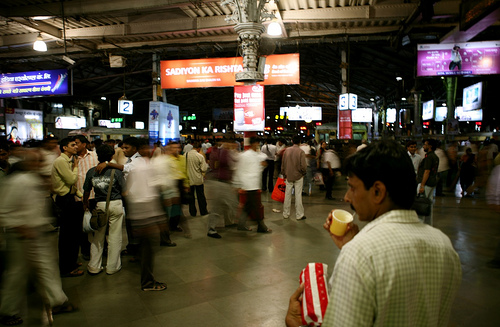

source    : a man drinking out of a yellow cup around people at a busy event
reference : ein mann , der aus einer gelben tasse trinkt , umgeben von menschen auf einer geschäftigen veranstaltung .
bert      : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse um die menschen herum .
           (a man drinks from a yellow cup around people at a busy event .)
lxmert    : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse .
           (a man drinks from a yellow cup at a busy event .)
--------------------------------------------------------------------------------
ID 481


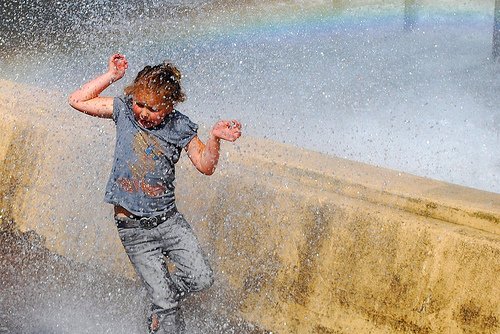

source    : a girl is playing in the fountain fully clothed .
reference : ein mädchen spielt komplett bekleidet im springbrunnen .
bert      : ein mädchen spielt im brunnen und hölle .
           (a girl plays in the well and hell .)
lxmert    : ein mädchen spielt in der wasserfontäne .
           (a girl plays in the water fountain .)
--------------------------------------------------------------------------------
ID 665


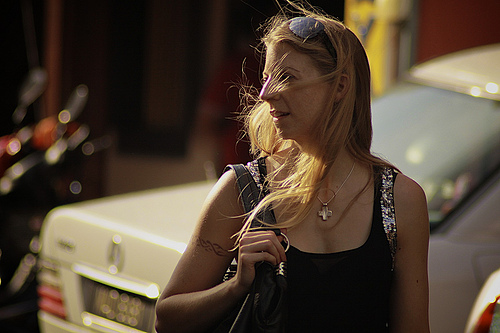

source    : a woman wearing a black tank top and a cross necklace stares off into the distance near sunset .
reference : eine frau in einem schwarzen tank @-@ top mit einem kreuz @-@ halsband blickt kurz vor sonnenuntergang in die ferne .
bert      : eine frau in einem schwarzen tanktop und mit einer halskette blickt in die ferne .
           (a woman in a black tank top and with a necklace looks into the distance .)
lxmert    : eine frau in einem schwarzen oberteil und mit einer halskette starrt in die ferne .
           (a woman in a black top and with a necklace stares into the distance .)
--------------------------------------------------------------------------------
ID 376


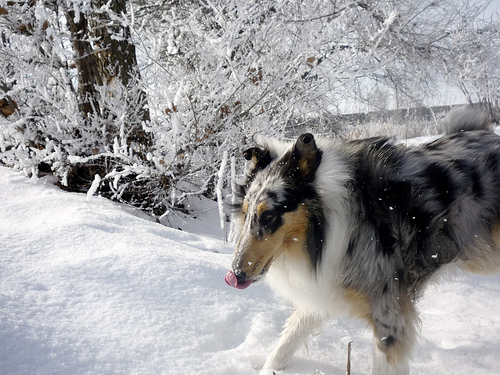

source    : a young lassie looking dog is in the snow .
reference : ein junger hund , der aussieht wie lassie , im schnee .
bert      : ein kleiner terrier aussehender hund ist im schnee .
           (a small terrier looking dog is in the snow .)
lxmert    : ein kleiner gefleckter hund ist im schnee .
           (a small spotted dog is in the snow .)
--------------------------------------------------------------------------------
ID 92


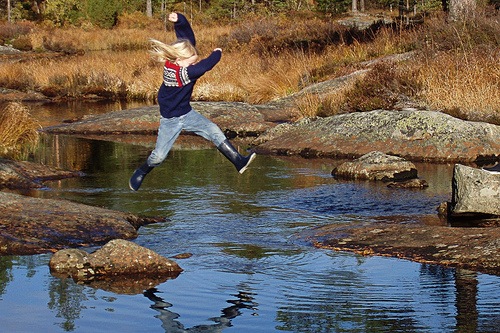

source    : a girl hops across the river , from rock to rock .
reference : ein mädchen springt von fels zu fels über den bach .
bert      : ein mädchen taucht von einem felsen über den fluss .
           (a girl dives from a rock across the river .)
lxmert    : ein mädchen taucht von einem felsen aus über den fluss .
           (a girl dives from a rock across the river .)
--------------------------------------------------------------------------------


In [247]:
show_samples(delta_bleu_bw_bert_lxmert[delta_bleu_bw_bert_lxmert['reversal_bert_to_lxmert']].sort_values('delta-bleu', ascending=False), target_models=['bert','lxmert'])

# Pairwise comparison

In [525]:
for i, m1 in enumerate(models):
    for m2 in models[i+1:]:
        n_win = (df[f'rank_{m1}'] < df[f'rank_{m2}']).sum()
        n_loss = (df[f'rank_{m1}'] > df[f'rank_{m2}']).sum()
        print(f'{m1:10} - {m2:15}: {n_win:3} - {n_loss:3}')

text-only  - bert           :  86 - 170
text-only  - lxmert         : 105 - 129
text-only  - all-inclusive  : 120 - 139
bert       - lxmert         : 133 -  83
bert       - all-inclusive  : 132 -  70
lxmert     - all-inclusive  :  99 -  86


In [526]:
for i, m1 in enumerate(models):
    for m2 in models[i+1:]:
        n_win = (df[f'bleu_{m1}'] > df[f'bleu_{m2}']).sum()
        n_loss = (df[f'bleu_{m1}'] < df[f'bleu_{m2}']).sum()
        print(f'{m1:10} - {m2:15}: {n_win:3} - {n_loss:3}')

text-only  - bert           : 248 - 293
text-only  - lxmert         : 220 - 262
text-only  - all-inclusive  : 218 - 283
bert       - lxmert         : 218 - 219
bert       - all-inclusive  : 214 - 201
lxmert     - all-inclusive  : 174 - 180


## BERT -> LXMERT

In [46]:
df_reversal_bert_to_lxmert = df[df['reversal_bert_to_lxmert']]
len(df_reversal_bert_to_lxmert)

29

### Ratio

In [61]:
df_bert_win = df[df['bleu_bert'] > df['bleu_lxmert']]

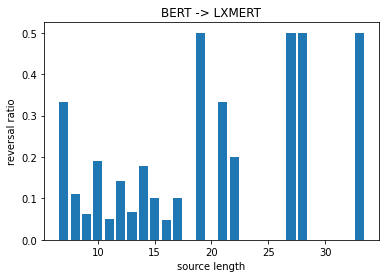

,src,reversal_bert_to_lxmert,reversal_ratio
src-len,,,
7,6,2,0.333333
8,9,1,0.111111
9,16,1,0.062500
10,21,4,0.190476
11,20,1,0.050000
12,21,3,0.142857
13,15,1,0.066667
14,28,5,0.178571
15,20,2,0.100000


In [62]:
df_reversal_ratio = pd.DataFrame.join(
    df_bert_win[['src-len', 'src']].groupby('src-len').count(),
    df_bert_win[['src-len', 'reversal_bert_to_lxmert']].groupby('src-len').sum()
)
df_reversal_ratio['reversal_ratio'] = df_reversal_ratio['reversal_bert_to_lxmert'] / df_reversal_ratio['src']

plt.bar(df_reversal_ratio.index, df_reversal_ratio['reversal_ratio'])
plt.xlabel('source length')
plt.ylabel('reversal ratio')
plt.title('BERT -> LXMERT')
plt.show()


display(df_reversal_ratio)

- 入力文長が短いほうが逆転しやすい？

### BLEU

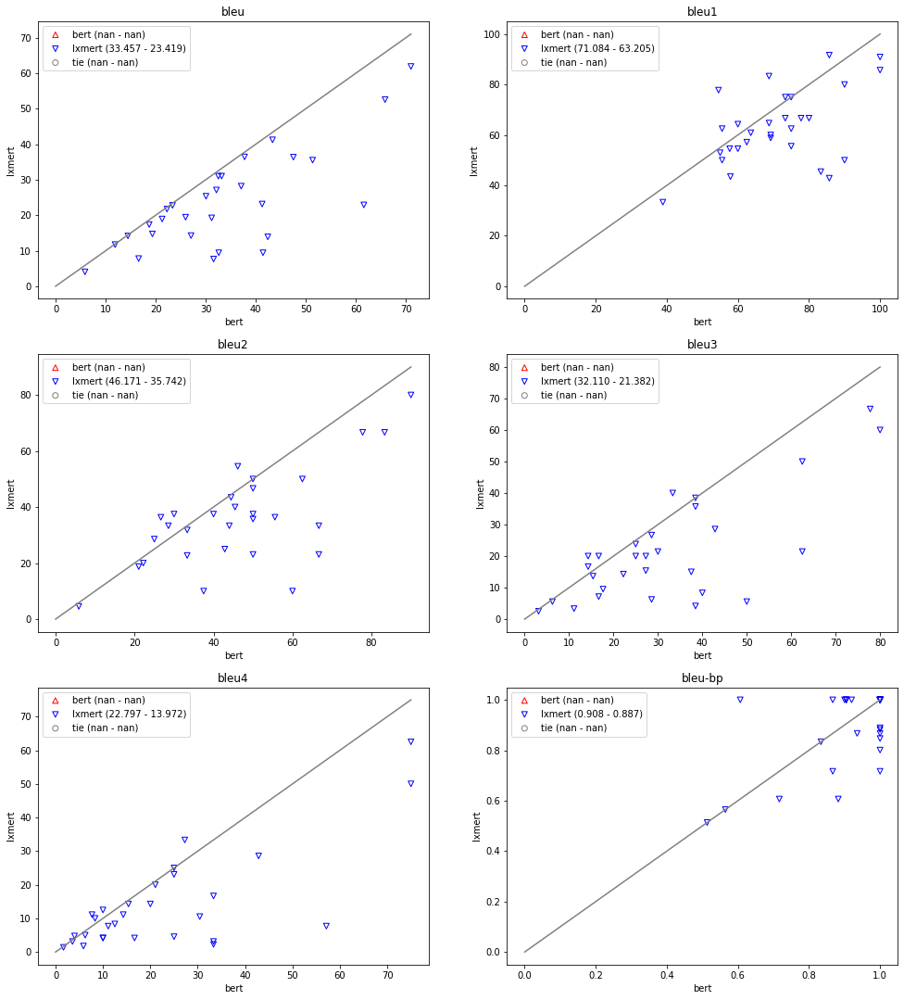

In [124]:
show_bleu_comparison(df_reversal_bert_to_lxmert,'bert', 'lxmert')

- unigram でも差が発生していた。単語レベルでは BERT のほうが予測精度が高い。
- length penalty でも BERT のほうがよい。

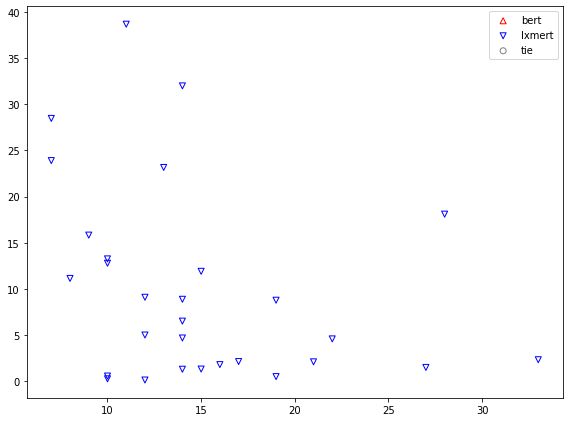

In [248]:
fig = figure(1,1,1.5)
plot_delta_bleu_by_length(fig.add_subplot(1,1,1),df_reversal_bert_to_lxmert,'bert','lxmert')
fig.show()

### Length

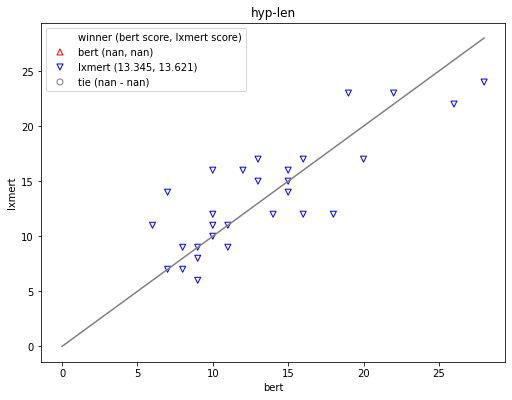

In [310]:
show_prop_comparison(df_reversal_bert_to_lxmert, 'hyp-len', 'bert', 'lxmert')

### ppl

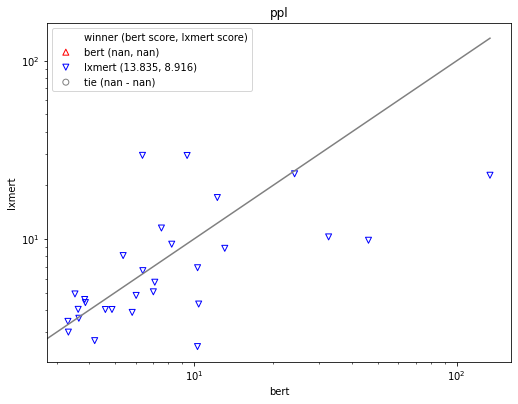

In [296]:
show_prop_comparison(df_reversal_bert_to_lxmert, 'ppl', 'bert', 'lxmert', log_scale=True)

- 逆転したサンプルでは、lxmert のほうが ppl が低くなる（BLEU でみると、LXMERT が悪い）

- 流暢性は良いが、

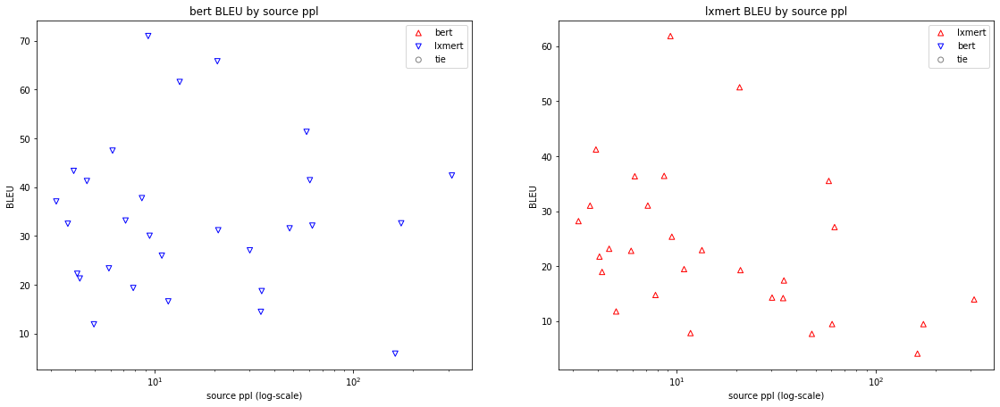

In [281]:
fig = figure(1,2,1.5)
plot_bleu_by_src_ppl(fig.add_subplot(1,2,1),df_reversal_bert_to_lxmert,'bert','lxmert')
plot_bleu_by_src_ppl(fig.add_subplot(1,2,2),df_reversal_bert_to_lxmert,'lxmert','bert')
fig.show()

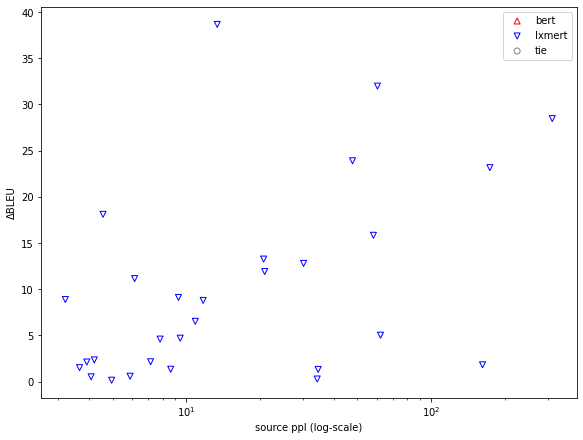

In [282]:
fig = figure(1,1,1.5)
plot_delta_bleu_by_src_ppl(fig.add_subplot(1,1,1),df_reversal_bert_to_lxmert,'bert','lxmert')
fig.show()

- シンプルな入力文ではあまり差が出ない。

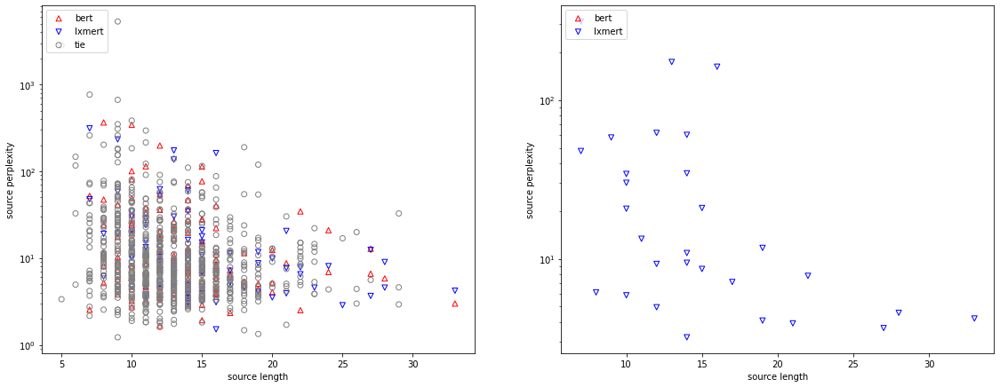

In [309]:
fig = figure(1,2,1.5)
plot_src_ppl_by_len(fig.add_subplot(1,2,1),df,'bert','lxmert', show_tie=True)
plot_src_ppl_by_len(fig.add_subplot(1,2,2),df_reversal_bert_to_lxmert,'bert','lxmert')
fig.show()

- 逆転したサンプルに特徴的なものは見られない。

### F1 Score

In [63]:
type_f1_data_reserval_bert_to_lxmert = get_type_f1_data(freq_data, df_reversal_bert_to_lxmert, target_models=['bert','lxmert'])

  0%|          | 0/267 [00:00<?, ?it/s]

  0%|          | 0/275 [00:00<?, ?it/s]

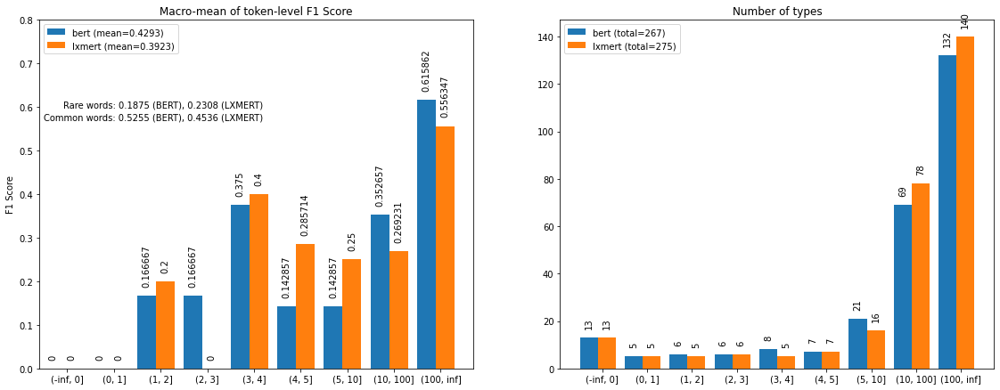

In [64]:
show_f1_with_rare_common_words_stat(type_f1_data_reserval_bert_to_lxmert, target_models=['bert','lxmert'])

#### rare words

In [69]:
type_f1_data_reserval_bert_to_lxmert[
    (type_f1_data_reserval_bert_to_lxmert['freq'].isin([4,5,6,7,8,9,10])) & 
    (~type_f1_data_reserval_bert_to_lxmert.isnull()['f1-score_bert'] | ~type_f1_data_reserval_bert_to_lxmert.isnull()['f1-score_lxmert'])
].sort_values(['f1-score_lxmert', 'freq'], ascending=False)

,freq,val_freq,type-en,f1-score_bert,f1-trues_bert,f1-preds_bert,f1-score_lxmert,f1-trues_lxmert,f1-preds_lxmert
type,,,,,,,,,
windhund,10.0,1.0,greyhound,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
sicherheitsweste,9.0,2.0,safety vest,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
brautjungfern,7.0,1.0,bridesmaids,1.0,"[False, False, False, False, True, False, Fals...","[False, False, False, False, True, False, Fals...",1.0,"[False, False, False, False, True, False, Fals...","[False, False, False, False, True, False, Fals..."
schwebebalken,7.0,1.0,balance beam,0.0,"[True, False, False, False, False, False, Fals...","[False, False, False, False, False, False, Fal...",1.0,"[True, False, False, False, False, False, Fals...","[True, False, False, False, False, False, Fals..."
anscheinend,5.0,4.0,apparently,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
waten,5.0,1.0,wade,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
angelruten,4.0,1.0,fishing rods,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
diskutiert,4.0,2.0,discusses,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
halskette,10.0,0.0,necklace,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."


### samples

#### sort by delta BLEU

ID 244


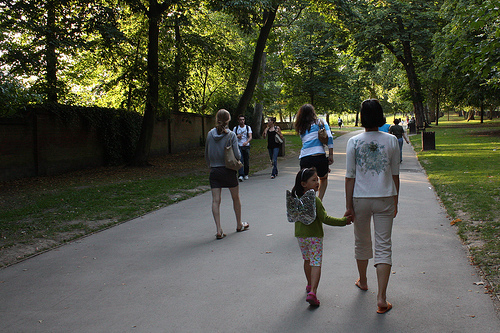

source    : people walking on a trail in a tree filled park .
reference : menschen gehen auf einem pfad in einem park voller bäume .
bert      : menschen gehen auf einem pfad in einem überdachten park . (bleu=61.563, bleu1=90.000, bleu4=57.143)
           (people walking on a path in a covered park .)
lxmert    : menschen gehen auf einem weg in einem park , der mit vielen bäumen bedeckt ist . (bleu=22.894, bleu1=50.000, bleu4=7.692)
           (people walking on a path in a park that is covered with many trees.)
--------------------------------------------------------------------------------
ID 992


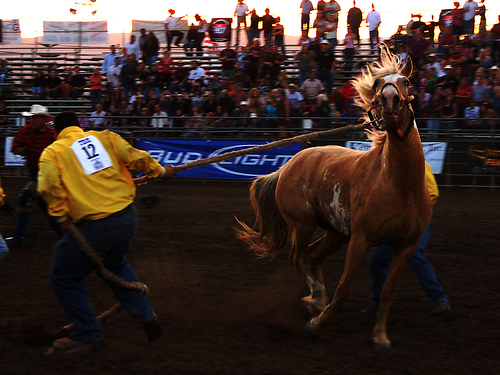

source    : this is a man dressed in yellow holding the reign of a brown horse
reference : das ist ein gelb gekleideter mann , der ein braunes pferd an der leine hält .
bert      : dies ist ein gelb gekleideter mann , der die aufmerksamkeit eines braunen pferds hält . (bleu=41.429, bleu1=60.000, bleu4=33.333)
           (this is a yellow dressed man holding the attention of a brown horse.)
lxmert    : dies ist ein mann in gelb gekleidet , der einen braunen pferd hält . (bleu=9.438, bleu1=64.286, bleu4=2.273)
           (this is a man dressed in yellow holding a brown horse.)
--------------------------------------------------------------------------------
ID 491


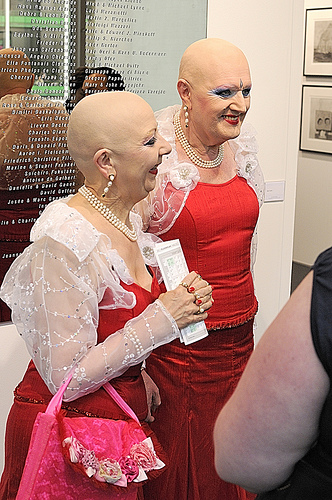

source    : two bald drag queens in red dresses
reference : zwei glatzköpfige drag queens in roten kleidern .
bert      : zwei glatzköpfige fußballer in roten kleidern . (bleu=42.384, bleu1=85.714, bleu4=25.000)
           (two bald soccer players in red dresses .)
lxmert    : zwei glatzköpfige , die rote kleider tragen , sind in roten kleidern unterwegs . (bleu=13.912, bleu1=42.857, bleu4=4.545)
           (two bald men wearing red dresses are traveling in red dresses.)
--------------------------------------------------------------------------------
ID 678


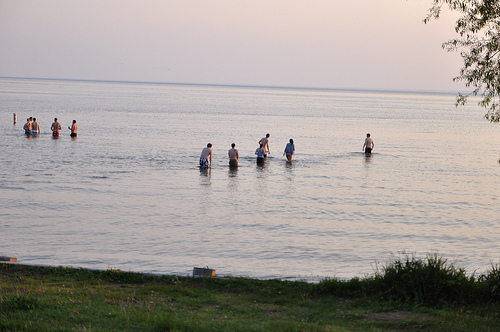

source    : two groups of swimmers wade out .
reference : zwei gruppen von schwimmern waten ins wasser .
bert      : zwei gruppen von schwimmern , die aus fischen . (bleu=31.560, bleu1=55.556, bleu4=16.667)
           (two groups of swimmers made of fish.)
lxmert    : zwei schwimmer waten durch seichtes . (bleu=7.654, bleu1=50.000, bleu4=4.167)
           (two swimmers wade through shallow .)
--------------------------------------------------------------------------------
ID 938


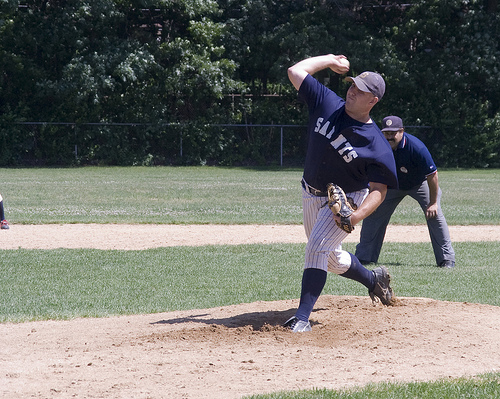

source    : a right @-@ handed pitcher for the saints is throwing a pitch .
reference : ein rechtshändiger pitcher der saints wirft einen ball .
bert      : ein baseballwerfer wirft einen ball . (bleu=32.588, bleu1=83.333, bleu4=33.333)
           (a baseball pitcher throws a ball .)
lxmert    : ein pitcher wirft einen pitch nach dem wurf des balls . (bleu=9.425, bleu1=45.455, bleu4=3.125)
           (a pitcher throws a pitch after the ball is thrown .)
--------------------------------------------------------------------------------
ID 981


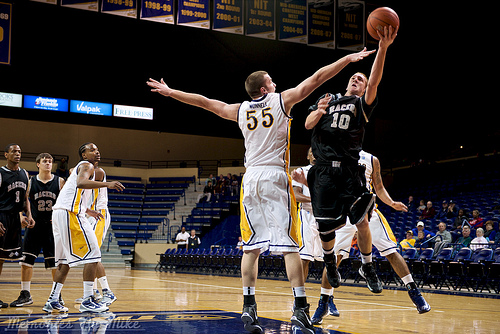

source    : the basketball player in the white uniform with the number 55 on it is guarding the player in the black uniform with the number 10 on it .
reference : der basketballspieler im weißen trikot mit der nummer 55 deckt den spieler im schwarzen trikot mit der nummer 10.
bert      : der basketballspieler im weißen trikot mit der nummer 10 ist auf dem boden , ein spieler in einem schwarzen trikot mit der zahl 5 darauf . (bleu=41.257, bleu1=57.692, bleu4=30.435)
           (the basketball player in the white jersey with the number 10 is on the floor , a player in a black jersey with the number 5 on it .)
lxmert    : der basketballspieler in dem weißen trikot mit der nummer 11 ist kurz davor den spieler in einem schwarzen trikot zu blocken . (bleu=23.147, bleu1=54.545, bleu4=10.526)
           (the basketball player in the white jersey with the number 11 is about to block the player in a black jersey .)
--------------------------------------------------------------------------------


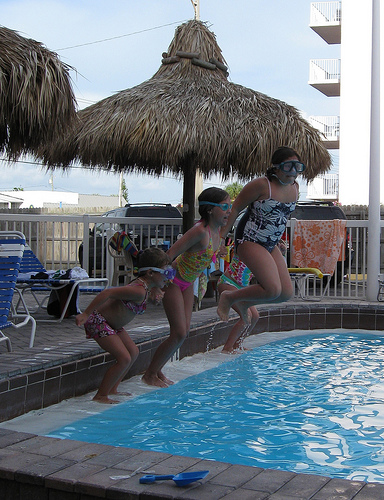

source    : children jump off the edge into a pool .
reference : kinder springen vom rand in einen pool .
bert      : kinder springen von den rand in einen pool . (bleu=51.335, bleu1=77.778, bleu4=33.333)
           (kinder springen von den rand in einen pool .)
lxmert    : kinder springen von der kante in einen pool . (bleu=35.495, bleu1=66.667, bleu4=16.667)
           (children jumping from the edge into a pool .)
--------------------------------------------------------------------------------
ID 570


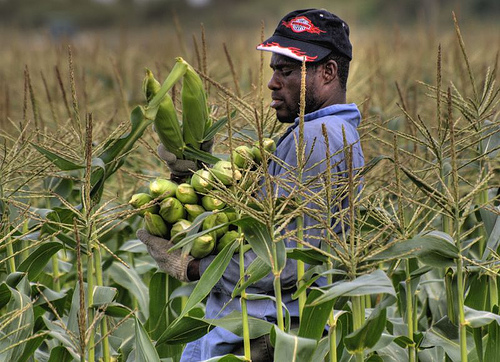

source    : a man wearing gloves carries corn through a field .
reference : ein mann mit handschuhen trägt mais durch ein feld .
bert      : ein mann mit handschuhen trägt steine durch ein feld . (bleu=65.804, bleu1=90.000, bleu4=42.857)
           (a man with gloves carries stones through a field .)
lxmert    : ein mann mit handschuhen trägt getreide über ein feld . (bleu=52.538, bleu1=80.000, bleu4=28.571)
           (a man with gloves carries grain across a field .)
--------------------------------------------------------------------------------
ID 688


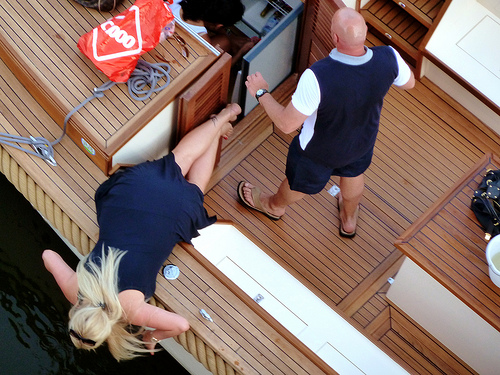

source    : two people are spending good time in their boat .
reference : zwei personen vergnügen sich auf ihrem boot .
bert      : zwei personen amüsieren sich in ihrem boot . (bleu=27.054, bleu1=75.000, bleu4=10.000)
           (two people having fun in their boat .)
lxmert    : zwei personen haben spaß in ihrem boot miteinander . (bleu=14.259, bleu1=55.556, bleu4=4.167)
           (two people have fun in their boat with each other .)
--------------------------------------------------------------------------------
ID 413


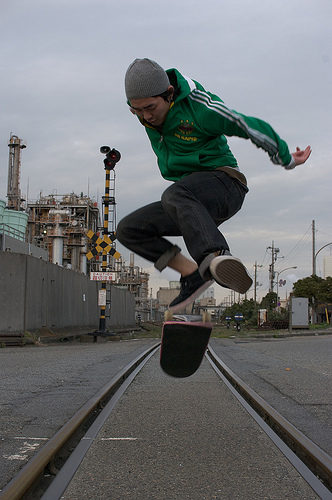

source    : a boy with a skateboard if jumping in the air along some railway tracks .
reference : ein junge auf einem skateboard springt neben eisenbahnschienen in die luft .
bert      : ein junge mit einem skateboard springt bei einigen bahngleisen in die luft . (bleu=31.171, bleu1=69.231, bleu4=10.000)
           (a boy with a skateboard jumps into the air at some railroad tracks .)
lxmert    : ein junge mit einem skateboard springt in die luft an ein paar bahngleisen entlang . (bleu=19.252, bleu1=60.000, bleu4=4.167)
           (a boy with a skateboard jumps into the air along some railroad tracks .)
--------------------------------------------------------------------------------
ID 86


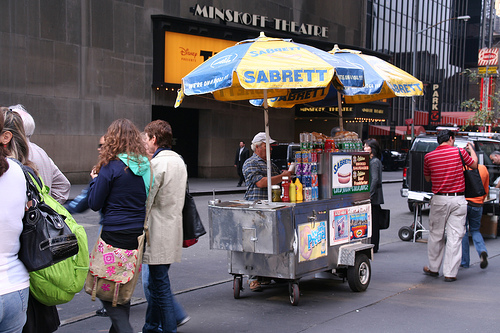

source    : a man is working a hotdog stand .
reference : ein mann arbeitet an einem hotdog @-@ stand .
bert      : ein mann arbeitet an einem hotdog . (bleu=47.487, bleu1=100.000, bleu4=75.000)
           (a man working on a hotdog .)
lxmert    : ein mann arbeitet an einem imbissstand . (bleu=36.337, bleu1=85.714, bleu4=50.000)
           (a man works at a bite stand .)
--------------------------------------------------------------------------------
ID 374


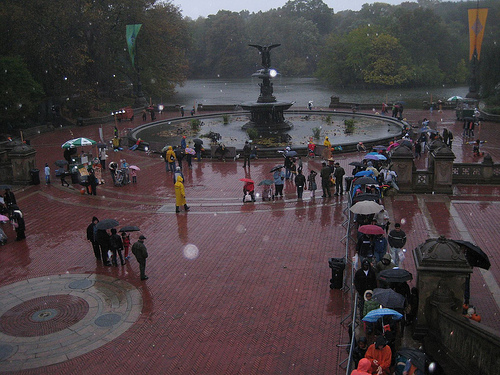

source    : a crowd gathered around a park water fountain in the rain .
reference : eine menschenmenge hat sich im regen um einen springbrunnen im park versammelt .
bert      : eine menschenmenge hat sich im regen um einen springbrunnen versammelt . (bleu=70.970, bleu1=100.000, bleu4=75.000)
           (a crowd has gathered in the rain around a fountain .)
lxmert    : eine menschenmenge hat sich im regen um einen brunnen versammelt . (bleu=61.860, bleu1=90.909, bleu4=62.500)
           (a crowd has gathered in the rain around a fountain .)
--------------------------------------------------------------------------------
ID 239


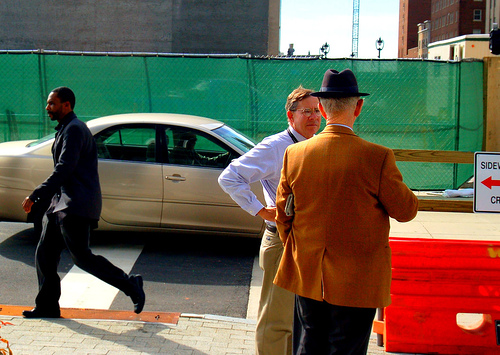

source    : two men stop to chat on the sidewalk as a car passes by .
reference : zwei männer unterhalten sich auf dem gehsteig während ein auto vorbeifährt .
bert      : zwei männer halten auf dem gehweg an , während ein auto vorbeifährt . (bleu=37.069, bleu1=69.231, bleu4=20.000)
           (two men stop on the sidewalk while a car drives by.)
lxmert    : zwei männer halten an , um auf dem bürgersteig zu unterhalten , während ein auto vorbeifährt . (bleu=28.176, bleu1=58.824, bleu4=14.286)
           (two men stop to talk on the sidewalk while a car drives by .)
--------------------------------------------------------------------------------
ID 109


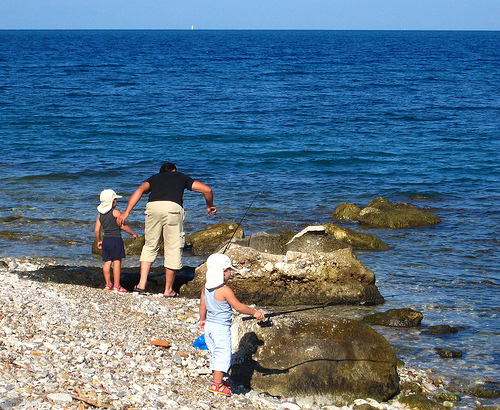

source    : a mother teaches her two young boys to fish off of a rocky coast into very blue water .
reference : eine mutter bringt ihren zwei kleinen söhnen an einer felsigen küste mit sehr blauem wasser das angeln bei .
bert      : eine mutter bringt ihren kleinen jungen an , um von einer felsigen anlegestelle in sehr blauen wasser zu fischen . (bleu=16.586, bleu1=55.000, bleu4=5.882)
           (a mother brings her little boy to fish from a rocky jetty in very blue water.)
lxmert    : eine mutter hilft zwei kleinen jungen beim fischen von einer felsigen anlegestelle in sehr blauen wasser . (bleu=7.794, bleu1=52.941, bleu4=1.786)
           (a mother helps two young boys fish from a rocky jetty in very blue water .)
--------------------------------------------------------------------------------
ID 15


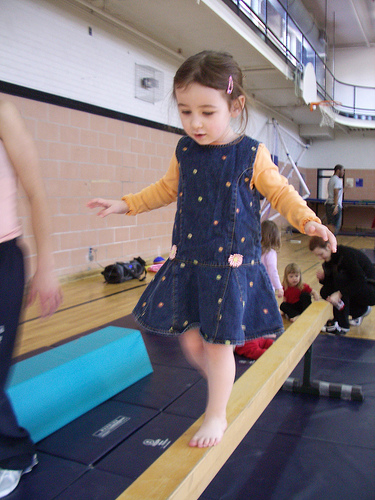

source    : a girl in a jean dress is walking along a raised balance beam .
reference : ein mädchen in einem jeanskleid läuft über einen erhöhten schwebebalken .
bert      : ein mädchen in einem jeans geht einen dekorativen balken entlang . (bleu=25.965, bleu1=54.545, bleu4=12.500)
           (a girl in a jeans walks along a decorative beam .)
lxmert    : ein mädchen in jeans läuft auf einem schwebebalken . (bleu=19.438, bleu1=77.778, bleu4=8.333)
           (girl in jeans walking on a balance beam .)
--------------------------------------------------------------------------------
ID 950


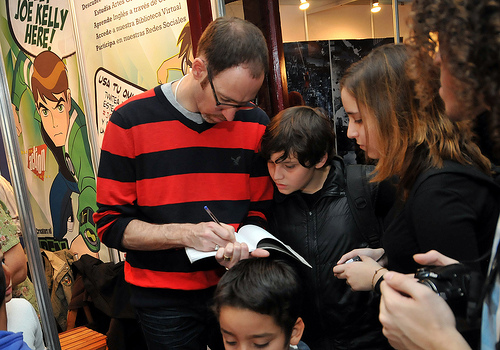

source    : a man signs an autograph in a young boy &apos;s book .
reference : ein mann schreibt einem kleinen jungen ein autogramm ins buch .
bert      : ein mann schildern in einem kleinen jungen ein buch . (bleu=32.117, bleu1=80.000, bleu4=14.286)
           (a man depict in a little boy a book .)
lxmert    : ein mann , der in einem kleinen jungen ein buch macht . (bleu=27.092, bleu1=66.667, bleu4=11.111)
           (a man who makes a book in a little boy.)
--------------------------------------------------------------------------------
ID 253


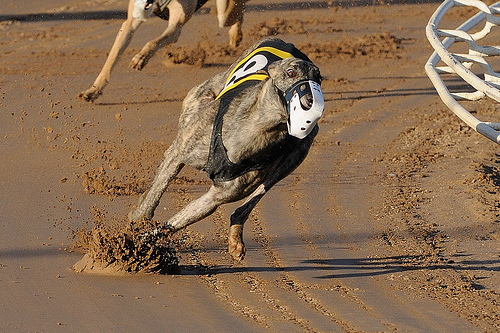

source    : a muzzled greyhound dog wearing yellow and black is running on the track .
reference : ein windhund mit maulkorb in gelb und schwarz läuft auf der strecke .
bert      : ein windhund mit maulkorb und schwarzer kleidung läuft auf der rennstrecke . (bleu=30.039, bleu1=75.000, bleu4=11.111)
           (a greyhound with muzzle and black clothes runs on the race track .)
lxmert    : ein windhund mit maulkorb , der gelb und schwarz trägt , rennt auf der rennstrecke . (bleu=25.337, bleu1=62.500, bleu4=7.692)
           (a greyhound with muzzle , wearing yellow and black , running on the racetrack .)
--------------------------------------------------------------------------------
ID 773


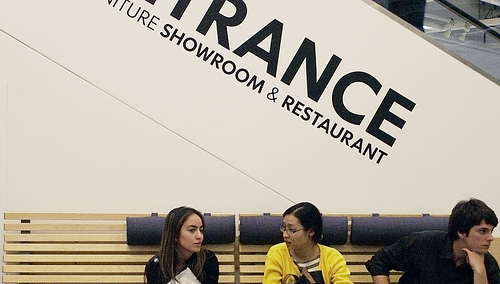

source    : the lady wearing black rimmed glasses and a yellow sweater jacket looks confused as she sits on the tan covered bench .
reference : die dame mit der schwarz gerahmten brille und der gelben sweatjacke blickt verwirrt während sie auf der braunen bank sitzt .
bert      : die dame mit schwarzer reflektierender brille und gelber jacke sitzt auf der braunen bank und sieht aufgeregt aus . (bleu=19.333, bleu1=57.895, bleu4=6.250)
           (the lady with black reflective glasses and yellow jacket sits on the brown bench and looks excited .)
lxmert    : die dame , die eine schwarze brille und eine gelbe jacke trägt , sitzt auf der braunen bank und schaut nach vorn . (bleu=14.728, bleu1=43.478, bleu4=5.000)
           (the lady wearing black glasses and a yellow jacket sits on the brown bench and looks forward.)
--------------------------------------------------------------------------------
ID 873


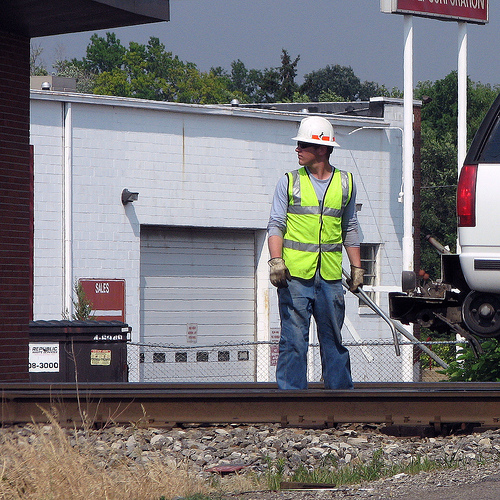

source    : a man wearing a gray shirt , blue jeans and a neon green safety vest is standing on a railroad track with a white truck and a white building in the background .
reference : ein mann mit einem grauen shirt , blauen jeans und neongrüner sicherheitsweste steht mit einem weißen lieferwagen und einem weißen gebäude im hintergrund auf einer bahnstrecke .
bert      : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw und einem weißen lkw im hintergrund . (bleu=21.282, bleu1=75.000, bleu4=4.000)
           (a man in a gray shirt , blue jeans and a green safety vest stands on a runway with a white truck and a white truck in the background .)
lxmert    : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw im hintergrund . (bleu=18.931, bleu1=75.000, bleu4=4.762)
           (a man in a gray shirt , blue jeans and a green safety vest stands 

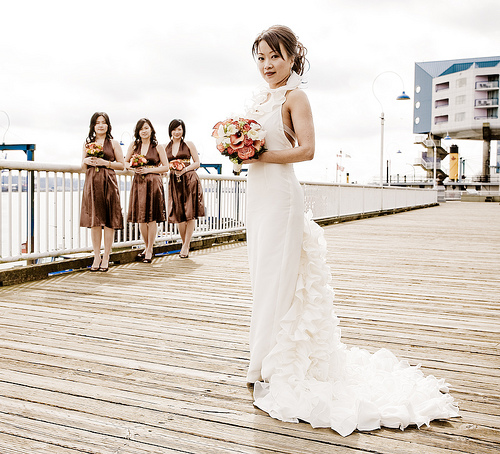

source    : an asian woman in a floral wedding dress poses on a bridge close to her bridesmaids .
reference : eine asiatische frau in einem hochzeitskleid mit blumenmuster posiert mit ihren brautjungfern auf einer brücke .
bert      : eine asiatische frau in einem blumenkleid posiert auf einer brücke in der nähe ihrer brautjungfern . (bleu=33.158, bleu1=68.750, bleu4=15.385)
           (an asian woman in a flower dress poses on a bridge near her bridesmaids .)
lxmert    : eine asiatische frau in einem geblümten kleid posiert auf einer brücke in der nähe ihrer brautjungfern . (bleu=31.007, bleu1=64.706, bleu4=14.286)
           (an asian woman in a flowered dress poses on a bridge near her bridesmaids .)
--------------------------------------------------------------------------------
ID 269


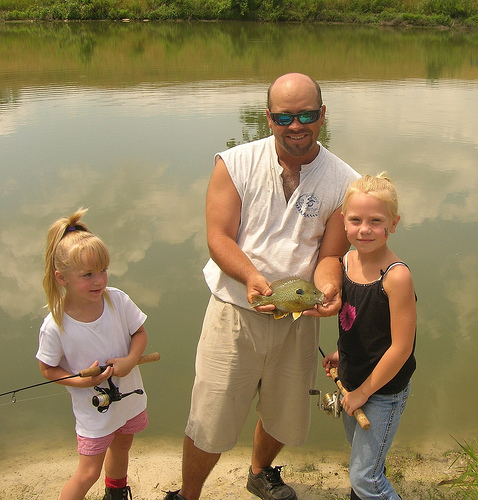

source    : a man and two girls show off a fish while holding fishing poles in front of a body of water .
reference : ein mann und zwei mädchen mit angelruten vor einem gewässer halten einen fisch hoch .
bert      : ein mann und zwei mädchen zeigen eine angel und halten angelruten vor einem gewässer . (bleu=43.332, bleu1=73.333, bleu4=25.000)
           (a man and two girls show a fishing and hold fishing rods in front of a body of water .)
lxmert    : ein mann und zwei mädchen zeigen auf einem fisch und halten angelruten vor einem gewässer . (bleu=41.212, bleu1=75.000, bleu4=23.077)
           (a man and two girls pointing at a fish and holding fishing rods in front of a body of water .)
--------------------------------------------------------------------------------
ID 351


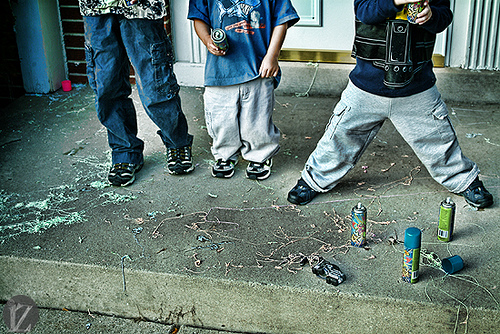

source    : three children &apos;s legs are shown as they stand near a mess of silly string .
reference : die beine von drei kindern , die neben einem durcheinander verknoteter fäden stehen .
bert      : drei kinder stehen in der nähe von einem stapel seil , während sie an der beine stehen . (bleu=5.875, bleu1=38.889, bleu4=1.667)
           (three children standing near a stack of rope while standing on the legs.)
lxmert    : drei kinder stehen in der nähe einer reihe von erwachsenen erwachsenen . (bleu=4.054, bleu1=33.333, bleu4=1.389)
           (three children standing near a row of grown adults .)
--------------------------------------------------------------------------------
ID 973


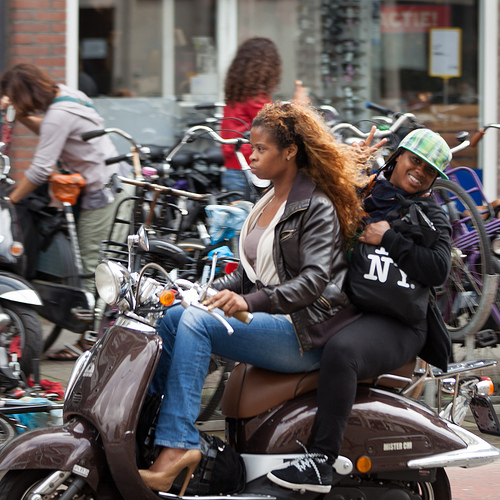

source    : two african american females ride on a moped down a city street that appears to be in a well congested area of a large city area .
reference : zwei afroamerikanische frauen fahren auf einem moped auf einer städtischen straße , die sich anscheinend in einem großstadtgebiet mit stau befindet .
bert      : zwei afroamerikanische frauen fahren auf einem moped eine straße in einer großstadt , die anscheinend einer großen stadt zu sein scheint . (bleu=32.506, bleu1=63.636, bleu4=21.053)
           (two african american women ride a moped down a street in what appears to be a large city.)
lxmert    : zwei afroamerikanische frauen fahren auf einem moped eine straße in der stadt entlang , die anscheinend einer großen stadt zu sein scheint . (bleu=30.989, bleu1=60.870, bleu4=20.000)
           (two african american women ride a moped down a city street that appears to be a large city.)
--------------------------------------------------------------------------------
ID 393


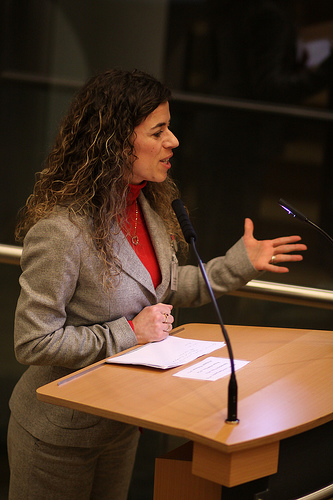

source    : a professionally dressed woman standing at a podium debating or discussing something of importance .
reference : eine professionell gekleidete frau steht an einem podium und debattiert oder diskutiert über etwas wichtiges .
bert      : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert und diskutieren etwas . (bleu=37.751, bleu1=85.714, bleu4=27.273)
           (a colorfully dressed woman is standing at a podium or discussing and debating something .)
lxmert    : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert etwas . (bleu=36.409, bleu1=91.667, bleu4=33.333)
           (a colorfully dressed woman stands at a podium or discusses something .)
--------------------------------------------------------------------------------
ID 257


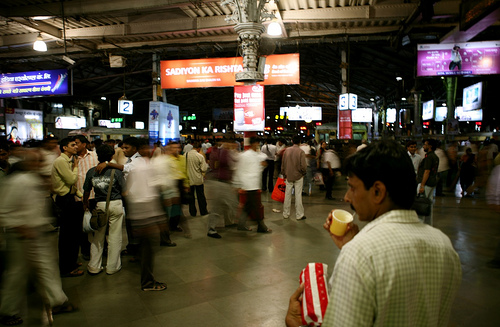

source    : a man drinking out of a yellow cup around people at a busy event
reference : ein mann , der aus einer gelben tasse trinkt , umgeben von menschen auf einer geschäftigen veranstaltung .
bert      : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse um die menschen herum . (bleu=18.697, bleu1=68.750, bleu4=7.692)
           (a man drinks from a yellow cup around people at a busy event .)
lxmert    : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse . (bleu=17.375, bleu1=83.333, bleu4=11.111)
           (a man drinks from a yellow cup at a busy event .)
--------------------------------------------------------------------------------
ID 481


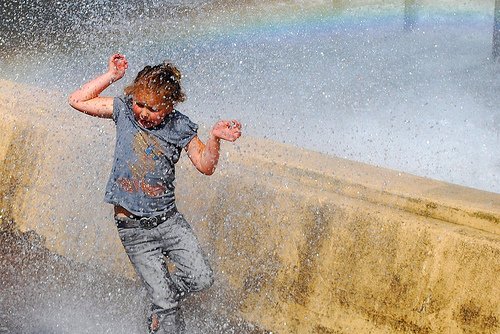

source    : a girl is playing in the fountain fully clothed .
reference : ein mädchen spielt komplett bekleidet im springbrunnen .
bert      : ein mädchen spielt im brunnen und hölle . (bleu=23.357, bleu1=62.500, bleu4=10.000)
           (a girl plays in the well and hell .)
lxmert    : ein mädchen spielt in der wasserfontäne . (bleu=22.772, bleu1=57.143, bleu4=12.500)
           (a girl plays in the water fountain .)
--------------------------------------------------------------------------------
ID 665


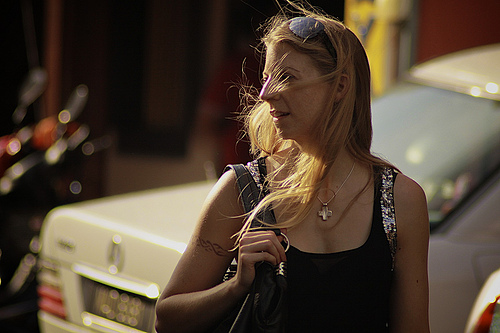

source    : a woman wearing a black tank top and a cross necklace stares off into the distance near sunset .
reference : eine frau in einem schwarzen tank @-@ top mit einem kreuz @-@ halsband blickt kurz vor sonnenuntergang in die ferne .
bert      : eine frau in einem schwarzen tanktop und mit einer halskette blickt in die ferne . (bleu=22.247, bleu1=73.333, bleu4=25.000)
           (a woman in a black tank top and with a necklace looks into the distance .)
lxmert    : eine frau in einem schwarzen oberteil und mit einer halskette starrt in die ferne . (bleu=21.724, bleu1=66.667, bleu4=25.000)
           (a woman in a black top and with a necklace stares into the distance .)
--------------------------------------------------------------------------------
ID 376


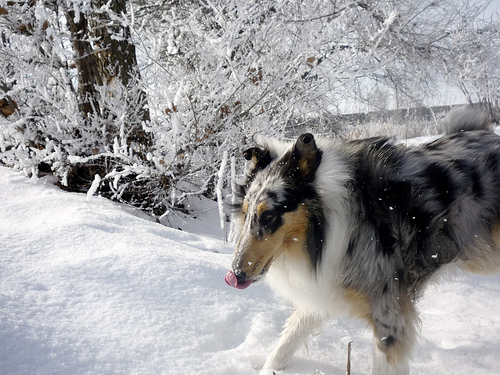

source    : a young lassie looking dog is in the snow .
reference : ein junger hund , der aussieht wie lassie , im schnee .
bert      : ein kleiner terrier aussehender hund ist im schnee . (bleu=14.449, bleu1=55.556, bleu4=8.333)
           (a small terrier looking dog is in the snow .)
lxmert    : ein kleiner gefleckter hund ist im schnee . (bleu=14.167, bleu1=62.500, bleu4=10.000)
           (a small spotted dog is in the snow .)
--------------------------------------------------------------------------------
ID 92


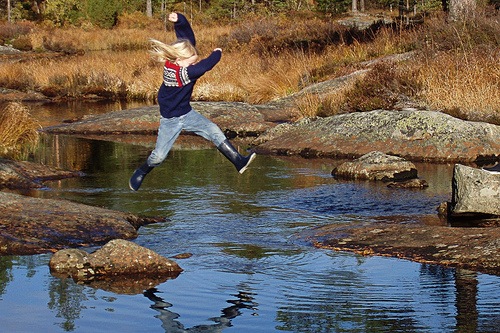

source    : a girl hops across the river , from rock to rock .
reference : ein mädchen springt von fels zu fels über den bach .
bert      : ein mädchen taucht von einem felsen über den fluss . (bleu=11.885, bleu1=60.000, bleu4=3.571)
           (a girl dives from a rock across the river .)
lxmert    : ein mädchen taucht von einem felsen aus über den fluss . (bleu=11.731, bleu1=54.545, bleu4=3.125)
           (a girl dives from a rock across the river .)
--------------------------------------------------------------------------------


In [256]:
delta_bleu_bw_bert_lxmert = df[[
    'image_url','src','ref',
    'hyp_bert','hyp_lxmert','hyp-en_bert','hyp-en_lxmert',
    'reversal_bert_to_lxmert', 'bleu_bert','bleu_lxmert',
    'bleu1_bert','bleu1_lxmert', 'bleu2_bert','bleu2_lxmert',
    'bleu3_bert','bleu3_lxmert', 'bleu4_bert','bleu4_lxmert']].copy(deep=True)
delta_bleu_bw_bert_lxmert['delta-bleu'] = delta_bleu_bw_bert_lxmert['bleu_bert'] - delta_bleu_bw_bert_lxmert['bleu_lxmert']
show_samples(delta_bleu_bw_bert_lxmert[delta_bleu_bw_bert_lxmert['reversal_bert_to_lxmert']].sort_values('delta-bleu', ascending=False), 
             target_models=['bert','lxmert'], 
             disp_attr=['bleu', 'bleu1', 'bleu4'])

#### sort by ppl

ID 678


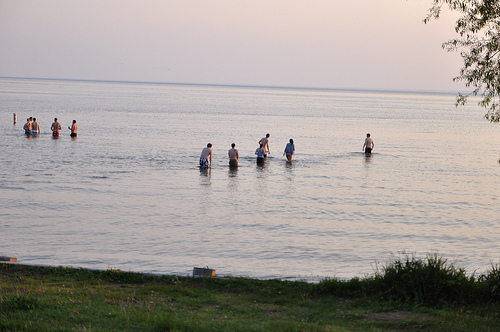

source    : two groups of swimmers wade out .
reference : zwei gruppen von schwimmern waten ins wasser .
bert      : zwei gruppen von schwimmern , die aus fischen . (ppl=6.36943420589746)
           (two groups of swimmers made of fish.)
lxmert    : zwei schwimmer waten durch seichtes . (ppl=29.477300735599922)
           (two swimmers wade through shallow .)
--------------------------------------------------------------------------------
ID 688


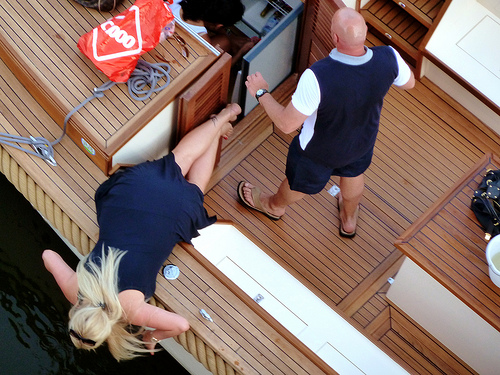

source    : two people are spending good time in their boat .
reference : zwei personen vergnügen sich auf ihrem boot .
bert      : zwei personen amüsieren sich in ihrem boot . (ppl=9.41931236686381)
           (two people having fun in their boat .)
lxmert    : zwei personen haben spaß in ihrem boot miteinander . (ppl=29.4294793230279)
           (two people have fun in their boat with each other .)
--------------------------------------------------------------------------------
ID 269


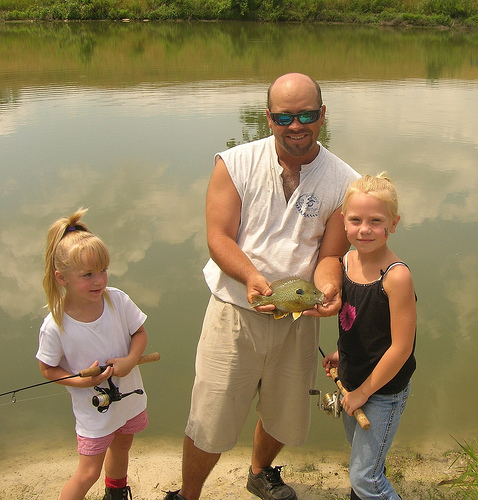

source    : a man and two girls show off a fish while holding fishing poles in front of a body of water .
reference : ein mann und zwei mädchen mit angelruten vor einem gewässer halten einen fisch hoch .
bert      : ein mann und zwei mädchen zeigen eine angel und halten angelruten vor einem gewässer . (ppl=24.15474655563144)
           (a man and two girls show a fishing and hold fishing rods in front of a body of water .)
lxmert    : ein mann und zwei mädchen zeigen auf einem fisch und halten angelruten vor einem gewässer . (ppl=23.230312125827812)
           (a man and two girls pointing at a fish and holding fishing rods in front of a body of water .)
--------------------------------------------------------------------------------
ID 481


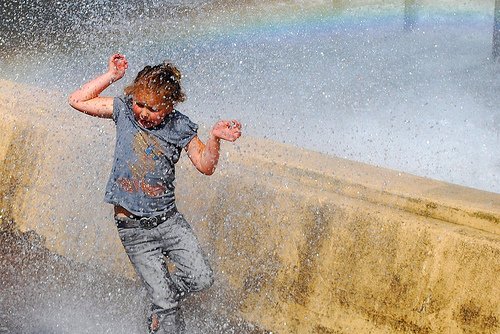

source    : a girl is playing in the fountain fully clothed .
reference : ein mädchen spielt komplett bekleidet im springbrunnen .
bert      : ein mädchen spielt im brunnen und hölle . (ppl=133.86157452536779)
           (a girl plays in the well and hell .)
lxmert    : ein mädchen spielt in der wasserfontäne . (ppl=22.79713422550966)
           (a girl plays in the water fountain .)
--------------------------------------------------------------------------------
ID 86


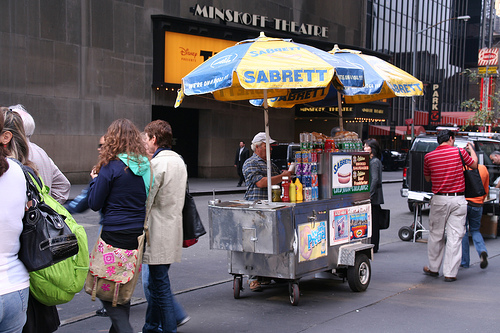

source    : a man is working a hotdog stand .
reference : ein mann arbeitet an einem hotdog @-@ stand .
bert      : ein mann arbeitet an einem hotdog . (ppl=12.276110570188154)
           (a man working on a hotdog .)
lxmert    : ein mann arbeitet an einem imbissstand . (ppl=17.090510841089422)
           (a man works at a bite stand .)
--------------------------------------------------------------------------------
ID 211


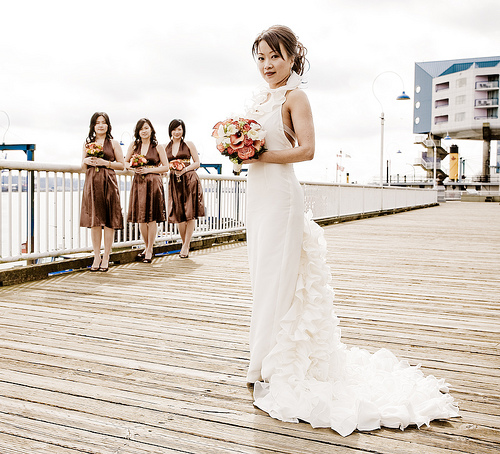

source    : an asian woman in a floral wedding dress poses on a bridge close to her bridesmaids .
reference : eine asiatische frau in einem hochzeitskleid mit blumenmuster posiert mit ihren brautjungfern auf einer brücke .
bert      : eine asiatische frau in einem blumenkleid posiert auf einer brücke in der nähe ihrer brautjungfern . (ppl=7.520527630519445)
           (an asian woman in a flower dress poses on a bridge near her bridesmaids .)
lxmert    : eine asiatische frau in einem geblümten kleid posiert auf einer brücke in der nähe ihrer brautjungfern . (ppl=11.530801748795735)
           (an asian woman in a flowered dress poses on a bridge near her bridesmaids .)
--------------------------------------------------------------------------------
ID 950


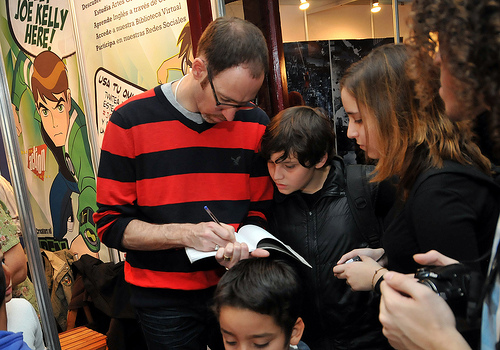

source    : a man signs an autograph in a young boy &apos;s book .
reference : ein mann schreibt einem kleinen jungen ein autogramm ins buch .
bert      : ein mann schildern in einem kleinen jungen ein buch . (ppl=32.54771034967789)
           (a man depict in a little boy a book .)
lxmert    : ein mann , der in einem kleinen jungen ein buch macht . (ppl=10.279364560139614)
           (a man who makes a book in a little boy.)
--------------------------------------------------------------------------------
ID 516


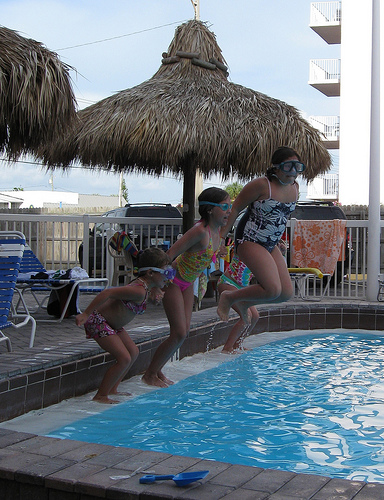

source    : children jump off the edge into a pool .
reference : kinder springen vom rand in einen pool .
bert      : kinder springen von den rand in einen pool . (ppl=46.16065489155335)
           (kinder springen von den rand in einen pool .)
lxmert    : kinder springen von der kante in einen pool . (ppl=9.84467598071789)
           (children jumping from the edge into a pool .)
--------------------------------------------------------------------------------
ID 257


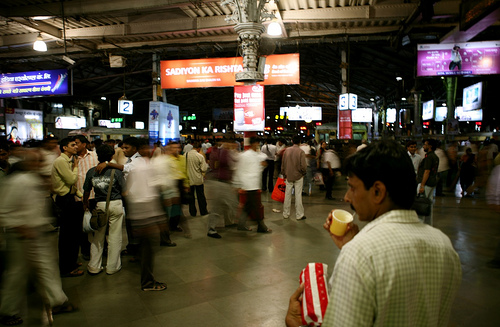

source    : a man drinking out of a yellow cup around people at a busy event
reference : ein mann , der aus einer gelben tasse trinkt , umgeben von menschen auf einer geschäftigen veranstaltung .
bert      : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse um die menschen herum . (ppl=8.230248587948477)
           (a man drinks from a yellow cup around people at a busy event .)
lxmert    : ein mann trinkt bei einer belebten veranstaltung aus einer gelben tasse . (ppl=9.3559718783868)
           (a man drinks from a yellow cup at a busy event .)
--------------------------------------------------------------------------------
ID 109


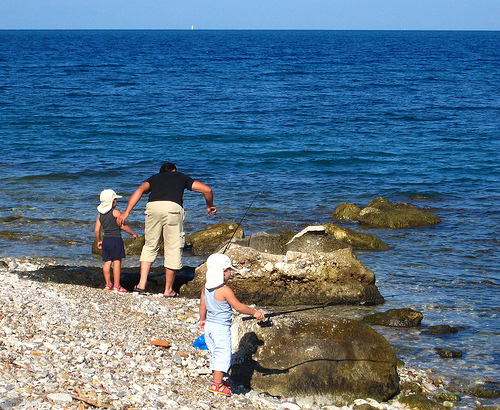

source    : a mother teaches her two young boys to fish off of a rocky coast into very blue water .
reference : eine mutter bringt ihren zwei kleinen söhnen an einer felsigen küste mit sehr blauem wasser das angeln bei .
bert      : eine mutter bringt ihren kleinen jungen an , um von einer felsigen anlegestelle in sehr blauen wasser zu fischen . (ppl=13.100800310822837)
           (a mother brings her little boy to fish from a rocky jetty in very blue water.)
lxmert    : eine mutter hilft zwei kleinen jungen beim fischen von einer felsigen anlegestelle in sehr blauen wasser . (ppl=8.868698180268636)
           (a mother helps two young boys fish from a rocky jetty in very blue water .)
--------------------------------------------------------------------------------
ID 239


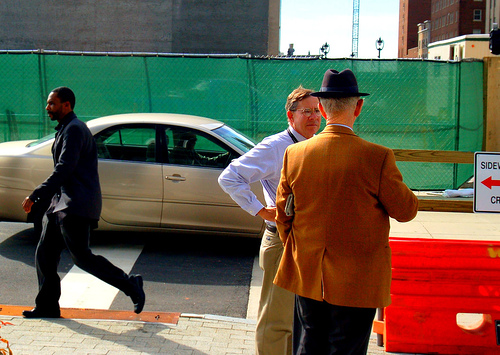

source    : two men stop to chat on the sidewalk as a car passes by .
reference : zwei männer unterhalten sich auf dem gehsteig während ein auto vorbeifährt .
bert      : zwei männer halten auf dem gehweg an , während ein auto vorbeifährt . (ppl=5.3767063135809225)
           (two men stop on the sidewalk while a car drives by.)
lxmert    : zwei männer halten an , um auf dem bürgersteig zu unterhalten , während ein auto vorbeifährt . (ppl=8.076387439948865)
           (two men stop to talk on the sidewalk while a car drives by .)
--------------------------------------------------------------------------------
ID 665


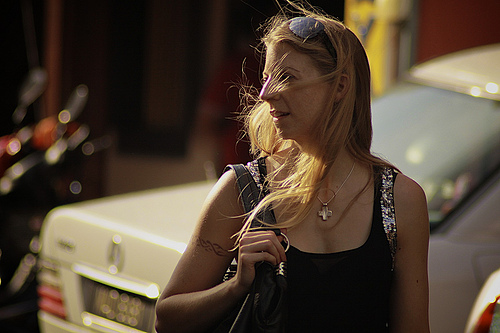

source    : a woman wearing a black tank top and a cross necklace stares off into the distance near sunset .
reference : eine frau in einem schwarzen tank @-@ top mit einem kreuz @-@ halsband blickt kurz vor sonnenuntergang in die ferne .
bert      : eine frau in einem schwarzen tanktop und mit einer halskette blickt in die ferne . (ppl=10.323891118143495)
           (a woman in a black tank top and with a necklace looks into the distance .)
lxmert    : eine frau in einem schwarzen oberteil und mit einer halskette starrt in die ferne . (ppl=6.90312640398806)
           (a woman in a black top and with a necklace stares into the distance .)
--------------------------------------------------------------------------------
ID 981


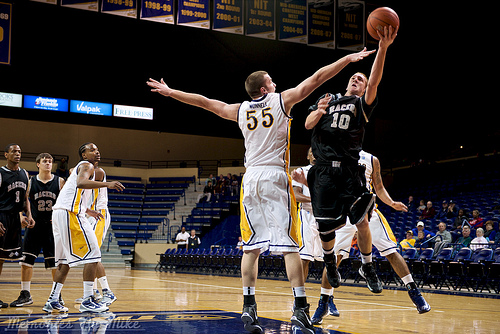

source    : the basketball player in the white uniform with the number 55 on it is guarding the player in the black uniform with the number 10 on it .
reference : der basketballspieler im weißen trikot mit der nummer 55 deckt den spieler im schwarzen trikot mit der nummer 10.
bert      : der basketballspieler im weißen trikot mit der nummer 10 ist auf dem boden , ein spieler in einem schwarzen trikot mit der zahl 5 darauf . (ppl=6.389144826948512)
           (the basketball player in the white jersey with the number 10 is on the floor , a player in a black jersey with the number 5 on it .)
lxmert    : der basketballspieler in dem weißen trikot mit der nummer 11 ist kurz davor den spieler in einem schwarzen trikot zu blocken . (ppl=6.649421241244623)
           (the basketball player in the white jersey with the number 11 is about to block the player in a black jersey .)
--------------------------------------------------------------------------------
ID 244


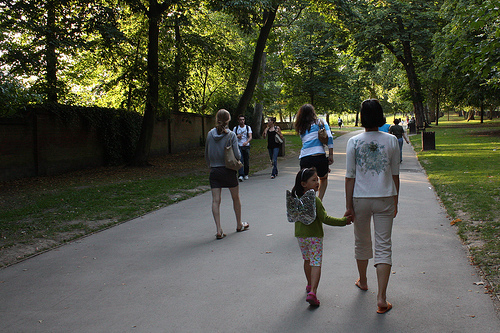

source    : people walking on a trail in a tree filled park .
reference : menschen gehen auf einem pfad in einem park voller bäume .
bert      : menschen gehen auf einem pfad in einem überdachten park . (ppl=7.094953283182987)
           (people walking on a path in a covered park .)
lxmert    : menschen gehen auf einem weg in einem park , der mit vielen bäumen bedeckt ist . (ppl=5.724706428737573)
           (people walking on a path in a park that is covered with many trees.)
--------------------------------------------------------------------------------
ID 393


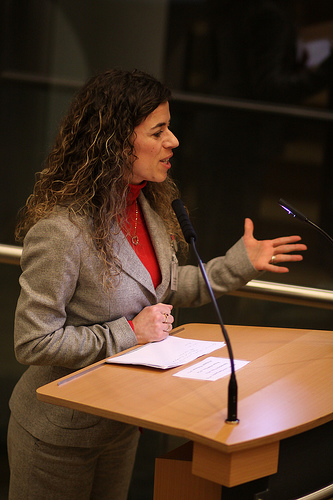

source    : a professionally dressed woman standing at a podium debating or discussing something of importance .
reference : eine professionell gekleidete frau steht an einem podium und debattiert oder diskutiert über etwas wichtiges .
bert      : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert und diskutieren etwas . (ppl=7.005844992834421)
           (a colorfully dressed woman is standing at a podium or discussing and debating something .)
lxmert    : eine farbenfroh gekleidete frau steht an einem podium oder diskutiert etwas . (ppl=5.057968922324766)
           (a colorfully dressed woman stands at a podium or discusses something .)
--------------------------------------------------------------------------------
ID 374


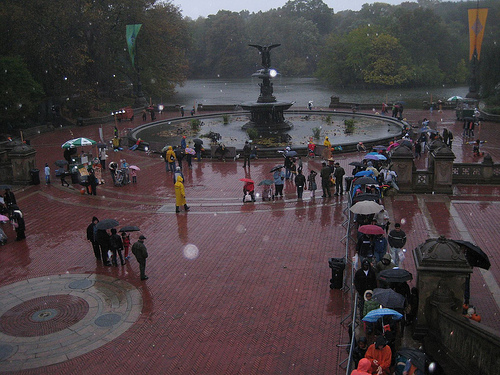

source    : a crowd gathered around a park water fountain in the rain .
reference : eine menschenmenge hat sich im regen um einen springbrunnen im park versammelt .
bert      : eine menschenmenge hat sich im regen um einen springbrunnen versammelt . (ppl=3.5249743222836982)
           (a crowd has gathered in the rain around a fountain .)
lxmert    : eine menschenmenge hat sich im regen um einen brunnen versammelt . (ppl=4.920277611405257)
           (a crowd has gathered in the rain around a fountain .)
--------------------------------------------------------------------------------
ID 570


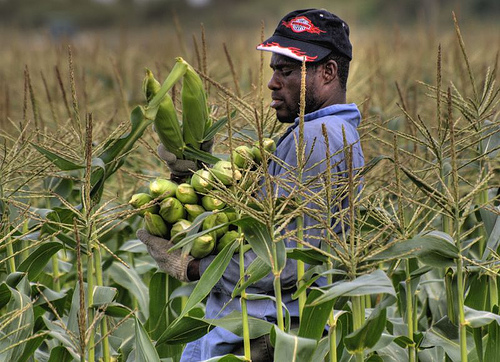

source    : a man wearing gloves carries corn through a field .
reference : ein mann mit handschuhen trägt mais durch ein feld .
bert      : ein mann mit handschuhen trägt steine durch ein feld . (ppl=6.025752230462662)
           (a man with gloves carries stones through a field .)
lxmert    : ein mann mit handschuhen trägt getreide über ein feld . (ppl=4.827126167157114)
           (a man with gloves carries grain across a field .)
--------------------------------------------------------------------------------
ID 873


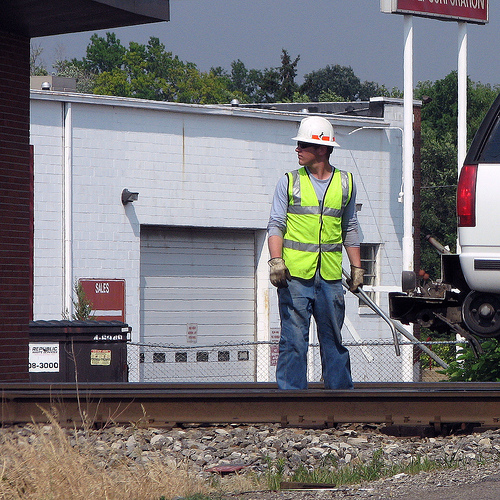

source    : a man wearing a gray shirt , blue jeans and a neon green safety vest is standing on a railroad track with a white truck and a white building in the background .
reference : ein mann mit einem grauen shirt , blauen jeans und neongrüner sicherheitsweste steht mit einem weißen lieferwagen und einem weißen gebäude im hintergrund auf einer bahnstrecke .
bert      : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw und einem weißen lkw im hintergrund . (ppl=3.837720895313957)
           (a man in a gray shirt , blue jeans and a green safety vest stands on a runway with a white truck and a white truck in the background .)
lxmert    : ein mann in einem grauen hemd , blauen jeans und einer grünen sicherheitsweste steht auf einer laufbahn mit einem weißen lkw im hintergrund . (ppl=4.580241116329564)
           (a man in a gray shirt , blue jeans and a green safety vest stands on a runway with a white truck in 

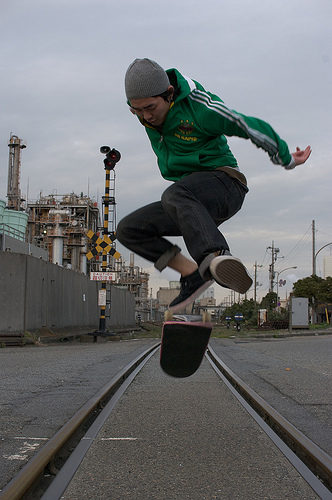

source    : a boy with a skateboard if jumping in the air along some railway tracks .
reference : ein junge auf einem skateboard springt neben eisenbahnschienen in die luft .
bert      : ein junge mit einem skateboard springt bei einigen bahngleisen in die luft . (ppl=3.862495939663162)
           (a boy with a skateboard jumps into the air at some railroad tracks .)
lxmert    : ein junge mit einem skateboard springt in die luft an ein paar bahngleisen entlang . (ppl=4.4001402041282365)
           (a boy with a skateboard jumps into the air along some railroad tracks .)
--------------------------------------------------------------------------------
ID 15


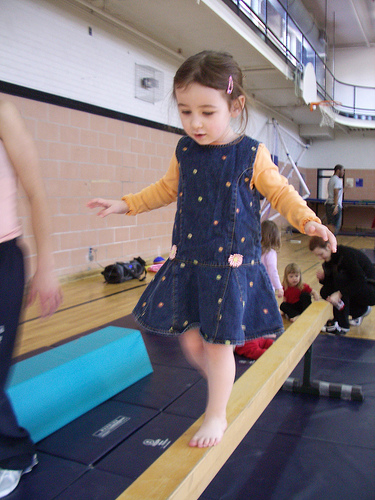

source    : a girl in a jean dress is walking along a raised balance beam .
reference : ein mädchen in einem jeanskleid läuft über einen erhöhten schwebebalken .
bert      : ein mädchen in einem jeans geht einen dekorativen balken entlang . (ppl=10.423044525260583)
           (a girl in a jeans walks along a decorative beam .)
lxmert    : ein mädchen in jeans läuft auf einem schwebebalken . (ppl=4.317765045909131)
           (girl in jeans walking on a balance beam .)
--------------------------------------------------------------------------------
ID 253


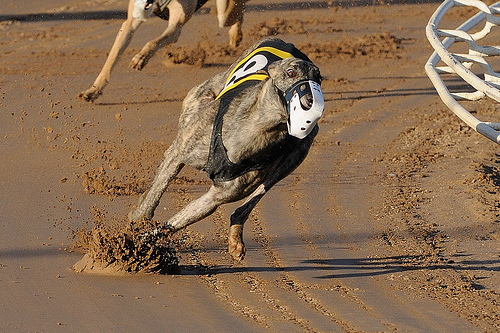

source    : a muzzled greyhound dog wearing yellow and black is running on the track .
reference : ein windhund mit maulkorb in gelb und schwarz läuft auf der strecke .
bert      : ein windhund mit maulkorb und schwarzer kleidung läuft auf der rennstrecke . (ppl=3.6257762877842783)
           (a greyhound with muzzle and black clothes runs on the race track .)
lxmert    : ein windhund mit maulkorb , der gelb und schwarz trägt , rennt auf der rennstrecke . (ppl=4.031277251051545)
           (a greyhound with muzzle , wearing yellow and black , running on the racetrack .)
--------------------------------------------------------------------------------
ID 491


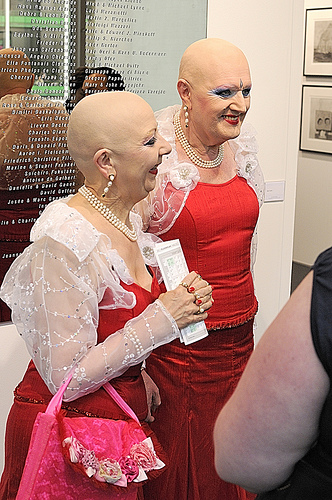

source    : two bald drag queens in red dresses
reference : zwei glatzköpfige drag queens in roten kleidern .
bert      : zwei glatzköpfige fußballer in roten kleidern . (ppl=4.875416942412857)
           (two bald soccer players in red dresses .)
lxmert    : zwei glatzköpfige , die rote kleider tragen , sind in roten kleidern unterwegs . (ppl=4.025342312669822)
           (two bald men wearing red dresses are traveling in red dresses.)
--------------------------------------------------------------------------------
ID 92


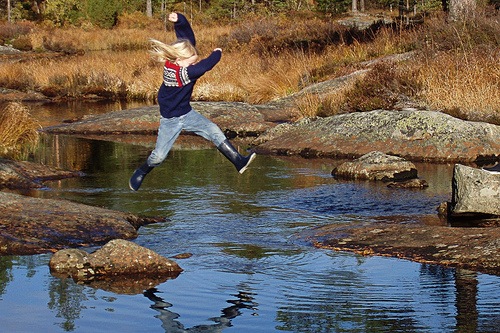

source    : a girl hops across the river , from rock to rock .
reference : ein mädchen springt von fels zu fels über den bach .
bert      : ein mädchen taucht von einem felsen über den fluss . (ppl=4.6007518031523285)
           (a girl dives from a rock across the river .)
lxmert    : ein mädchen taucht von einem felsen aus über den fluss . (ppl=4.023994616650221)
           (a girl dives from a rock across the river .)
--------------------------------------------------------------------------------
ID 938


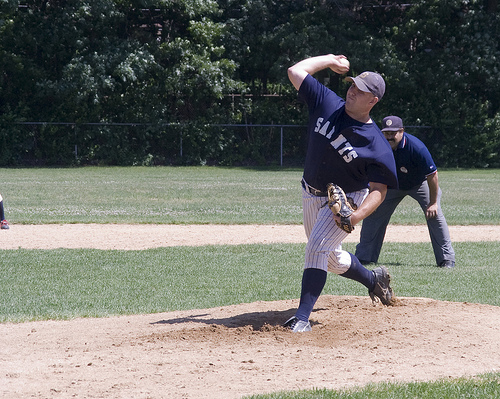

source    : a right @-@ handed pitcher for the saints is throwing a pitch .
reference : ein rechtshändiger pitcher der saints wirft einen ball .
bert      : ein baseballwerfer wirft einen ball . (ppl=5.820590128716856)
           (a baseball pitcher throws a ball .)
lxmert    : ein pitcher wirft einen pitch nach dem wurf des balls . (ppl=3.87645926103098)
           (a pitcher throws a pitch after the ball is thrown .)
--------------------------------------------------------------------------------
ID 973


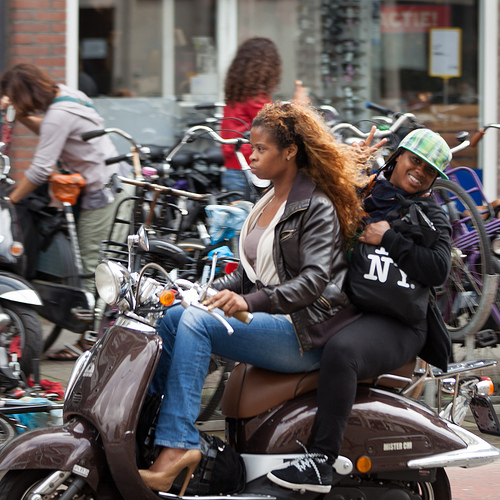

source    : two african american females ride on a moped down a city street that appears to be in a well congested area of a large city area .
reference : zwei afroamerikanische frauen fahren auf einem moped auf einer städtischen straße , die sich anscheinend in einem großstadtgebiet mit stau befindet .
bert      : zwei afroamerikanische frauen fahren auf einem moped eine straße in einer großstadt , die anscheinend einer großen stadt zu sein scheint . (ppl=3.646783891410036)
           (two african american women ride a moped down a street in what appears to be a large city.)
lxmert    : zwei afroamerikanische frauen fahren auf einem moped eine straße in der stadt entlang , die anscheinend einer großen stadt zu sein scheint . (ppl=3.593834529681789)
           (two african american women ride a moped down a city street that appears to be a large city.)
--------------------------------------------------------------------------------
ID 992


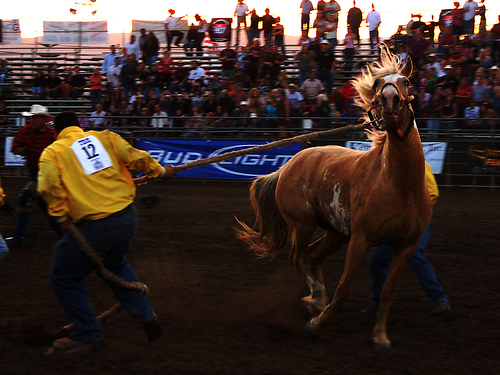

source    : this is a man dressed in yellow holding the reign of a brown horse
reference : das ist ein gelb gekleideter mann , der ein braunes pferd an der leine hält .
bert      : dies ist ein gelb gekleideter mann , der die aufmerksamkeit eines braunen pferds hält . (ppl=3.3142665465934806)
           (this is a yellow dressed man holding the attention of a brown horse.)
lxmert    : dies ist ein mann in gelb gekleidet , der einen braunen pferd hält . (ppl=3.4521964879831333)
           (this is a man dressed in yellow holding a brown horse.)
--------------------------------------------------------------------------------
ID 376


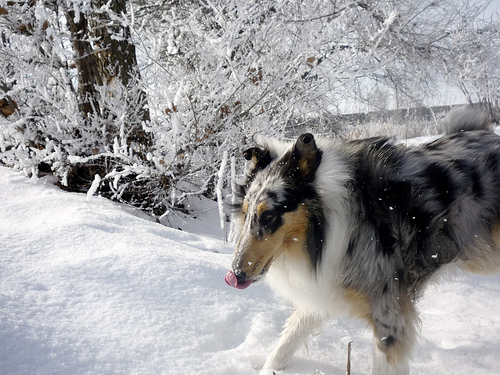

source    : a young lassie looking dog is in the snow .
reference : ein junger hund , der aussieht wie lassie , im schnee .
bert      : ein kleiner terrier aussehender hund ist im schnee . (ppl=3.327708664667428)
           (a small terrier looking dog is in the snow .)
lxmert    : ein kleiner gefleckter hund ist im schnee . (ppl=3.0052145088987188)
           (a small spotted dog is in the snow .)
--------------------------------------------------------------------------------
ID 773


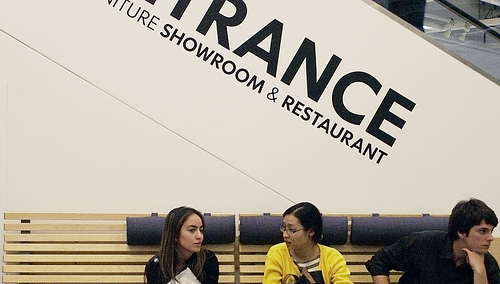

source    : the lady wearing black rimmed glasses and a yellow sweater jacket looks confused as she sits on the tan covered bench .
reference : die dame mit der schwarz gerahmten brille und der gelben sweatjacke blickt verwirrt während sie auf der braunen bank sitzt .
bert      : die dame mit schwarzer reflektierender brille und gelber jacke sitzt auf der braunen bank und sieht aufgeregt aus . (ppl=4.189762831198542)
           (the lady with black reflective glasses and yellow jacket sits on the brown bench and looks excited .)
lxmert    : die dame , die eine schwarze brille und eine gelbe jacke trägt , sitzt auf der braunen bank und schaut nach vorn . (ppl=2.6917512284715768)
           (the lady wearing black glasses and a yellow jacket sits on the brown bench and looks forward.)
--------------------------------------------------------------------------------
ID 351


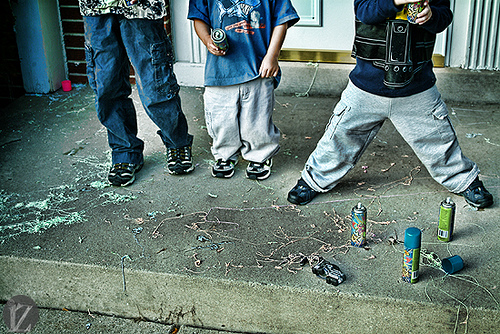

source    : three children &apos;s legs are shown as they stand near a mess of silly string .
reference : die beine von drei kindern , die neben einem durcheinander verknoteter fäden stehen .
bert      : drei kinder stehen in der nähe von einem stapel seil , während sie an der beine stehen . (ppl=10.316334902466524)
           (three children standing near a stack of rope while standing on the legs.)
lxmert    : drei kinder stehen in der nähe einer reihe von erwachsenen erwachsenen . (ppl=2.4928228174637552)
           (three children standing near a row of grown adults .)
--------------------------------------------------------------------------------


In [80]:
show_samples(df_reversal_bert_to_lxmert.sort_values('ppl_lxmert', ascending=False), target_models=['bert','lxmert'], disp_attr=['ppl'])

## LXMERT -> BERT

In [71]:
df_reversal_lxmert_to_bert = df[df['reversal_lxmert_to_bert']]
len(df_reversal_lxmert_to_bert)

49

### BLEU

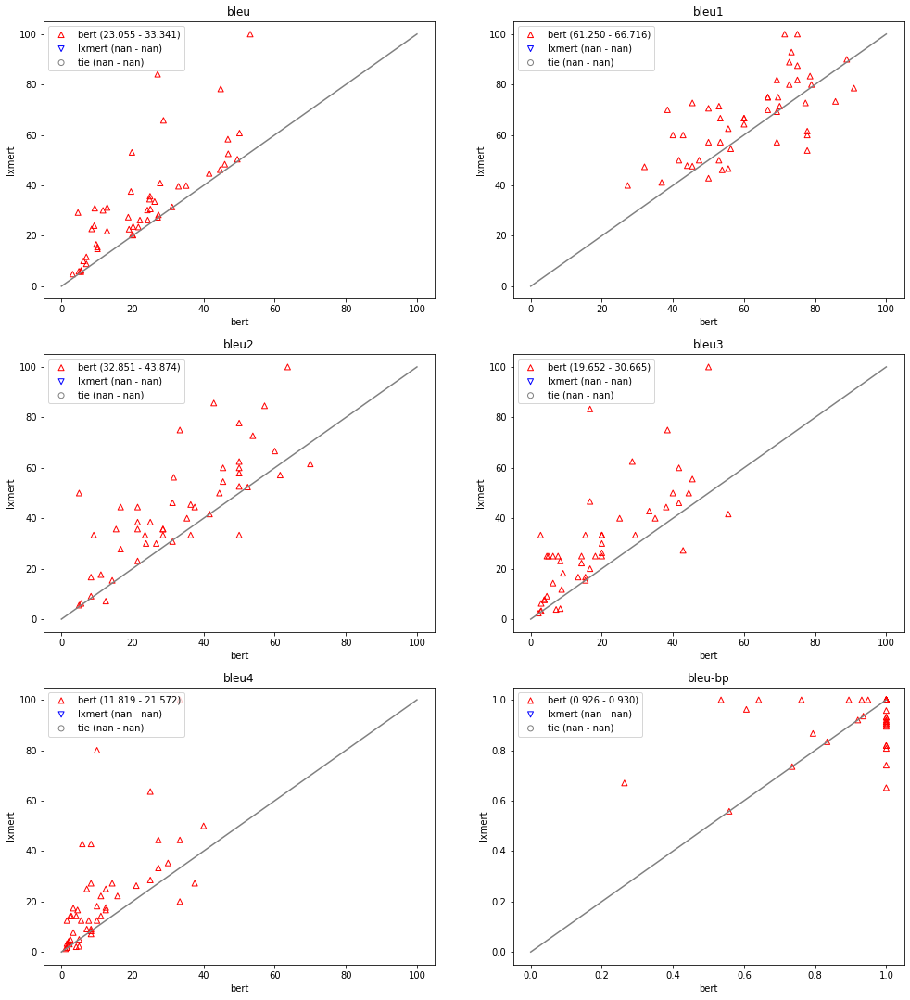

In [81]:
show_bleu_comparison(df_reversal_lxmert_to_bert,'bert', 'lxmert')

### ppl

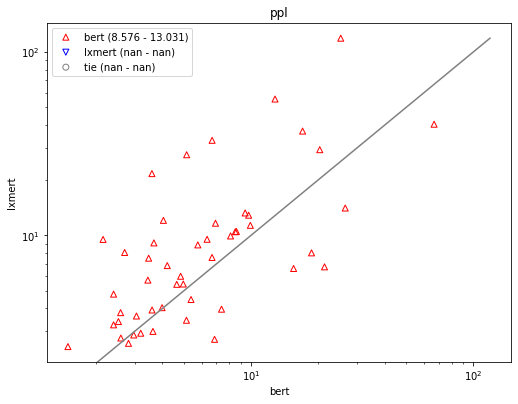

In [82]:
show_prop_comparison(df_reversal_lxmert_to_bert, 'ppl', 'bert', 'lxmert', log_scale=True)

### F1 Score

In [72]:
type_f1_data_reserval_lxmert_to_bert = get_type_f1_data(freq_data, df_reversal_lxmert_to_bert, target_models=['bert','lxmert'])

  0%|          | 0/393 [00:00<?, ?it/s]

  0%|          | 0/383 [00:00<?, ?it/s]

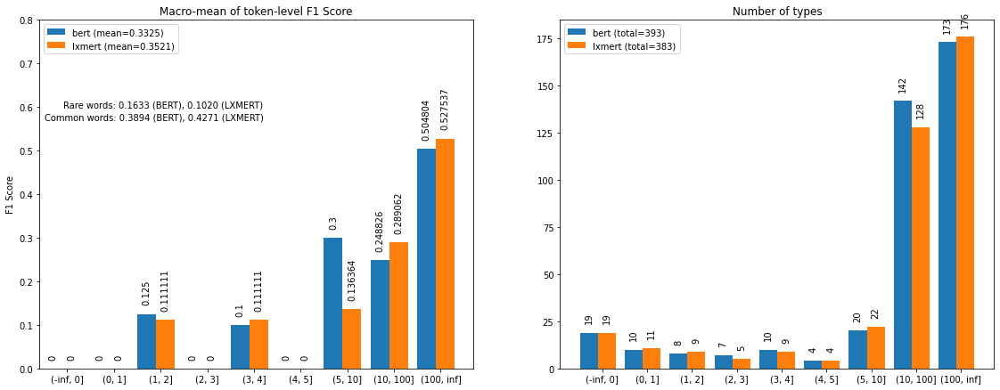

In [73]:
show_f1_with_rare_common_words_stat(type_f1_data_reserval_lxmert_to_bert, target_models=['bert', 'lxmert'])

#### rare words

In [75]:
type_f1_data_reserval_lxmert_to_bert[
    (type_f1_data_reserval_lxmert_to_bert['freq'].isin([5,6,7,8,9,10])) & 
    (~type_f1_data_reserval_lxmert_to_bert.isnull()['f1-score_bert'] | ~type_f1_data_reserval_lxmert_to_bert.isnull()['f1-score_lxmert'])
].sort_values(['f1-score_bert', 'freq'], ascending=False)

,freq,val_freq,type-en,f1-score_bert,f1-trues_bert,f1-preds_bert,f1-score_lxmert,f1-trues_lxmert,f1-preds_lxmert
type,,,,,,,,,
baseballschläger,10.0,1.0,baseball bat,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
geschwindigkeit,9.0,1.0,speed,1.0,"[False, False, True, False, False, False, Fals...","[False, False, True, False, False, False, Fals...",1.0,"[False, False, True, False, False, False, Fals...","[False, False, True, False, False, False, Fals..."
sicherheitsweste,9.0,2.0,safety vest,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
fahrradhelm,8.0,1.0,bicycle helmet,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
kaninchen,6.0,1.0,rabbits,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
verärgert,6.0,1.0,angry,1.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
aufgeregt,10.0,0.0,excited,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",NaN,NaN,NaN
overalls,10.0,0.0,overalls,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",NaN,NaN,NaN
schlammigen,9.0,0.0,muddy,0.0,"[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal...",NaN,NaN,NaN


### samples

ID 538


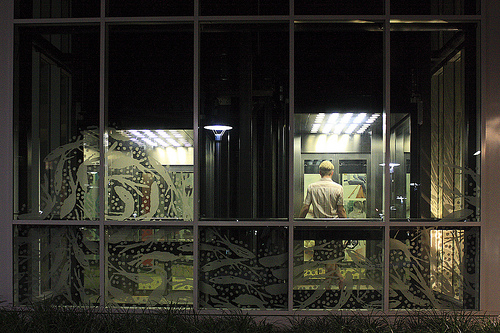

source    : a window with some type of design painted on it .
reference : ein fenster mit einem aufgemalten design .
bert      : ein fenster mit einer art muster darauf . (ppl=66.65694296593196)
           (a window with some kind of pattern on it .)
lxmert    : ein fenster mit einigen katzen darauf . (ppl=40.38060017142717)
           (a window with some cats on it .)
--------------------------------------------------------------------------------
ID 601


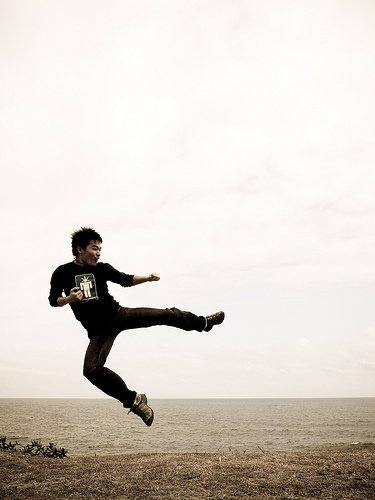

source    : it looks like a man practicing his martial arts moves near some muddy looking water .
reference : ein mann , der aussieht als würde er kampfsportübungen machen , vor schlammig aussehendem wasser .
bert      : es sieht aus , als ob ein mann seine kampfsport in der nähe von einigen schlammigen wasser üben . (ppl=26.552332162575123)
           (it looks like a man practicing his martial arts near some muddy water.)
lxmert    : es sieht aus , als ob ein mann seine kampfsport in der nähe von wasser übt . (ppl=14.10229442263295)
           (it looks like a man practicing his martial arts near water.)
--------------------------------------------------------------------------------
ID 132


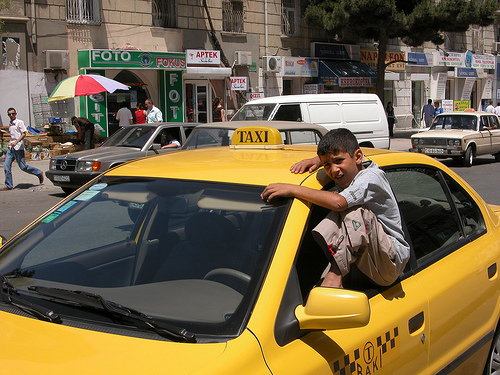

source    : a boy hangs out of a passing taxi cab window
reference : ein junge hängt aus dem fenster eines vorbeifahrenden taxis .
bert      : ein junge hängt von einem taxi aus dem fenster . (ppl=25.35257629652657)
           (a boy hangs from a cab out of the window .)
lxmert    : ein junge hängt aus einem taxi . (ppl=118.88626119439013)
           (a boy hangs out of a cab .)
--------------------------------------------------------------------------------
ID 849


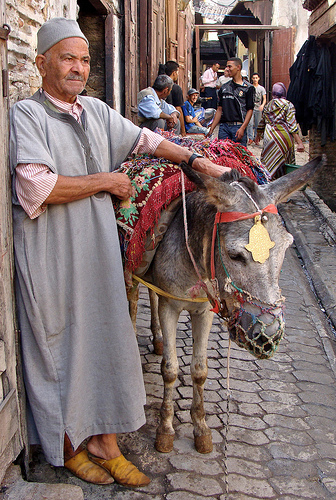

source    : man clothed in a traditional dress like attire , while standing next to his mule who also seems to be clothed as well .
reference : ein mann in traditionellem gewand steht neben seinem esel , der anscheinend auch bekleidet ist .
bert      : ein mann in einem traditionellen kleid steht neben seinem maultier , das wie ein sehr aussieht , als ob er sich nicht zu sein . (ppl=21.426124705232215)
           (a man in a traditional dress stands next to his mule that looks like a very as if he is not going to be.)
lxmert    : ein mann in einem traditionellen kleid steht neben seinem hund , der wie ein k-9-militärhund aussieht . (ppl=6.741301144802087)
           (a man in a traditional dress stands next to his dog , which looks like a k-9 military dog .)
--------------------------------------------------------------------------------
ID 812


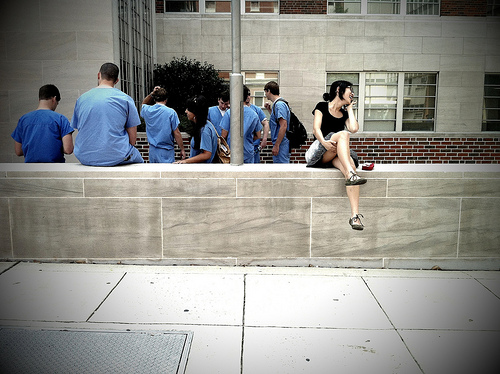

source    : several people in blue scrubs and one in a skirt and black blouse .
reference : mehrere personen in blauen kitteln und eine in einem rock und schwarzer bluse .
bert      : mehrere personen in blauen overalls , eine in einem rock und einer schwarzen bluse . (ppl=20.39646876044944)
           (several people in blue overalls , one in a skirt and a black blouse .)
lxmert    : mehrere personen in blauen pullovern und eine in einem rock und schwarzer bluse . (ppl=29.33819574055092)
           (several people in blue sweaters and one in a skirt and black blouse .)
--------------------------------------------------------------------------------
ID 604


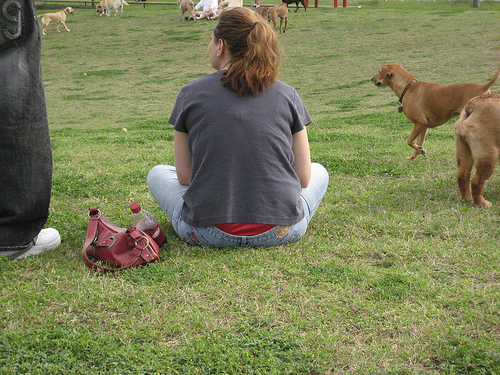

source    : a woman sitting next to her purse watching dogs at the park .
reference : eine frau sitzt neben ihrer tasche und sieht hunden im park zu .
bert      : eine frau sitzt neben ihren geldbörse im park und beobachtet hunde . (ppl=18.73476373407461)
           (a woman sits next to her purse in the park and watches dogs .)
lxmert    : eine frau sitzt neben ihrer handtasche und beobachtet hunde im park . (ppl=8.033207049993424)
           (a woman sits next to her handbag and watches dogs in the park .)
--------------------------------------------------------------------------------
ID 944


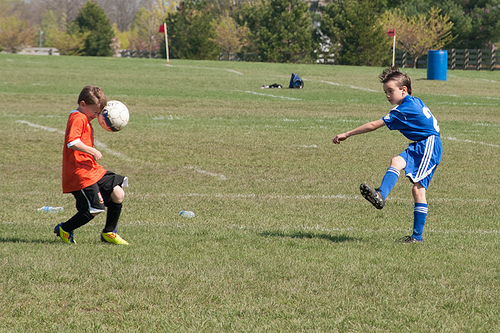

source    : two boys play soccer against each other .
reference : zwei jungen spielen gegeneinander fußball .
bert      : zwei jungen spielen fußball gegen einander . (ppl=17.07638156683955)
           (two boys play soccer against each other .)
lxmert    : zwei jungen spielen fußball . (ppl=37.0509752495147)
           (two boys play soccer .)
--------------------------------------------------------------------------------
ID 839


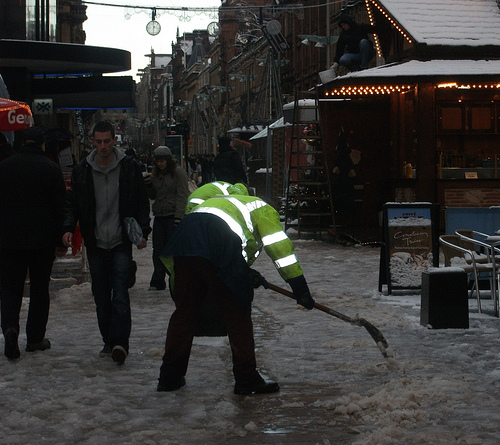

source    : in a outdoor market two men shovel snow and slush out of the path .
reference : zwei männer schaufeln auf einem freiluftmarkt den weg von schnee und matsch frei .
bert      : auf einem markt im freien schaufelt zwei männer schnee und knien aus dem weg . (ppl=15.556439200860803)
           (at an outdoor market two men shovel snow and kneel out of the way .)
lxmert    : auf einem markt im freien , zwei männer schaufeln schnee und verlassen den weg . (ppl=6.602313106082291)
           (at an outdoor market , two men shovel snow and leave the way .)
--------------------------------------------------------------------------------
ID 251


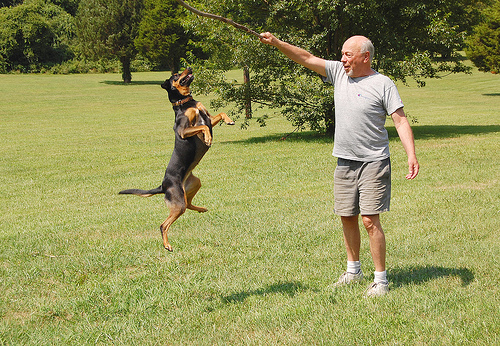

source    : a bald man demonstarting how high his brown and black dog can jump .
reference : ein glatzköpfiger mann demonstriert , wie hoch sein braun @-@ schwarzer hund springen kann .
bert      : ein kahlköpfiger mann bringt sehr aufgeregt , wie sein braun-schwarzer hund springt . (ppl=12.834466859462283)
           (a bald man brings very excited as his brown and black dog jumps.)
lxmert    : ein glatzköpfiger mann hebt seine hohe braune und schwarze hund springt hoch . (ppl=55.3965494369282)
           (bald man lifts his high brown and black dog jumps up .)
--------------------------------------------------------------------------------
ID 51


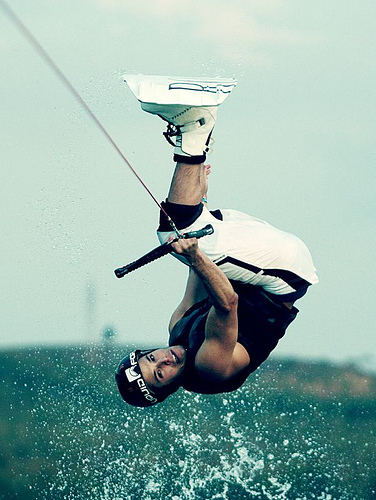

source    : a wakeboarder performs a flip while being towed at high speed .
reference : ein wakeboarder macht einen salto während er bei hoher geschwindigkeit an einem seil gezogen wird .
bert      : ein skater führt einen salto vor , während er auf hoher geschwindigkeit geworfen wird . (ppl=9.939954401093283)
           (a skater performs a somersault while being thrown at high speed.)
lxmert    : ein skater macht einen salto , während er auf hoher hoher geschwindigkeit geworfen wird . (ppl=11.35011446591831)
           (a skater does a somersault while being thrown at high speed.)
--------------------------------------------------------------------------------
ID 789


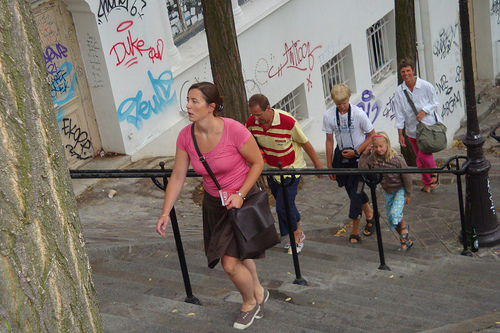

source    : five people walking up a set of stairs led by a woman in a pink shirt and brown skirt .
reference : fünf personen , angeführt von einer frau in einem pinken hemd und braunen rock , gehen eine treppe hoch .
bert      : fünf personen gehen eine treppe hinauf , die von einer frau in pinkfarbenem hemd und braunen rock anhat . (ppl=9.765274495057444)
           (five people walk up a staircase , which is worn by a woman in pink shirt and brown skirt .)
lxmert    : fünf personen gehen eine treppe hinauf , die von einer frau in einem rosa hemd und braunen rock zeigt . (ppl=12.887390853242735)
           (five people walk up a staircase that shows a woman in a pink shirt and brown skirt.)
--------------------------------------------------------------------------------
ID 143


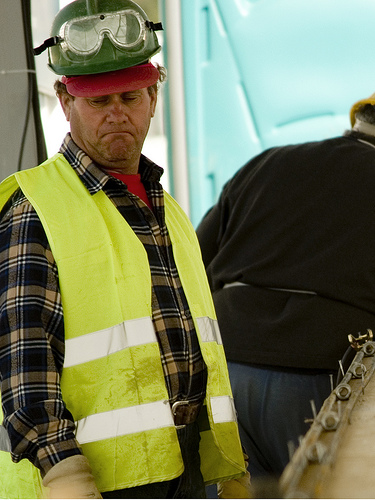

source    : a man in a green hard hat and yellow safety vest frowns .
reference : ein mann mit einem grünen schutzhelm und sicherheitsweste blickt ernst .
bert      : ein mann mit einem grünen schutzhelm und gelber sicherheitsweste prüft die stirn . (ppl=9.420107392044471)
           (a man with a green hard hat and yellow safety vest checks the forehead .)
lxmert    : ein mann mit einem grünen schutzhelm und gelber sicherheitsweste jongliert . (ppl=13.25793072495927)
           (a man with a green safety helmet and yellow safety vest juggles .)
--------------------------------------------------------------------------------
ID 289


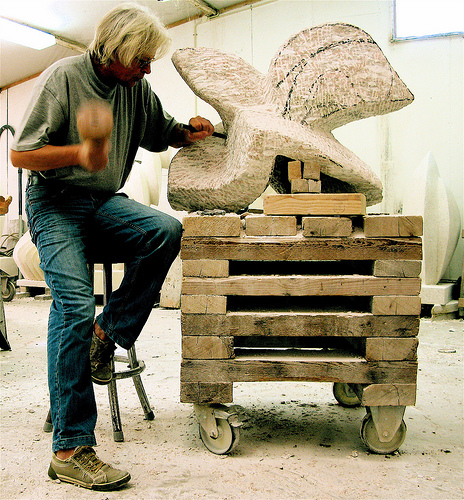

source    : a man pounds on an artwork perched on a cart .
reference : ein mann grübelt über einer skulptur auf einem wagen .
bert      : ein mann malt auf einem wagen ein kunstwerk , der auf einem wagen steht . (ppl=8.606389744814646)
           (a man paints a work of art standing on a wagon .)
lxmert    : ein mann hockt auf einem wagen auf einem wagen . (ppl=10.509758643887066)
           (a man squats on a wagon on a wagon .)
--------------------------------------------------------------------------------
ID 953


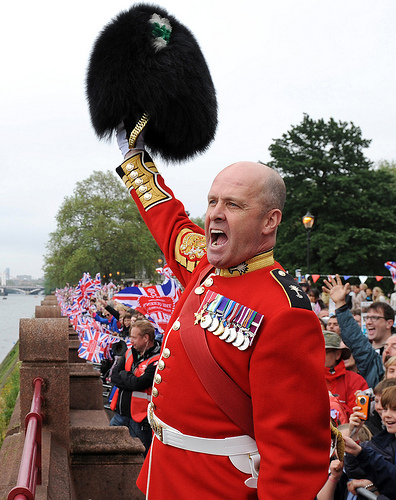

source    : a british gentleman , dressed in full military uniform , waving his hat with a background of people sitting back and looking out onto the waterway .
reference : ein britischer gentleman in voller militärischer uniform winkt mit seiner mütze leuten zu , die im hintergrund sitzen und auf den kanal blicken .
bert      : ein herr in voller uniform , der seinen hut trägt , winkt mit einem hut aus dem hintergrund , und schaut auf das wasser . (ppl=8.505446964163747)
           (a gentleman in full uniform, wearing his hat, waving a hat from the background, looking at the water.)
lxmert    : ein einzelner herr in kompletter anzug winkt mit dem hut und schaut auf das wasser , im hintergrund sind zuschauer zu sehen . (ppl=10.472986509498648)
           (a single gentleman in a full suit waves his hat and looks at the water, in the background spectators can be seen.)
--------------------------------------------------------------------------------
ID 760


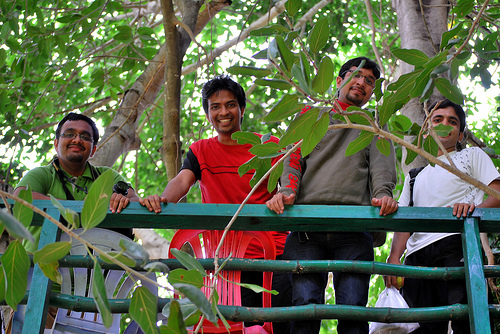

source    : four men are outside looking down over the green bridge they are on .
reference : vier männer sind im freien und blicken von der grünen brücke , auf der sie stehen , hinunter .
bert      : vier männer sind im freien und schauen über die grüne brücke . (ppl=8.099251116334068)
           (four men are outdoors looking over the green bridge .)
lxmert    : vier männer sind im freien und blicken über die grüne brücke . (ppl=9.9316917313255)
           (four men are in the open looking over the green bridge .)
--------------------------------------------------------------------------------
ID 497


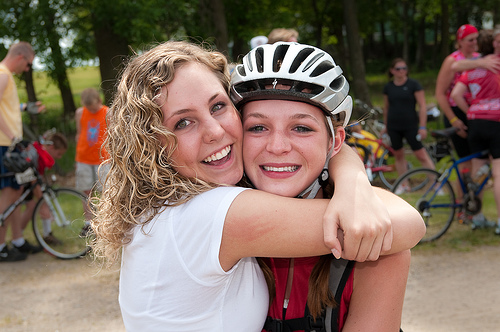

source    : two teenage girls hugging , one wearing a bicycle helmet , with cyclists in the background .
reference : zwei teenagerinnen umarmen sich vor radfahrern im hintergrund , eine trägt einen fahrradhelm .
bert      : zwei teenagerinnen , die eine person mit einem fahrradhelm und die radfahrer im hintergrund , umarmen sich . (ppl=7.375378693817209)
           (two teenage girls, the one person with a bicycle helmet and the cyclists in the background, hugging each other.)
lxmert    : zwei teenagerinnen umarmen sich , eine mit einem fahrradhelm und die radfahrer ist im hintergrund . (ppl=3.961641893259791)
           (two teenage girls hug each other, one with a bicycle helmet and the cyclist is in the background.)
--------------------------------------------------------------------------------
ID 911


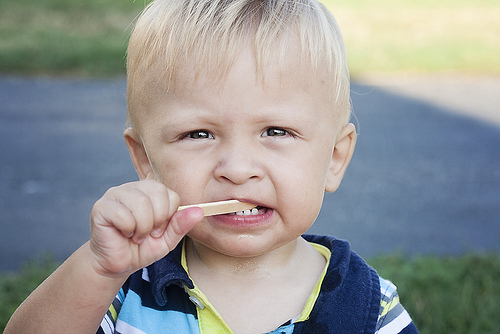

source    : a very young boy stares ahead as he is biting onto a small object .
reference : ein sehr kleiner junge guckt nach vorne während er in einen kleinen gegenstand beißt .
bert      : ein sehr kleiner junge starrt nach vorne , als er sich auf ein kleines objekt beißt . (ppl=6.929474511614862)
           (a very small boy stares ahead as he bites down on a small object.)
lxmert    : ein sehr kleiner junge starrt von einem kleinen gegenstand auf ein kleines objekt . (ppl=11.65533268909819)
           (a very small boy stares from a small object to a small object .)
--------------------------------------------------------------------------------
ID 581


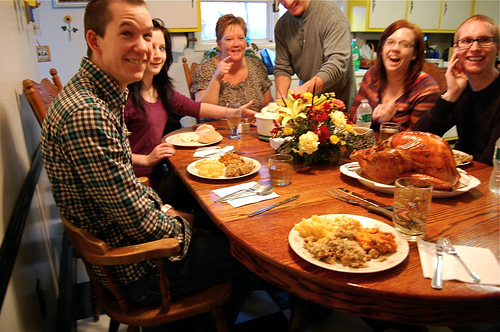

source    : 6 people are gathered around to eat a big dinner .
reference : 6 personen versammeln sich zu einem großen abendessen .
bert      : sechs personen sind um ein großes abendessen versammelt und essen . (ppl=6.862228104344608)
           (six people are gathered around a large dinner and eat .)
lxmert    : mehrere personen haben sich um ein großes abendessen versammelt . (ppl=2.714222964645732)
           (several people have gathered around a large dinner .)
--------------------------------------------------------------------------------
ID 448


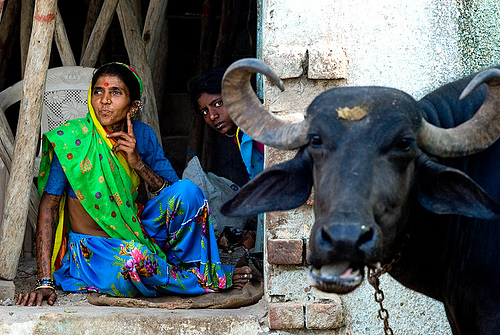

source    : two people and a leashed cow at a home .
reference : zwei personen und eine angebundene kuh vor einem haus .
bert      : zwei personen und eine kuh befinden sich in einem haus . (ppl=6.689315971023947)
           (two people and a cow are in a house .)
lxmert    : zwei personen und eine kuh bei einem haus . (ppl=32.99130209033429)
           (two people and a cow at a house .)
--------------------------------------------------------------------------------
ID 329


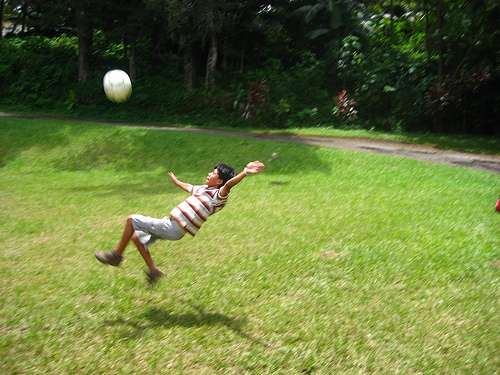

source    : a boy in midair trying to kick a soccer ball
reference : ein junge ist in der luft und versucht einen fußball zu treffen
bert      : ein junge in der luft versucht , einen fußball zu schießen . (ppl=6.686158101934188)
           (a boy in the air tries to shoot a soccer ball.)
lxmert    : ein junge in der luft versucht einen fußball zu schießen . (ppl=7.584651176550149)
           (a boy in the air tries to shoot a soccer ball .)
--------------------------------------------------------------------------------
ID 131


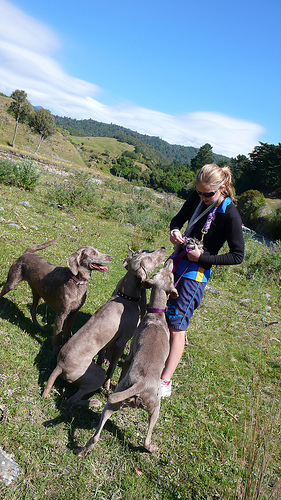

source    : three brown dogs are jumping up at the woman wearing blue .
reference : drei braune hunde springen an der blau gekleideten frau hoch .
bert      : drei braune hunde springen zu der frau in blauer kleidung hoch . (ppl=6.350846486725486)
           (three brown dogs jump up to the woman in blue clothes .)
lxmert    : drei braune hunde springen auf die frau in blau . (ppl=9.524894764491386)
           (three brown dogs jump on the woman in blue .)
--------------------------------------------------------------------------------
ID 745


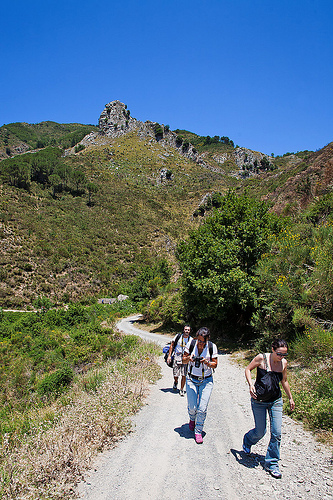

source    : three people are walking up a mountain trail , while one woman is looking at her camera .
reference : drei personen gehen einen gebirgspfad hoch , eine davon blickt auf ihre kamera .
bert      : drei personen gehen einen bergpfad hinauf , während eine frau in ihre kamera schaut . (ppl=5.7701836307807834)
           (three people walk up a mountain path while a woman looks into her camera.)
lxmert    : drei personen gehen einen bergpfad hoch , während eine frau in ihre kamera schaut . (ppl=8.877833130361822)
           (three people walk up a mountain path while a woman looks into her camera.)
--------------------------------------------------------------------------------
ID 335


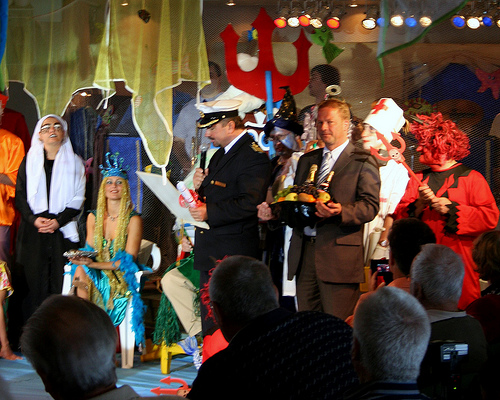

source    : costumed onlookers watch as a uniformed policeman makes a speech and a man in a suit holds a bowl of fruit .
reference : kostümierte zuschauer sehen zu wie ein polizist eine rede hält und ein mann im anzug eine schale mit obst hält .
bert      : zuschauer schauen zu , wie ein polizist in uniform eine rede und ein mann im anzug eine schüssel mit obst hält . (ppl=5.377630006677523)
           (spectators watch as a policeman in uniform gives a speech and a man in a suit holds a bowl of fruit.)
lxmert    : zuschauer schauen zu , wie ein polizist in der hand hält und ein mann im anzug eine schüssel mit obst hält . (ppl=4.473944206659655)
           (spectators watch as a policeman holds in his hand and a man in a suit holds a bowl of fruit.)
--------------------------------------------------------------------------------
ID 150


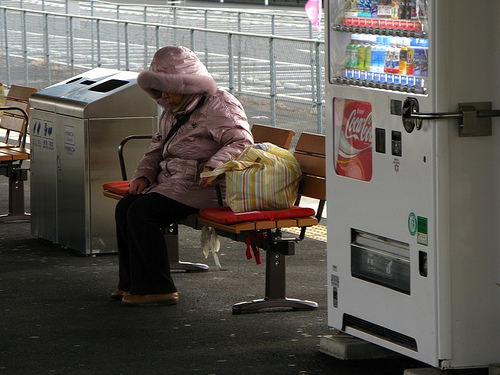

source    : an individual wearing rose jacket site idle on a wooden bench .
reference : eine person in einer rosa jacke sitzt untätig auf einer hölzernen bank .
bert      : eine person , die eine jeansjacke trägt , liegt auf einer holzbank . (ppl=5.139538900978102)
           (a person wearing a jeans jacket lies on a wooden bench.)
lxmert    : eine person in einer warnweste betet auf einer holzbank . (ppl=27.531393326847944)
           (a person in a warning vest prays on a wooden bench .)
--------------------------------------------------------------------------------
ID 1


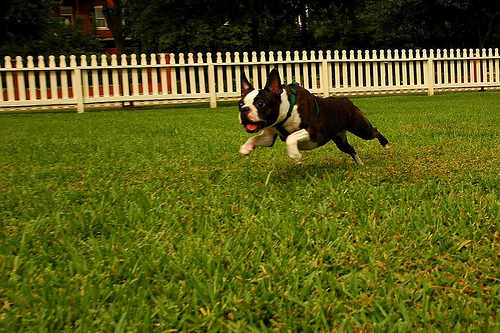

source    : a boston terrier is running on lush green grass in front of a white fence .
reference : ein boston terrier läuft über saftig @-@ grünes gras vor einem weißen zaun .
bert      : ein einsamer terrier rennt vor einem weißen zaun über das grüne gras . (ppl=5.128710163757811)
           (a lonely terrier runs across the green grass in front of a white fence .)
lxmert    : ein einsamer terrier läuft auf einem niedrigen grünen rasen vor einem weißen zaun . (ppl=3.447404623872345)
           (a lone terrier walks on a low green lawn in front of a white fence .)
--------------------------------------------------------------------------------
ID 347


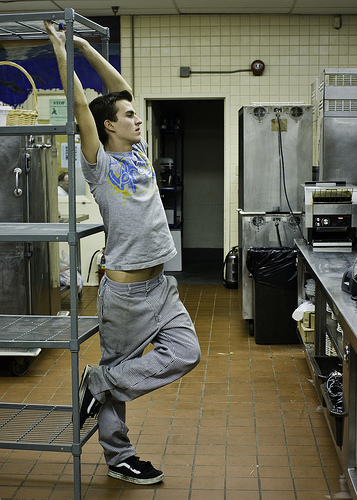

source    : a teenage boy is stretching in the kitchen and you can see part of his stomach .
reference : ein teenager streckt sich in der küche und sein bauch ist teilweise sichtbar .
bert      : ein männlicher teenager streckt sich in der küche , und es sieht aus , als ob er ein stück bauch guckt . (ppl=4.963858402120719)
           (a male teenager stretches in the kitchen, and it looks like he is peeking a piece of belly.)
lxmert    : ein männlicher teenager streckt sich in der küche und es sieht aus , als ob er ein stück bauch guckt . (ppl=5.432988688698496)
           (a male teenager stretches in the kitchen and it looks like he is peeking a piece of belly.)
--------------------------------------------------------------------------------
ID 294


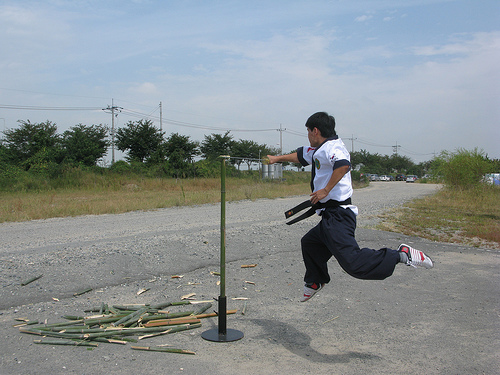

source    : a man in a martial arts uniform in midair .
reference : ein mann in einem karateanzug in der luft .
bert      : ein mann in einem kampfsportkleidung befindet sich in der luft . (ppl=4.8291538619810135)
           (a man in a martial arts outfit is in the air .)
lxmert    : ein mann in einem kampfsportturnier mitten in der luft . (ppl=5.989657158934431)
           (a man in a martial arts tournament in mid air .)
--------------------------------------------------------------------------------
ID 787


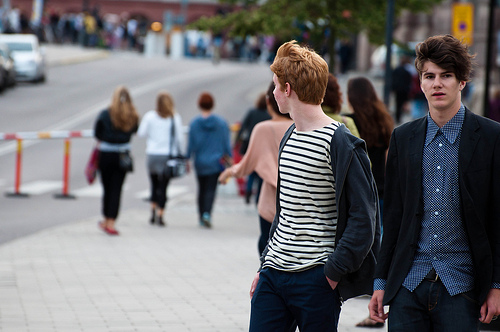

source    : a young man walking with another young man glances back at three girls they just passed
reference : ein junger mann , der mit einem weiteren jungen mann unterwegs ist , blickt sich nach drei mädchen um , an denen sie gerade vorbeigegangen sind .
bert      : ein junger mann geht mit einem anderen jungen mann an , der gerade an drei mädchen vorbeigeht . (ppl=4.639105003856406)
           (a young man goes on with another young man who just passes three girls .)
lxmert    : ein junger mann , der mit einem anderen jungen mann den rücken zu fuß unterwegs ist , geht mit drei mädchen an drei mädchen vorbei . (ppl=5.411469431518931)
           (a young man who is walking with another young man's back , walks past three girls with three girls .)
--------------------------------------------------------------------------------
ID 182


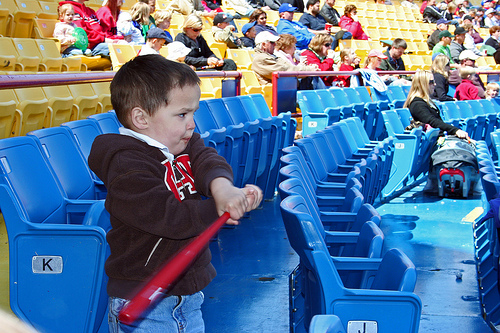

source    : the boy wearing a black shirt and blue jeans is holding a red baseball bat .
reference : der junge im schwarzen t @-@ shirt und blauen jeans hält einen roten baseballschläger .
bert      : der junge , der ein schwarzes hemd und blaue jeans trägt , hält einen roten baseballschläger . (ppl=4.205166412568561)
           (the boy wearing a black shirt and blue jeans holds a red baseball bat.)
lxmert    : der junge in dem schwarzen hemd und blauen jeans hält einen roten schläger . (ppl=6.8476277140710184)
           (the boy in the black shirt and blue jeans is holding a red bat .)
--------------------------------------------------------------------------------
ID 310


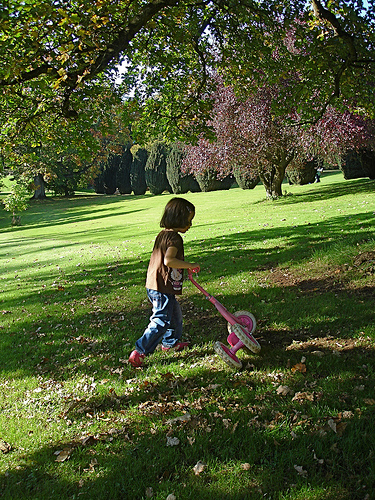

source    : a little girl is pushing her scooter through a grassy tree lined field .
reference : ein kleines mädchen schiebt seinen roller über eine wiese mit bäumen .
bert      : ein kleines mädchen schiebt ihren roller durch eine wiese , die von bäumen umgeben ist . (ppl=4.039321767059564)
           (a little girl pushes her scooter through a meadow surrounded by trees.)
lxmert    : ein kleines mädchen schiebt ihren roller durch einen grasbewachsenen feld . (ppl=12.080431639309724)
           (a little girl pushes her scooter through a grassy field .)
--------------------------------------------------------------------------------
ID 82


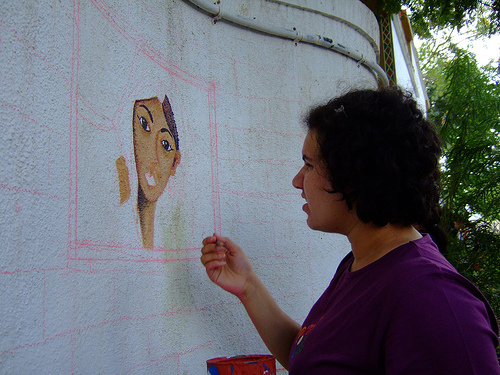

source    : a young female artists paints an image of a woman on a wall .
reference : eine junge künstlerin malt ein bild einer frau auf eine wand .
bert      : eine junge frau malt ein bild von einer frau an einer wand . (ppl=3.9862920777850364)
           (a young woman paints a picture of a woman on a wall .)
lxmert    : eine junge frau malt ein bild von einer frau auf einer mauer . (ppl=4.038236074843178)
           (a young woman paints a picture of a woman on a wall .)
--------------------------------------------------------------------------------
ID 233


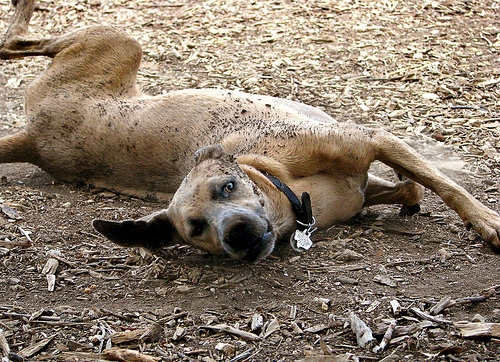

source    : dog with black collar rolling in dirt and dried leaves
reference : hund mit schwarzem halsband wälzt sich in staub und trockenen blättern .
bert      : ein hund mit einem schwarzen halsband rollt durch schmutz und laub . (ppl=3.6610718387200905)
           (a dog with a black collar rolls through dirt and leaves .)
lxmert    : ein hund mit schwarzem halsband rollt erde durch schlamm . (ppl=9.104836897265017)
           (a dog with black collar rolls earth through mud .)
--------------------------------------------------------------------------------
ID 777


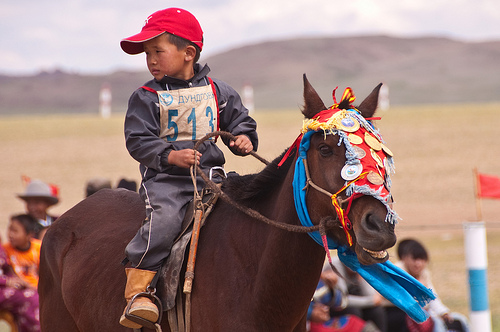

source    : a young boy in a red hat rides on a horse .
reference : ein kleiner junge mit roter mütze reitet auf einem pferd .
bert      : ein kleiner junge mit einem roten hut reitet auf einem pferd . (ppl=3.624768044234361)
           (a little boy with a red hat riding a horse .)
lxmert    : ein kleiner junge mit roter mütze reitet auf einem pferd . (ppl=2.9976338542382086)
           (a little boy with red cap riding a horse .)
--------------------------------------------------------------------------------
ID 507


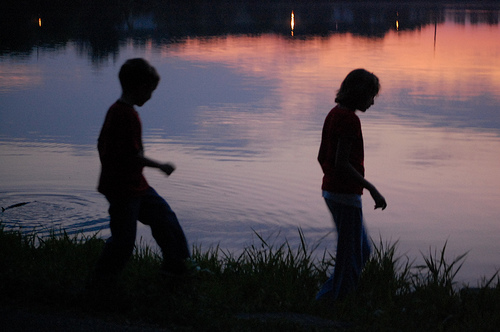

source    : two people are silhouetted against a lake reflecting a painted sky .
reference : die silhouetten von zwei personen auf einem see , der einen bunten himmel reflektiert .
bert      : zwei personen heben sich als silhouette gegen einen see ab , der mit einem verzierten himmel bedeckt ist . (ppl=3.59192343482066)
           (two people silhouetted against a lake covered with an ornate sky.)
lxmert    : zwei personen heben sich als silhouette gegen einen see , der mit einem verzierten himmel bedeckt ist . (ppl=3.921636184504117)
           (two people silhouetted against a lake covered with an ornate sky.)
--------------------------------------------------------------------------------
ID 57


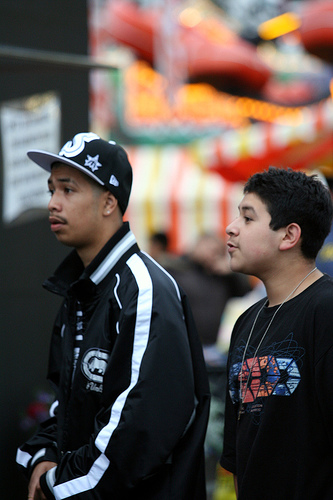

source    : two men wearing black in a city
reference : zwei männer in schwarz in einer stadt
bert      : zwei schwarz gekleidete männer in einer stadt . (ppl=3.587018437598349)
           (two men dressed in black in a city .)
lxmert    : zwei männer in schwarz in einer stadt . (ppl=21.728690862584525)
           (two men in black in one city .)
--------------------------------------------------------------------------------
ID 43


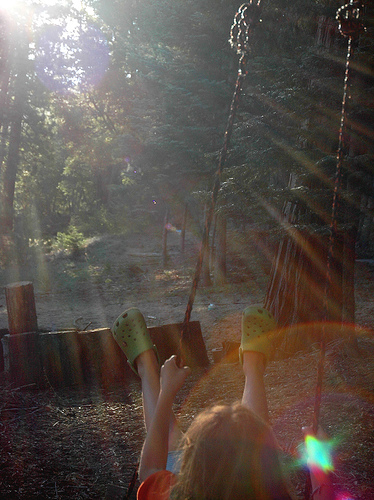

source    : a kid swings with his feet up in the air in a forest .
reference : ein junge schaukelt mit den füßen in der luft in einem wald .
bert      : ein kind schwingt im wald die füße in die luft . (ppl=3.467987244568039)
           (a child swings his feet in the air in the forest .)
lxmert    : ein kind schwingt mit den füßen in einem wald hoch . (ppl=7.514104143213993)
           (a child swings his feet up in a forest .)
--------------------------------------------------------------------------------
ID 962


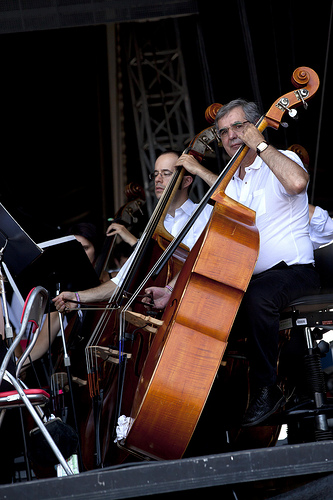

source    : a man is playing an interment in a concert
reference : ein mann spielt ein intermezzo in einem konzert .
bert      : ein mann spielt bei einem konzert ein lied . (ppl=3.440052134419808)
           (a man plays a song at a concert .)
lxmert    : ein mann spielt bei einem konzert auf einem konzert . (ppl=5.705863995682962)
           (a man plays at a concert at a concert .)
--------------------------------------------------------------------------------
ID 755


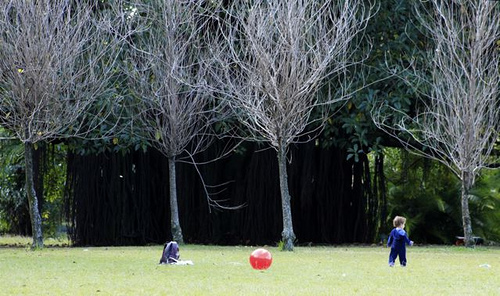

source    : a small child in a blue outfit is looking off at some trees in the distance .
reference : ein kleines kind in blau sieht zu bäumen , die in der ferne stehen .
bert      : ein kleines kind in einem blauen outfit blickt von einigen bäumen in die ferne . (ppl=3.194568599164899)
           (a small child in a blue outfit looks from some trees into the distance .)
lxmert    : ein kleines kind in einem blauen outfit blickt von bäumen in die ferne . (ppl=2.930098874721816)
           (a small child in a blue outfit looks from trees into the distance .)
--------------------------------------------------------------------------------
ID 780


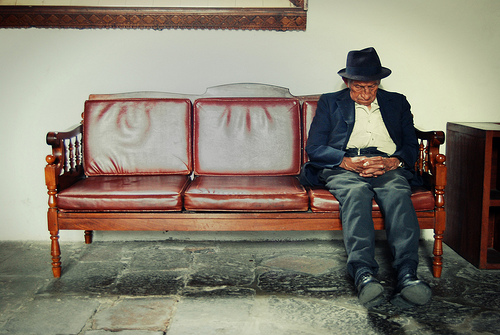

source    : old man wearing a hat and coat sleeping sitting up on a sofa .
reference : alter mann mit hut und mantel schläft im sitzen auf einem sofa .
bert      : ein alter mann mit hut und mantel sitzt auf einem sofa und schläft . (ppl=3.055763708174476)
           (an old man with hat and coat sits on a sofa and sleeps .)
lxmert    : ein alter mann mit hut und mantel sitzt auf einem sofa . (ppl=3.6357341655559035)
           (an old man with hat and coat sits on a sofa .)
--------------------------------------------------------------------------------
ID 762


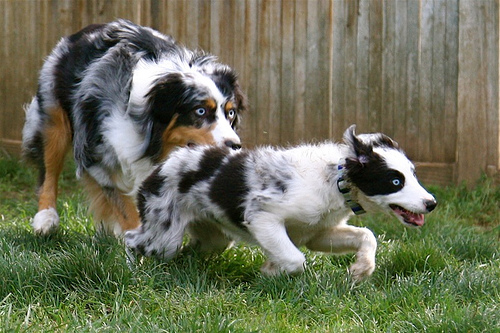

source    : an adult australian shepherd follows behind a running australian shepherd puppy .
reference : ein ausgewachsener australian shepherd folgt einem welpen , der vor ihm läuft .
bert      : ein erwachsener schäferhund folgt einem deutschen schäferhund . (ppl=2.9717805257906855)
           (an adult shepherd dog follows a german shepherd dog .)
lxmert    : ein erwachsener schäferhund folgt einem schäferhund , der hinter einem größeren schäferhund rennt . (ppl=2.8658572835472045)
           (an adult shepherd dog follows a shepherd dog running behind a larger shepherd dog .)
--------------------------------------------------------------------------------
ID 749


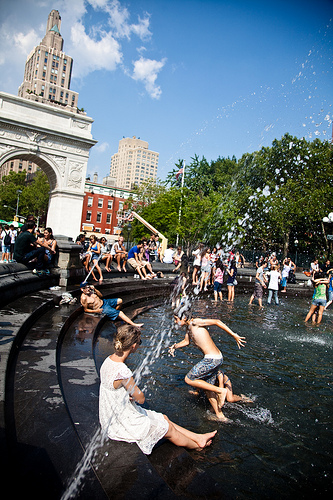

source    : people cooling off in a fountain , a woman in a white dress sits on the edge looking on .
reference : leute , die sich in einem springbrunnen abkühlen , eine frau in einem weißen kleid sitzt am rand und sieht zu .
bert      : menschen , die sich in einem brunnen bewegen , eine frau in einem weißen kleid an der kante sitzt und schaut zu . (ppl=2.8143280234221617)
           (people moving in a fountain, a woman in a white dress sitting on the edge and watching.)
lxmert    : menschen versammeln sich in einem brunnen , eine frau in einem weißen kleid sitzt am ufer und schaut zu . (ppl=2.580747406924834)
           (people gather in a fountain, a woman in a white dress sits on the shore and watches.)
--------------------------------------------------------------------------------
ID 573


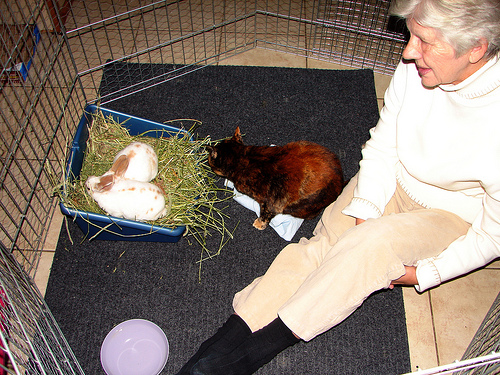

source    : a woman sits in a caged in area with a cat and two bunnies .
reference : eine frau sitzt in einem käfig mit einer katze und zwei kaninchen .
bert      : eine frau sitzt mit einer katze und zwei kaninchen in einem umzäunten gebiet . (ppl=2.704711618289955)
           (a woman sits with a cat and two rabbits in a fenced area .)
lxmert    : eine frau sitzt in einem umzäunten bereich mit einer katze und zwei weiteren katze . (ppl=8.072106127858309)
           (a woman sits in a fenced area with a cat and two other cats .)
--------------------------------------------------------------------------------
ID 212


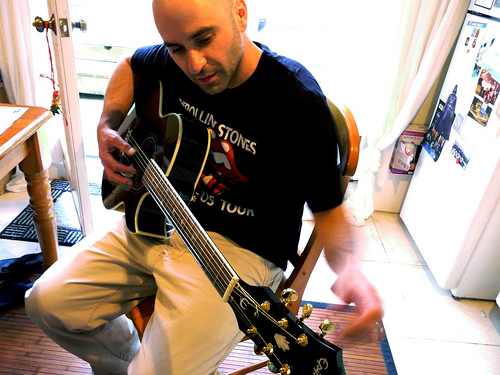

source    : a young man tunes his guitar in the kitchen .
reference : ein junger mann stimmt seine gitarre in der küche .
bert      : ein junger mann spielt in der küche gitarre . (ppl=2.600561229376969)
           (a young man plays guitar in the kitchen .)
lxmert    : ein junger mann schlägt seine gitarre in der küche . (ppl=2.758025876072255)
           (a young man strums his guitar in the kitchen .)
--------------------------------------------------------------------------------
ID 245


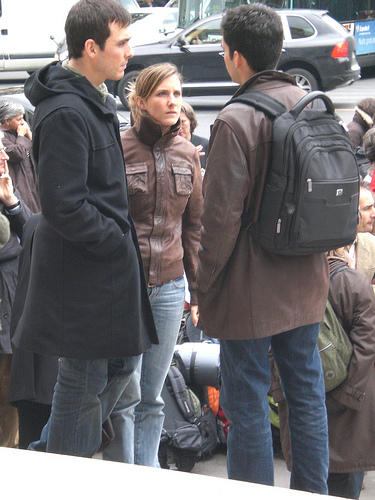

source    : three young adults talk in a crowd of people , the woman looks upset .
reference : drei jugendliche reden in einer menschenmenge , die frau blickt verärgert .
bert      : drei junge erwachsene unterhalten sich in einer menschenmenge , eine frau sieht verärgert aus . (ppl=2.593251386110468)
           (three young adults talking in a crowd, one woman looks upset.)
lxmert    : drei junge erwachsene unterhalten sich in einer menschenmenge , die frau sieht aus . (ppl=3.7933935453947356)
           (three young adults talking in a crowd , the woman looks out .)
--------------------------------------------------------------------------------
ID 655


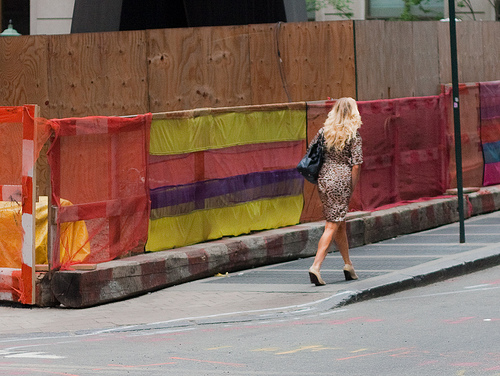

source    : a woman in a dress walking down the street past a construction site .
reference : eine frau in einem klid geht auf der straße an einer baustelle vorbei .
bert      : eine frau in einem kleid geht an einer baustelle vorbei . (ppl=2.5352974427657253)
           (a woman in a dress walks past a construction site .)
lxmert    : eine frau in einem kleid geht auf einer baustelle an einer baustelle vorbei . (ppl=3.392040752574285)
           (a woman in a dress walks past a construction site .)
--------------------------------------------------------------------------------
ID 62


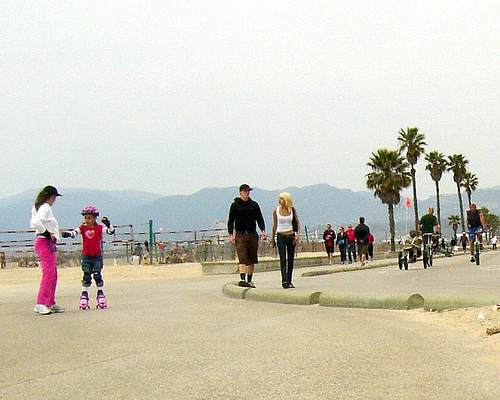

source    : a crowd of people out for some fun in public park .
reference : eine gruppe menschen , die sich in einem öffentlichen park amüsieren wollen .
bert      : eine menschenmenge versammelt sich in einem öffentlichen park . (ppl=2.411723672495742)
           (a crowd gathers in a public park .)
lxmert    : eine menschenmenge hat sich in einem öffentlichen park für einige personen versammelt . (ppl=4.785316253662705)
           (a crowd has gathered in a public park for some people .)
--------------------------------------------------------------------------------
ID 465


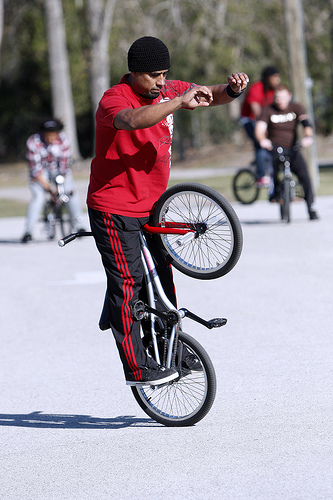

source    : a man performing a trick on a bicycle by standing on the pedals while the bike is upright .
reference : ein mann macht einen trick auf dem fahrrad , bei dem er auf dem hinterreifen balanciert .
bert      : ein mann macht ein kunststück auf dem fahrrad und steht dabei auf dem fahrrad , während das fahrrad steht . (ppl=2.4110297476707925)
           (a man does a trick on a bicycle while standing on the bicycle while the bicycle is standing.)
lxmert    : ein mann macht einen trick auf dem fahrrad , während der fahrrad auf dem fahrrad steht . (ppl=3.2544376568779696)
           (a man does a trick on the bicycle while the bicycle is standing on the bicycle.)
--------------------------------------------------------------------------------
ID 980


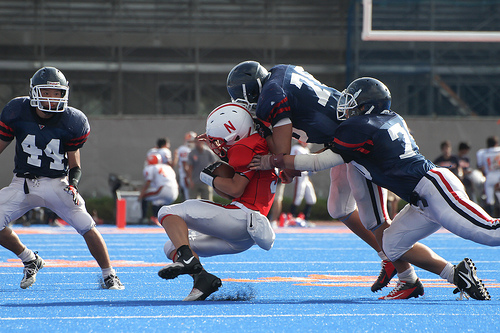

source    : a runner scrambles for yardage while being brought down by two tacklers .
reference : ein runner versucht , extra @-@ yards zu machen während er von zwei tacklern zu boden gebracht wird .
bert      : ein läufer wird von zwei gegnerischen spielern verfolgt . (ppl=2.162473986017671)
           (a runner is pursued by two opposing players .)
lxmert    : ein läufer wird von zwei hunden beobachtet , während sie auf zwei stangen werden . (ppl=9.510108990794036)
           (a runner is watched by two dogs while they are on two poles.)
--------------------------------------------------------------------------------
ID 769


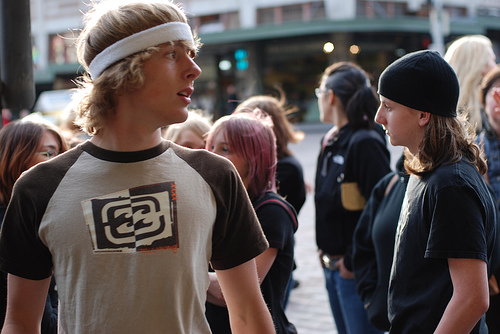

source    : a young man wearing a gray and black shirt and a white headband
reference : ein junger mann in einem schwarz @-@ weißen shirt und weißem stirnband .
bert      : ein junger mann , der ein graues hemd und ein weißes stirnband trägt . (ppl=1.5030886816606464)
           (a young man wearing a gray shirt and a white headband.)
lxmert    : ein junger mann in einem grauen und einem weißen stirnband und einem weißen stirnband . (ppl=2.47769478481669)
           (a young man in a gray and a white headband and a white headband .)
--------------------------------------------------------------------------------


In [182]:
show_samples(df_reversal_lxmert_to_bert.sort_values('ppl_bert', ascending=False), target_models=['bert','lxmert'], disp_attr=['ppl'])

## BERT <-> LXMERT

In [83]:
df_reversal = pd.concat([df_reversal_lxmert_to_bert, df_reversal_bert_to_lxmert])
len(df_reversal)

78

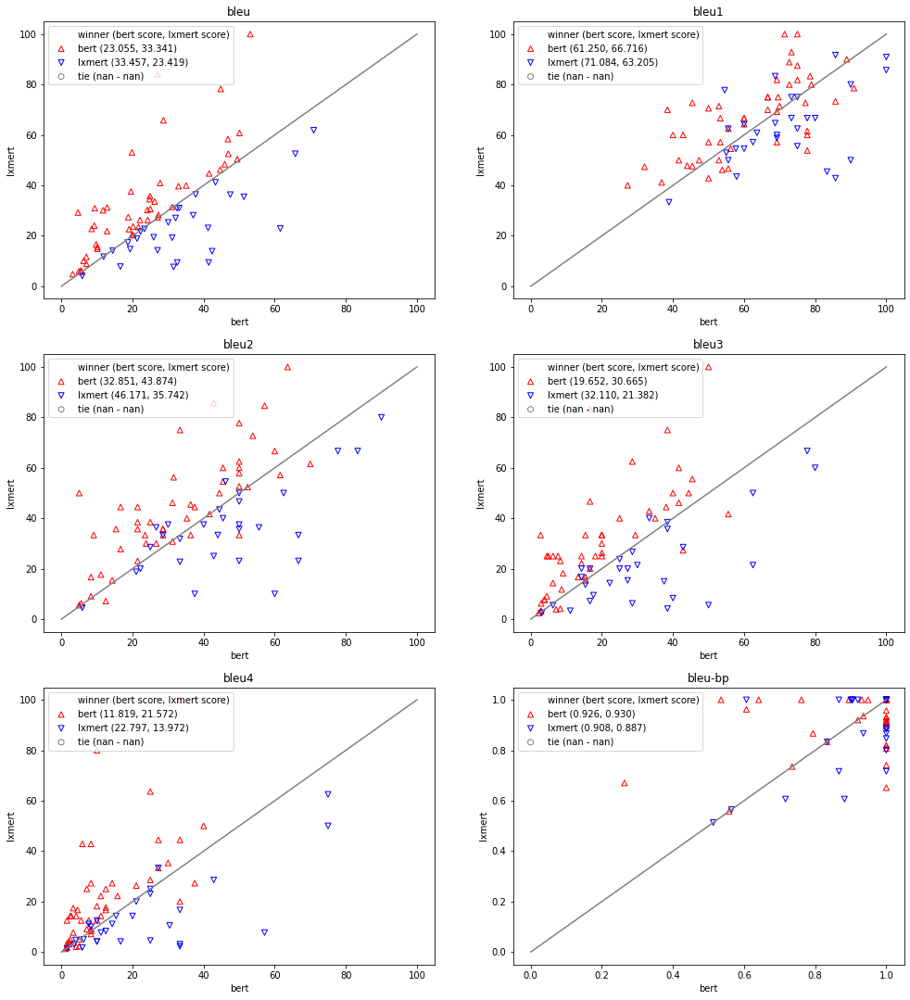

In [102]:
show_bleu_comparison(df_reversal,'bert', 'lxmert')

- BLEU@1 ですでに差があり、最終的な BLEU の差に結びついている。
- 長さに大きな違いは見られない。

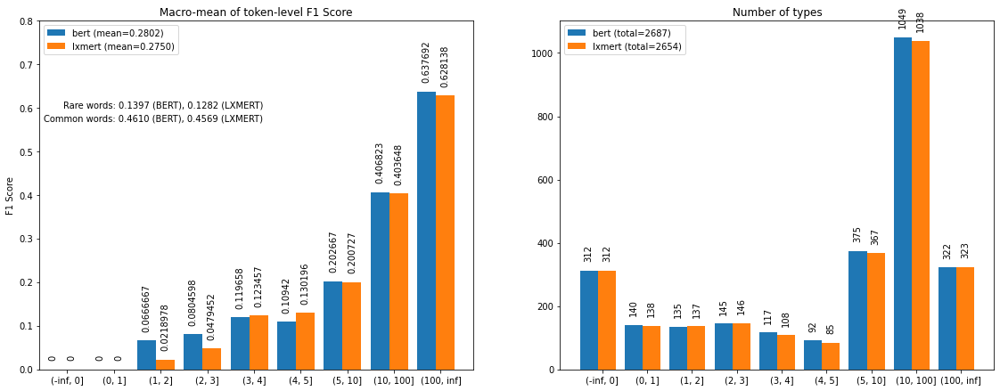

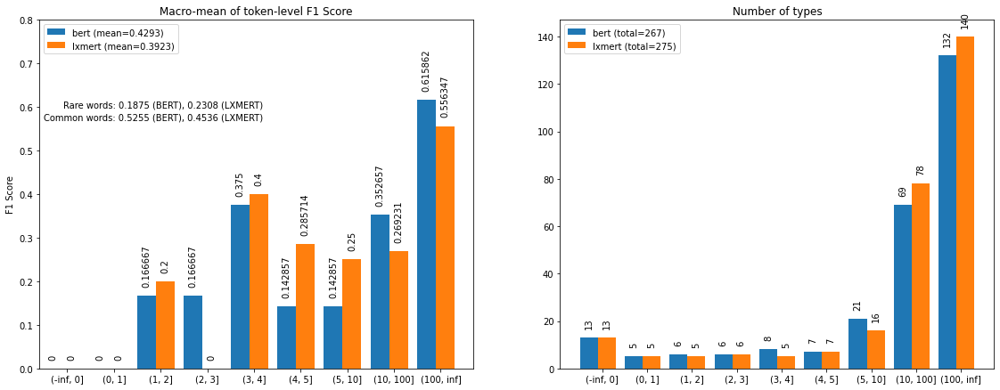

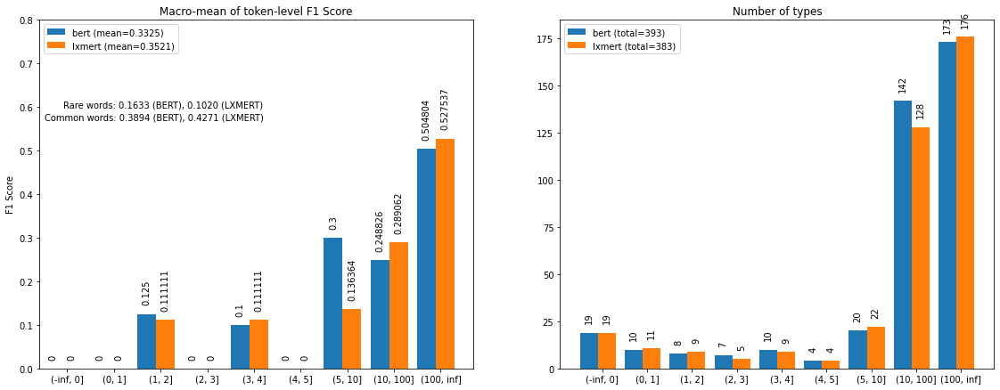

In [79]:
show_f1_with_rare_common_words_stat(type_f1_data, target_models=['bert','lxmert'])
show_f1_with_rare_common_words_stat(type_f1_data_reserval_bert_to_lxmert, target_models=['bert','lxmert'])
show_f1_with_rare_common_words_stat(type_f1_data_reserval_lxmert_to_bert, target_models=['bert', 'lxmert'])

- BERTの低頻度語訳出性能と、LXMERTの高頻度語訳出性能は大きな変化はない。
- `BERT -> LXMERT` な例では、全体的に単語の訳出性能が向上している。
  - 中でも、LXMERTモデルの低頻度語での訳出性能が向上している。
- `LXMERT -> BERT` な例では、BERTの低頻度翻訳性能以外、単語訳出性能が低下している。

- 低頻度語の訳出性能が人手評価に関わる？

# F1 of predicting human evaluation

In [292]:
def compute_f1(golds, preds):
    assert len(golds) > 0
    assert len(golds) == len(preds)
    
    scores = [f1_score(g, p, average='binary') for g, p in zip(golds, preds)]
    
    # micro average over multiple labels except False in each gold
    gold = [any(gs) for gs in zip(*golds)]
    pred = [any(gc) if all([g == p for g, p in zip(gc, pc)]) else not any(gc) 
        for gc, pc in zip(zip(*golds), zip(*preds))
    ]

    score = f1_score(gold, pred, average='binary')
    scores.append(score)
    
    return scores

In [141]:
winloss_by_rank = {
    (1, 2): [bert_beats_lxmert_by_rank, lxmert_beats_bert_by_rank],
    (1, 3): [bert_beats_allinc_by_rank, allinc_beats_bert_by_rank],
    (2, 3): [lxmert_beats_allinc_by_rank, allinc_beats_lxmert_by_rank]
}

## random

In [58]:
def random_select(n=1000, k=2):
    rnd_class = np.random.randint(low=0, high=k+1, size=(1000))
    
    rets = [np.zeros_like(rnd_class).astype(np.bool8) for _ in range(k)]
    for i, ret in enumerate(rets):
        ret[rnd_class == i+1] = True
    
    return rets

# random_select()

In [294]:
print('BERT   - LXMERT        : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [bert_beats_lxmert_by_rank, lxmert_beats_bert_by_rank], 
        random_select())
))
print('BERT   - All-inclusive : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [bert_beats_allinc_by_rank, allinc_beats_bert_by_rank], 
        random_select())
))
print('LXMERT - All-inclusive : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [lxmert_beats_allinc_by_rank, allinc_beats_lxmert_by_rank], 
        random_select())
))

BERT   - LXMERT        : 0.197, 0.097, 0.164
BERT   - All-inclusive : 0.160, 0.112, 0.149
LXMERT - All-inclusive : 0.138, 0.149, 0.154


## BLEU

In [295]:
print('BERT   - LXMERT        : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [bert_beats_lxmert_by_rank, lxmert_beats_bert_by_rank], 
        [bert_beats_lxmert_by_bleu, lxmert_beats_bert_by_bleu])
))
print('BERT   - All-inclusive : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [bert_beats_allinc_by_rank, allinc_beats_bert_by_rank], 
        [bert_beats_allinc_by_bleu, allinc_beats_bert_by_bleu])
))
print('LXMERT - All-inclusive : {:.3f}, {:.3f}, {:.3f}'.format(
    *compute_f1(
        [lxmert_beats_allinc_by_rank, allinc_beats_lxmert_by_rank], 
        [lxmert_beats_allinc_by_bleu, allinc_beats_lxmert_by_bleu])
))

BERT   - LXMERT        : 0.382, 0.245, 0.362
BERT   - All-inclusive : 0.341, 0.207, 0.325
LXMERT - All-inclusive : 0.322, 0.286, 0.343


## Length

In [188]:
src_lens = [len(t.split(' ')) for t in src]

BERT - LXMERT:


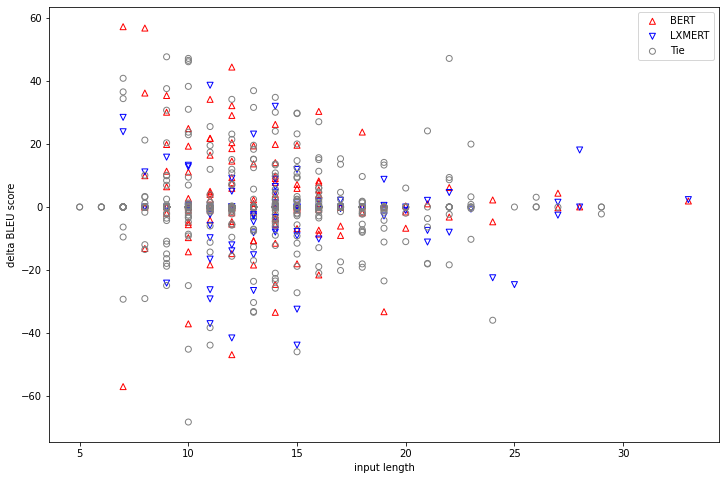

In [217]:
m1_wins = bert_beats_lxmert_by_rank
m2_wins = lxmert_beats_bert_by_rank

print('BERT - LXMERT:')
colors = ['gray'] * 1000
for i, (m1_win, m2_win) in enumerate(zip(bert_beats_lxmert_by_rank, lxmert_beats_bert_by_rank)):
    if not (m1_win or m2_win):
        continue
    else:
        colors[i] = 'r' if m1_win else 'b'

d_bleu_m1 = [b[1].score - b[2].score for b, w in zip(bleus, m1_wins) if w]
src_len_m1 = [l for l, w in zip(src_lens, m1_wins) if w]
d_bleu_m2 = [b[1].score - b[2].score for b, w in zip(bleus, m2_wins) if w]
src_len_m2 = [l for l, w in zip(src_lens, m2_wins) if w]
d_bleu_tie = [b[1].score - b[2].score for b, w1, w2 in zip(bleus, m1_wins, m2_wins) if not (w1 or w2)]
src_len_tie = [l for l, w1, w2 in zip(src_lens, m1_wins, m2_wins) if not (w1 or w2)]

plt.figure(figsize=(12,8))

plt.xlabel('input length')
plt.ylabel('delta BLEU score')

plt.scatter(src_len_m1, d_bleu_m1, marker='^', facecolors='none', edgecolors='r')
plt.scatter(src_len_m2, d_bleu_m2, marker='v', facecolors='none', edgecolors='b')
plt.scatter(src_len_tie, d_bleu_tie, facecolors='none', edgecolors='gray')

plt.legend(['BERT', 'LXMERT', 'Tie'])

plt.draw()

BERT - All-inclusive:


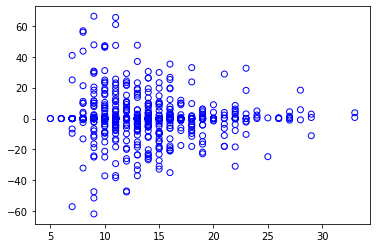

In [197]:
print('BERT - All-inclusive:')
plt.scatter(src_lens, [bleus[i][1].score - bleus[i][3].score for i in range(1000)], facecolors='none', edgecolors='b')
# plt.scatter(src_lens, [ for i in range(1000)], facecolors='none', edgecolors='r')
plt.draw()

LXMERT - All-inclusive:


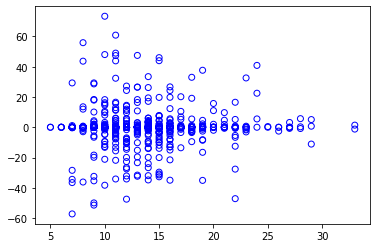

In [193]:
print('LXMERT - All-inclusive:')
plt.scatter(src_lens, [bleus[i][2].score - bleus[i][3].score for i in range(1000)], facecolors='none', edgecolors='b')
# plt.scatter(src_lens, [ for i in range(1000)], facecolors='none', edgecolors='r')
plt.draw()

### Predict by POS

In [298]:
for (m1, m2), winloss in winloss_by_rank.items():
    print(f'{models[m1]} - {models[m2]}:')
    best_score = -1
    best_pos_type = None
    for pos_type in pos_types:
        pred_win = [(pos_type in pos_seq[m1] and pos_type not in pos_seq[m2]) for pos_seq in pos_seqs]
        pred_loss = [(pos_type not in pos_seq[m1] and pos_type in pos_seq[m2]) for pos_seq in pos_seqs]
        score = compute_f1([pred_win, pred_loss], winloss)
        print(f'{pos_type:7}: {"{:.3f}  {:.3f}  {:.3f}".format(*score)}')
        if pos_type not in ('$(', '$,', '$.') and score[-1] > best_score:
            best_score = score[-1]
            best_pos_type = pos_type
    print(f'BEST: {best_pos_type}')

bert - lxmert:
$(     : 0.000  0.000  0.000
$,     : 0.108  0.148  0.131
$.     : 0.000  0.000  0.000
ADJA   : 0.086  0.043  0.072
ADV    : 0.075  0.127  0.099
APZR   : 0.000  0.000  0.000
ART    : 0.000  0.045  0.018
CARD   : 0.015  0.023  0.018
FM     : 0.099  0.020  0.073
KOKOM  : 0.000  0.000  0.000
KON    : 0.095  0.022  0.069
KOUI   : 0.000  0.023  0.009
KOUS   : 0.068  0.043  0.060
N      : 0.015  0.000  0.009
PREP   : 0.082  0.040  0.067
PRO    : 0.163  0.185  0.181
PROAV  : 0.029  0.000  0.018
PTKA   : 0.000  0.000  0.000
PTKNEG : 0.015  0.000  0.009
PTKVZ  : 0.038  0.094  0.064
PTKZU  : 0.054  0.043  0.051
PWAV   : 0.015  0.000  0.009
TRUNC  : 0.029  0.044  0.036
V      : 0.043  0.047  0.044
BEST: PRO
bert - all-inclusive:
$(     : 0.000  0.000  0.000
$,     : 0.088  0.211  0.139
$.     : 0.000  0.000  0.000
ADJA   : 0.075  0.024  0.059
ADV    : 0.120  0.063  0.104
APZR   : 0.015  0.000  0.010
ART    : 0.015  0.028  0.019
CARD   : 0.000  0.000  0.000
FM     : 0.089  0.044  0.

In [299]:
for (m1, m2), winloss in winloss_by_rank.items():
    print(f'{models[m1]} - {models[m2]}:')
    best_score = -1
    best_pos_type = None
    for pos_type in stts_pos_types:
        pred_win = [(pos_type in pos_seq[m1] and pos_type not in pos_seq[m2]) for pos_seq in stts_pos_seqs]
        pred_loss = [(pos_type not in pos_seq[m1] and pos_type in pos_seq[m2]) for pos_seq in stts_pos_seqs]
        score = compute_f1([pred_win, pred_loss], winloss)
        print(f'{pos_type:7}: {"{:.3f}  {:.3f}  {:.3f}".format(*score)}')
        if pos_type not in ('$(', '$,', '$.') and score[-1] > best_score:
            best_score = score[-1]
            best_pos_type = pos_type
    print(f'BEST: {best_pos_type}')

bert - lxmert:
$(     : 0.000  0.000  0.000
$,     : 0.108  0.148  0.131
$.     : 0.000  0.000  0.000
ADJA   : 0.086  0.043  0.072
ADJD   : 0.065  0.060  0.065
ADV    : 0.054  0.137  0.090
APPR   : 0.095  0.057  0.083
APPRART: 0.066  0.044  0.059
APZR   : 0.000  0.000  0.000
ART    : 0.014  0.045  0.027
CARD   : 0.015  0.023  0.018
FM     : 0.099  0.020  0.073
KOKOM  : 0.000  0.000  0.000
KON    : 0.095  0.022  0.069
KOUI   : 0.000  0.023  0.009
KOUS   : 0.068  0.043  0.060
NE     : 0.063  0.131  0.094
NN     : 0.015  0.000  0.009
PDAT   : 0.000  0.000  0.000
PDS    : 0.014  0.045  0.027
PIAT   : 0.043  0.000  0.027
PIDAT  : 0.000  0.047  0.018
PIS    : 0.056  0.043  0.051
PPER   : 0.042  0.021  0.035
PPOSAT : 0.028  0.043  0.035
PRELS  : 0.115  0.104  0.113
PRF    : 0.096  0.039  0.074
PROAV  : 0.029  0.000  0.018
PTKA   : 0.000  0.000  0.000
PTKNEG : 0.015  0.000  0.009
PTKVZ  : 0.038  0.094  0.064
PTKZU  : 0.054  0.043  0.051
PWAV   : 0.015  0.000  0.009
PWS    : 0.000  0.000  0.000

## Reversal samples

In [23]:
def filter_and_stat(m1='bert', m2='lxmert'):
    target_df = df[(df[f'rank_{m1}'] < df[f'rank_{m2}']) & (df[f'bleu_{m1}'] < df[f'bleu_{m2}'])]

    # print(f'{len(target_df)} samples')

    stats = {
        p: [target_df[f'{p}_{m1}'].mean(), target_df[f'{p}_{m2}'].mean(), target_df[f'{p}_{m2}'].mean() / target_df[f'{p}_{m1}'].mean()]
        for p in ['bleu', 'bleu1', 'bleu2', 'bleu3', 'bleu4']
    }
    stats['n_samples'] = len(target_df)
    pprint(stats)
    
    return target_df, stats

In [284]:
def plot_bleu_stat(target_df, m1, m2, ax_bleu, ax_bp):
    ax_bleu = fig.add_subplot(121)
    ax_bleu.plot([0,100],[0,100], color='gray')
    ax_bleu.scatter(target_df[f'bleu_{m1}'], target_df[f'bleu_{m2}'])
    for n in range(1,5):
        ax_bleu.scatter(target_df[f'bleu{n}_{m1}'], target_df[f'bleu{n}_{m2}'])
    ax_bleu.legend(['BLEU', 'BLEU1', 'BLEU2', 'BLEU3', 'BLEU4'])
    ax_bleu.set_xlabel(m1)
    ax_bleu.set_ylabel(m2)

    ax_bp = fig.add_subplot(122)
    ax_bp.plot([0,1],[0,1], color='gray')
    ax_bp.scatter(target_df[f'bleu-bp_{m1}'], target_df[f'bleu-bp_{m2}'])
    ax_bp.legend(['BP'])
    ax_bp.set_xlabel(m1)
    ax_bp.set_ylabel(m2)

## BERT - LXMERT

In [ ]:
fig = figure(1

{'bleu': [23.41885152685246, 33.45680803439872, 1.4286271893408848],
 'bleu1': [63.20481470494699, 71.08402587531444, 1.1246615658498362],
 'bleu2': [35.74246405768145, 46.17144646748575, 1.291781293896636],
 'bleu3': [21.382128407990475, 32.109860361635214, 1.5017148783764576],
 'bleu4': [13.972101955314296, 22.79670131425485, 1.6315871002919582],
 'n_samples': 29}


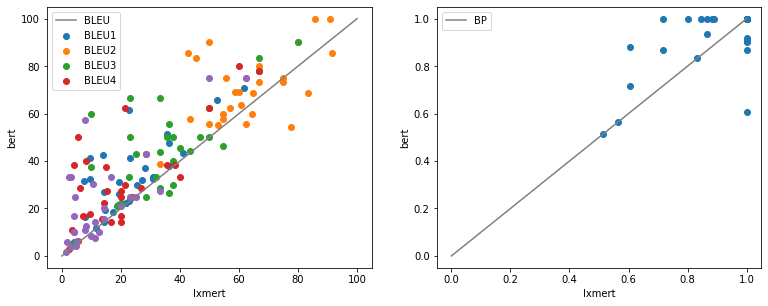

In [25]:
m1 = 'lxmert'
m2 = 'bert'
df_lxmert_catchup_bert, stat_lxmert_catchup_bert = filter_and_stat(m1=m1, m2=m2)
show_bleu_stat(df_lxmert_catchup_bert, m1=m1, m2=m2)

{'bleu': [23.055336253695362, 33.34112986941252, 1.4461350510152948],
 'bleu1': [61.24989949916191, 66.71557593868394, 1.089235680127064],
 'bleu2': [32.85138537950189, 43.87351635187612, 1.335514951501913],
 'bleu3': [19.651881268223455, 30.66516603048321, 1.5604188531338183],
 'bleu4': [11.81892006850938, 21.57209546023481, 1.8252171378764146],
 'n_samples': 49}


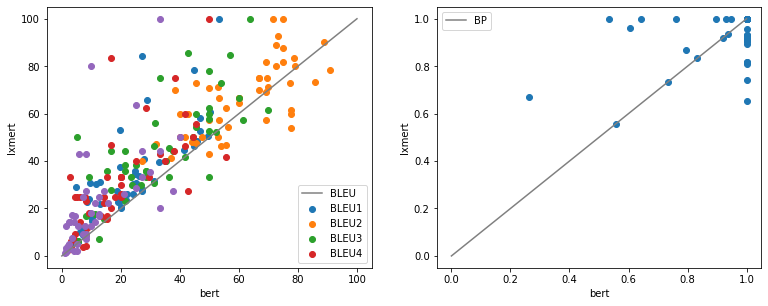

In [26]:
m1 = 'bert'
m2 = 'lxmert'
df_lxmert_catchup_bert, stat_lxmert_catchup_bert = filter_and_stat(m1=m1, m2=m2)
show_bleu_stat(df_lxmert_catchup_bert, m1=m1, m2=m2)

In [220]:
df_lxmert_catchup_bert['hyp_bert']

1      ein einsamer terrier rennt vor einem weißen za...
43      ein kind schwingt im wald die füße in die luft .
51     ein skater führt einen salto vor , während er ...
57       zwei schwarz gekleidete männer in einer stadt .
62     eine menschenmenge versammelt sich in einem öf...
82     eine junge frau malt ein bild von einer frau a...
131    drei braune hunde springen zu der frau in blau...
132     ein junge hängt von einem taxi aus dem fenster .
143    ein mann mit einem grünen schutzhelm und gelbe...
150    eine person , die eine jeansjacke trägt , lieg...
182    der junge , der ein schwarzes hemd und blaue j...
212        ein junger mann spielt in der küche gitarre .
233    ein hund mit einem schwarzen halsband rollt du...
245    drei junge erwachsene unterhalten sich in eine...
251    ein kahlköpfiger mann bringt sehr aufgeregt , ...
289    ein mann malt auf einem wagen ein kunstwerk , ...
294    ein mann in einem kampfsportkleidung befindet ...
310    ein kleines mädchen schi